In [1]:
import argparse
import os
import numpy as np
import math

import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torchvision.utils import save_image, make_grid

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable
from tqdm import tqdm_notebook

import torch.nn as nn
import torch.nn.functional as F
import torch
import shutil
import time

os.makedirs('images_ensemble_mnist10_classifier_small', exist_ok=True)
shutil.rmtree('images_ensemble_mnist10_classifier_small')
os.makedirs('images_ensemble_mnist10_classifier_small', exist_ok=True)


In [2]:
# o código inicialmente foi implementado com argument parser. 
#Modifiquei para que os argumentos fossem definidos como variáveis no próprio código 

'''parser = argparse.ArgumentParser()
parser.add_argument('--n_epochs', type=int, default=500, help='number of epochs of training')
parser.add_argument('--batch_size', type=int, default=100, help='size of the batches')
parser.add_argument('--lr', type=float, default=0.0002, help='adam: learning rate')
parser.add_argument('--b1', type=float, default=0.5, help='adam: decay of first order momentum of gradient')
parser.add_argument('--b2', type=float, default=0.999, help='adam: decay of first order momentum of gradient')
parser.add_argument('--n_cpu', type=int, default=8, help='number of cpu threads to use during batch generation')
parser.add_argument('--latent_dim', type=int, default=100, help='dimensionality of the latent space')
parser.add_argument('--img_size', type=int, default=28, help='size of each image dimension')
parser.add_argument('--channels', type=int, default=1, help='number of image channels')
parser.add_argument('--sample_interval', type=int, default=400, help='interval betwen image samples')
parser.add_argument('--n_paths_G', type=int, default=10, help='number of paths of generator')
parser.add_argument('--classifier_para', type=float, default=1.0, help='regularization parameter for classifier')

opt = parser.parse_args()
print(opt)
'''
print('')

In [3]:
class arg_parser_subst():
    def __init__(self):
        self.n_epochs = 500 
        self.batch_size = 100
        self.lr = 0.0002 
        self.b1 = 0.5 
        self.b2 = 0.999 
        self.n_cpu = 12 
        self.latent_dim = 100 
        self.img_size = 28
        self.channels = 1
        self.sample_interval = 400 
        self.n_paths_G = 10 #número de geradores 
        self.classifier_para = 1.0 #constante de regularizacao aplicada à perda de classificacao
        

In [4]:
opt = arg_parser_subst()

In [5]:


img_shape = (opt.channels, opt.img_size, opt.img_size)

cuda = True if torch.cuda.is_available() else False


#Construção do gerador
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        def block(in_feat, out_feat, normalize=True):
            layers = [nn.Linear(in_feat, out_feat)]
            if normalize:
                layers.append(nn.BatchNorm1d(out_feat, 0.8))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers
        
        #ModuleList() é uma forma de armazenar várias arquiteturas independentes  
        modules = nn.ModuleList()
        
        #Adicionamos aqui cada gerador na ModuleList() usando a definição Sequential() 
        for _ in range(opt.n_paths_G):
            modules.append(nn.Sequential(
            *block(opt.latent_dim, 128),
            *block(128, 512),
            nn.Linear(512, int(np.prod(img_shape))),
            nn.Tanh()
            ))
            
        #atributo da classe para armazenar a lista com os geradores
        self.paths = modules

    #para obter as saídas dos geradores no resto do código, cada módulo (i.e, gerador)...
    #...é acionado isoladamente, através do forward que já vem na arquitetura Sequential()
    
    #o método forward (abaixo) da classe Generator acaba nem sendo usado no código. 
    def forward(self, z):
        img = []
        for path in self.paths:
            img.append(path(z).view(img.size(0), *img_shape))
        img = torch.cat(img, dim=0)
        return img

#Construção do discriminador/classificador
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        #definição das camadas da "arquitetura compartilhada" entre disc. e class.
        self.fc1 = nn.Linear(int(np.prod(img_shape)), 512)
        self.lr1 = nn.LeakyReLU(0.2, inplace=True)
        self.fc2 = nn.Linear(512, 256)
        self.lr2 = nn.LeakyReLU(0.2, inplace=True)
        
        #módulos extras independentes com as camadas finais 
        modules = nn.ModuleList()
        
        #discriminador 
        modules.append(nn.Sequential(
            nn.Linear(256, 1),
            nn.Sigmoid(),
                ))
        #classificador 
        modules.append(nn.Sequential(
            nn.Linear(256, opt.n_paths_G),
                ))
        self.paths = modules
    
    #nesse forward são definidas as conexões internas da parte compartilhada e dos módulos
    def forward(self, img):
        #conexões das camadas da arquitetura compartilhada
        img_flat = img.view(img.size(0), -1)
        img_flat = self.lr2(self.fc2(self.lr1(self.fc1(img_flat))))
        
        #aqui os módulos independentes são acoplados na saída da arquitetura compartilhada:
        
        #discriminador
        validity = self.paths[0](img_flat)
        
        #classificador
        classifier = F.log_softmax(self.paths[1](img_flat), dim=1)
        
        return validity, classifier

# Loss function
adversarial_loss = torch.nn.BCELoss()

# Initialize generator and discriminator
generator = Generator()
discriminator = Discriminator()

if cuda:
    generator.cuda()
    discriminator.cuda()
    adversarial_loss.cuda()


In [6]:
# Configure data loader
os.makedirs('data/mnist', exist_ok=True)
dataloader = torch.utils.data.DataLoader(
    datasets.MNIST('data/mnist', train=True, download=True,
                   transform=transforms.Compose([
                       transforms.ToTensor(),
                       transforms.Normalize([.5],[.5])
                   ])),
    batch_size=opt.batch_size, shuffle=True)


# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=opt.lr, betas=(opt.b1, opt.b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=opt.lr, betas=(opt.b1, opt.b2))

Tensor = torch.cuda.FloatTensor if cuda else torch.FloatTensor


In [7]:

%matplotlib inline
def show(img):
    npimg = img.detach().numpy()
    plt.figure(figsize = (20,opt.n_paths_G))
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')



In [8]:
from torchsummary import summary

In [9]:
#sumário de um único gerador. Infelizmente a visualiz. não é mt boa 
summary(generator.paths[0], (100, ))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                  [-1, 128]          12,928
       BatchNorm1d-2                  [-1, 128]             256
         LeakyReLU-3                  [-1, 128]               0
            Linear-4                  [-1, 512]          66,048
       BatchNorm1d-5                  [-1, 512]           1,024
         LeakyReLU-6                  [-1, 512]               0
            Linear-7                  [-1, 784]         402,192
              Tanh-8                  [-1, 784]               0
Total params: 482,448
Trainable params: 482,448
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 0.03
Params size (MB): 1.84
Estimated Total Size (MB): 1.87
----------------------------------------------------------------


In [10]:
#sumário do discriminador
summary(discriminator, (1, 28, 28))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                  [-1, 512]         401,920
         LeakyReLU-2                  [-1, 512]               0
            Linear-3                  [-1, 256]         131,328
         LeakyReLU-4                  [-1, 256]               0
            Linear-5                    [-1, 1]             257
           Sigmoid-6                    [-1, 1]               0
            Linear-7                   [-1, 10]           2,570
Total params: 536,075
Trainable params: 536,075
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 0.01
Params size (MB): 2.04
Estimated Total Size (MB): 2.06
----------------------------------------------------------------


/home/danielprado/scratch-danielprado/miniconda3/envs/portinari_pytorch_1.3/lib/python3.7/site-packages/ipykernel_launcher.py:10: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  # Remove the CWD from sys.path while we load stuff.


[Epoch 0/500] [Batch 599/600] [D loss: 5.752742] [G loss: 8.691392] [C loss 1: 1.025277] [C loss 2: 1.030477] 	 Time Interv: 20.027222


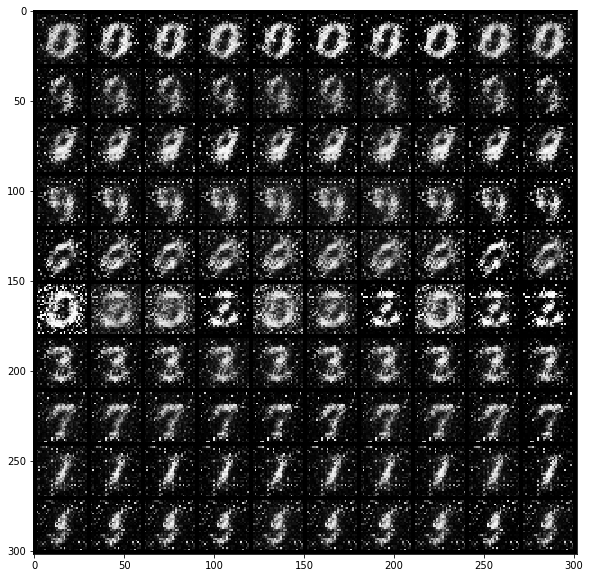

[Epoch 2/500] [Batch 599/600] [D loss: 6.211557] [G loss: 8.700413] [C loss 1: 0.034948] [C loss 2: 0.036078] 	 Time Interv: 20.084182


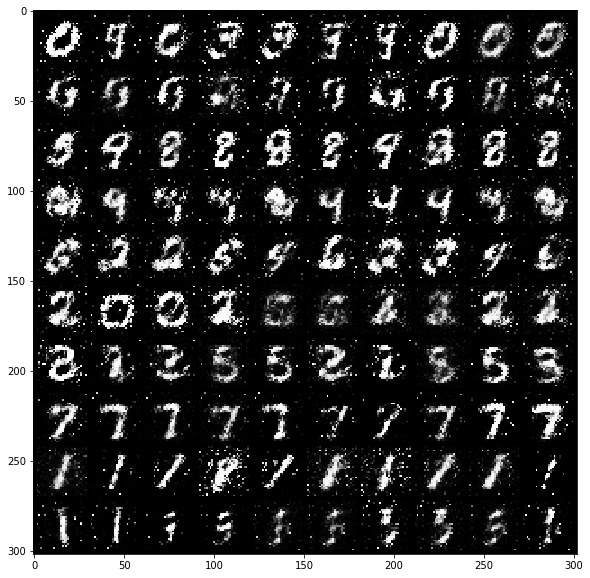

[Epoch 4/500] [Batch 599/600] [D loss: 6.233758] [G loss: 8.606451] [C loss 1: 0.029230] [C loss 2: 0.028502] 	 Time Interv: 20.066227


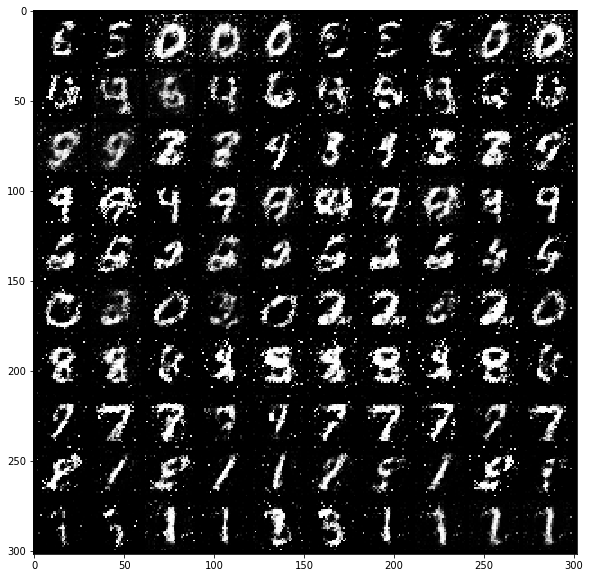

[Epoch 6/500] [Batch 599/600] [D loss: 6.283039] [G loss: 8.579649] [C loss 1: 0.028142] [C loss 2: 0.026607] 	 Time Interv: 20.066373


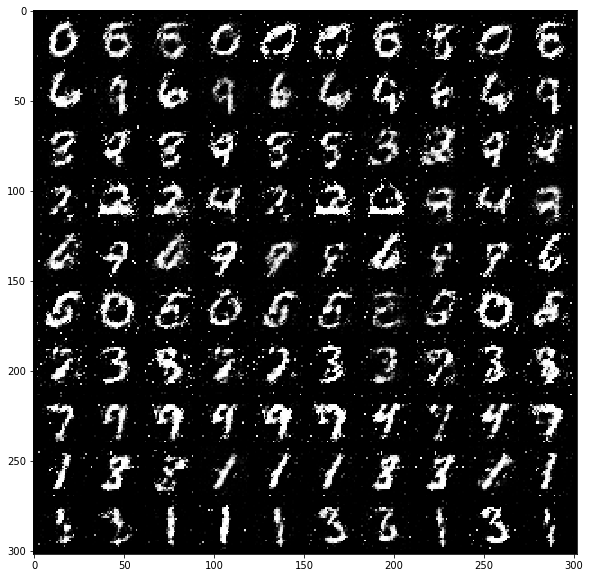

[Epoch 8/500] [Batch 599/600] [D loss: 6.418586] [G loss: 8.425146] [C loss 1: 0.024467] [C loss 2: 0.021847] 	 Time Interv: 20.048767


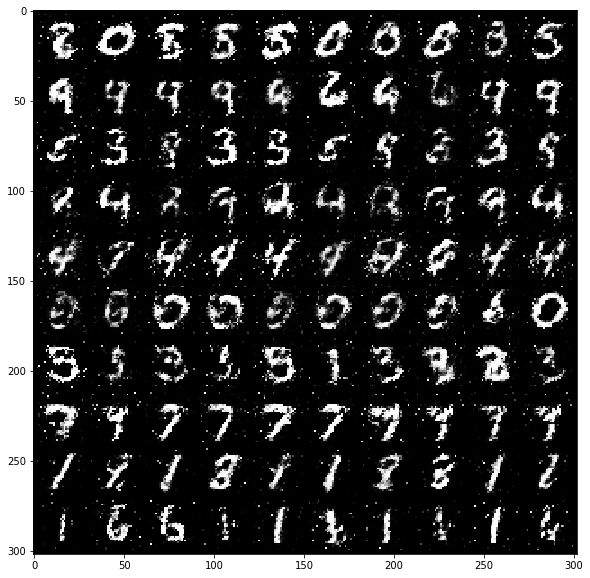

[Epoch 10/500] [Batch 599/600] [D loss: 6.414811] [G loss: 8.343324] [C loss 1: 0.017061] [C loss 2: 0.014695] 	 Time Interv: 20.024315


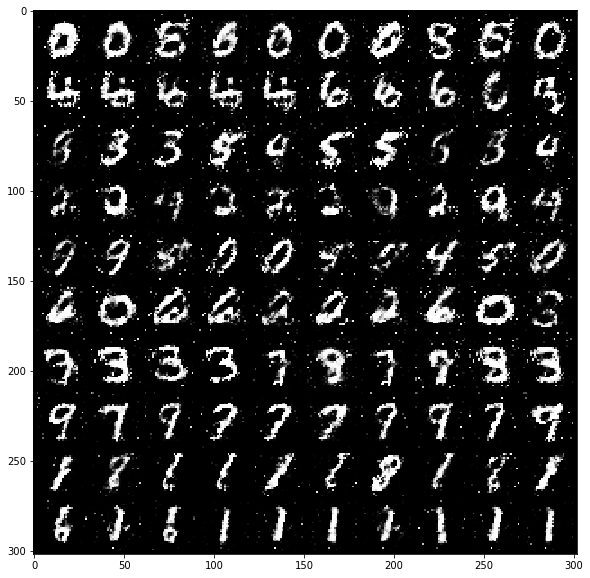

[Epoch 12/500] [Batch 599/600] [D loss: 6.437999] [G loss: 8.327787] [C loss 1: 0.019800] [C loss 2: 0.015851] 	 Time Interv: 20.058303


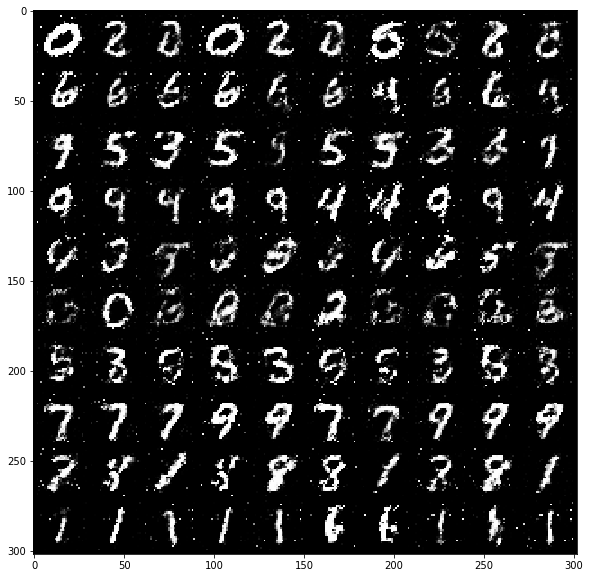

[Epoch 14/500] [Batch 599/600] [D loss: 6.458654] [G loss: 8.350996] [C loss 1: 0.015322] [C loss 2: 0.011903] 	 Time Interv: 20.083602


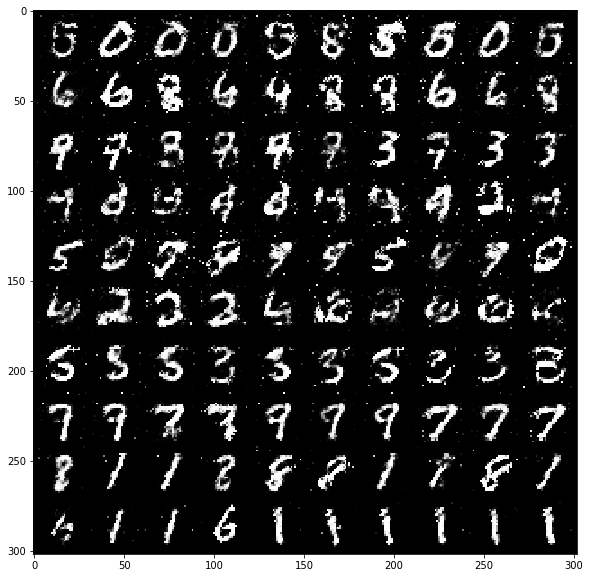

[Epoch 16/500] [Batch 599/600] [D loss: 6.468928] [G loss: 8.302565] [C loss 1: 0.011255] [C loss 2: 0.008170] 	 Time Interv: 20.075433


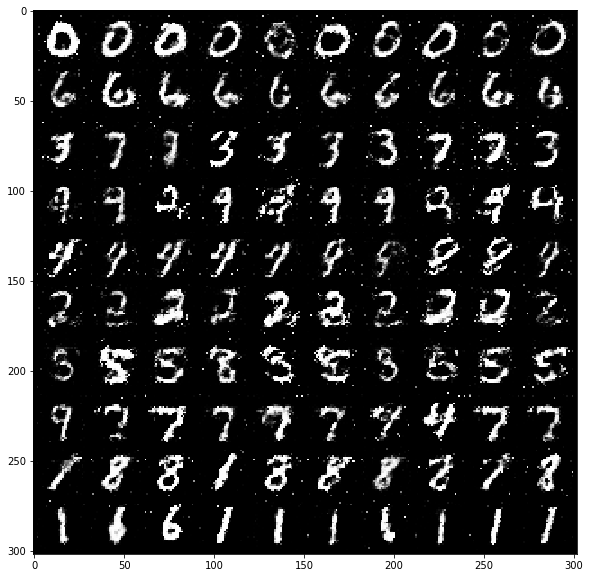

[Epoch 18/500] [Batch 599/600] [D loss: 6.462391] [G loss: 8.344937] [C loss 1: 0.012301] [C loss 2: 0.008188] 	 Time Interv: 20.165367


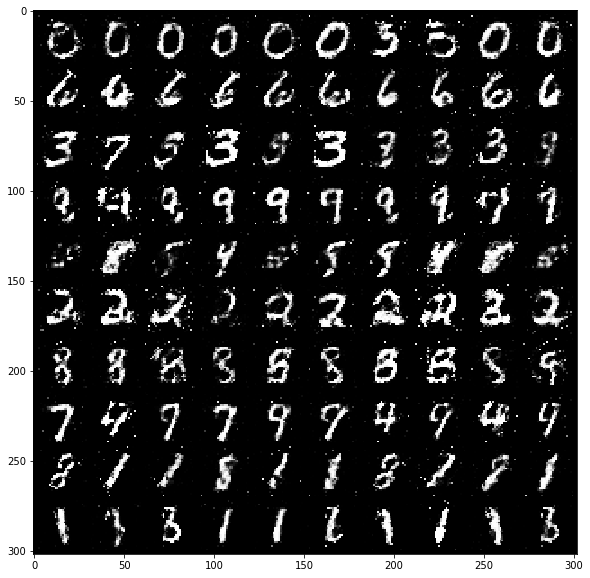

[Epoch 20/500] [Batch 599/600] [D loss: 6.478069] [G loss: 8.361129] [C loss 1: 0.011300] [C loss 2: 0.007260] 	 Time Interv: 20.161053


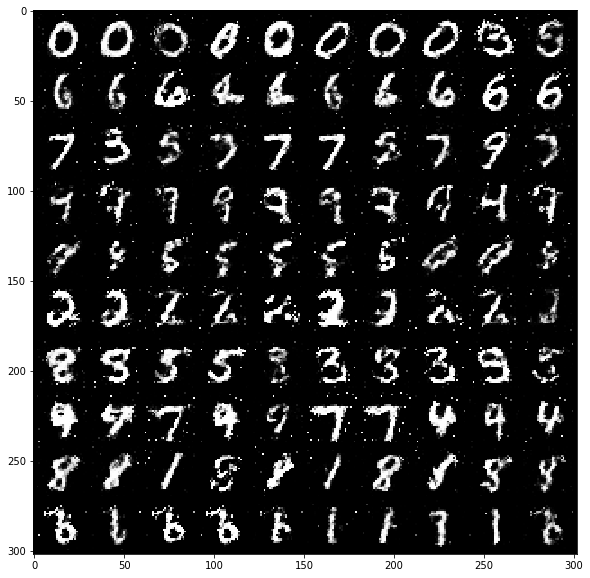

[Epoch 22/500] [Batch 599/600] [D loss: 6.510271] [G loss: 8.299497] [C loss 1: 0.010132] [C loss 2: 0.006536] 	 Time Interv: 20.137651


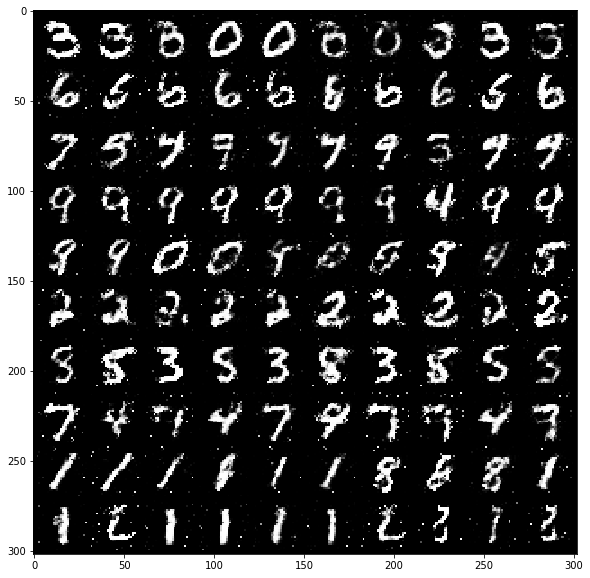

[Epoch 24/500] [Batch 599/600] [D loss: 6.483843] [G loss: 8.357362] [C loss 1: 0.010890] [C loss 2: 0.005842] 	 Time Interv: 20.484776


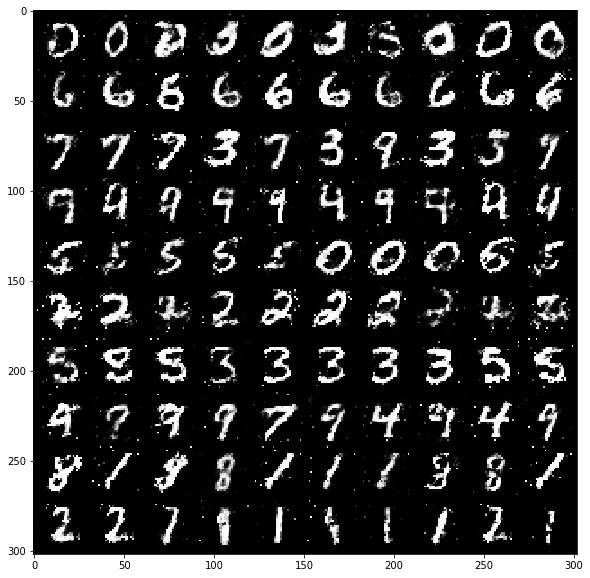

[Epoch 26/500] [Batch 599/600] [D loss: 6.512867] [G loss: 8.287882] [C loss 1: 0.010385] [C loss 2: 0.004835] 	 Time Interv: 20.484355


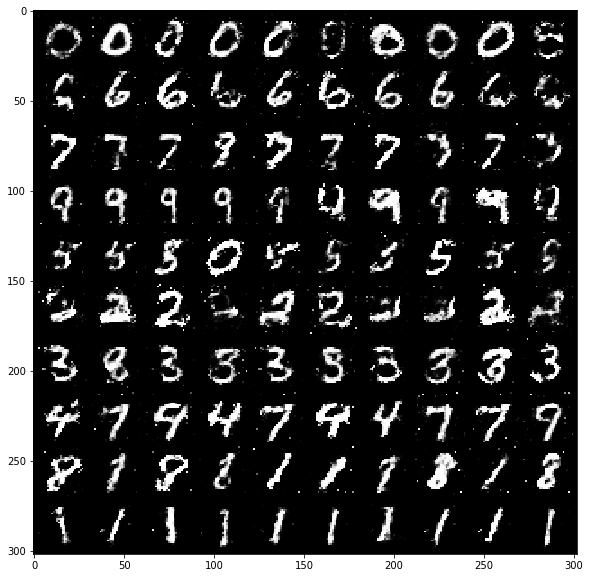

[Epoch 28/500] [Batch 599/600] [D loss: 6.477554] [G loss: 8.387738] [C loss 1: 0.010177] [C loss 2: 0.004782] 	 Time Interv: 20.522789


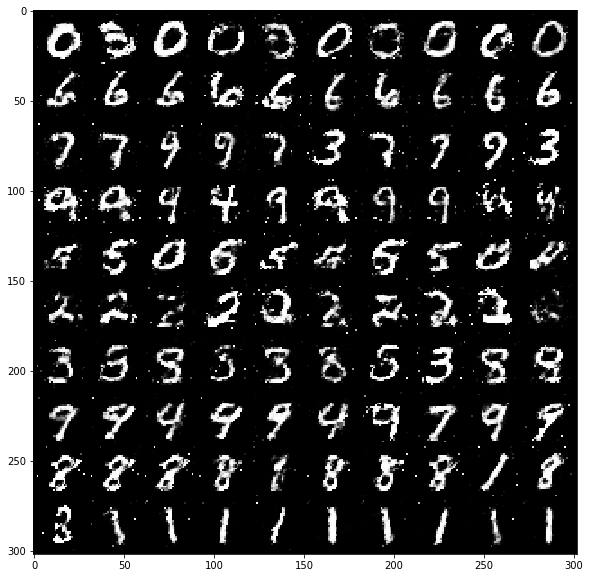

[Epoch 30/500] [Batch 599/600] [D loss: 6.457473] [G loss: 8.388689] [C loss 1: 0.010260] [C loss 2: 0.004408] 	 Time Interv: 20.568563


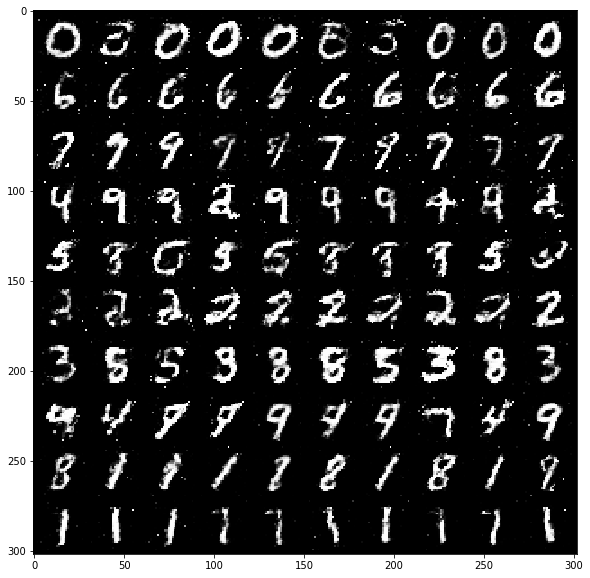

[Epoch 32/500] [Batch 599/600] [D loss: 6.489845] [G loss: 8.362011] [C loss 1: 0.010190] [C loss 2: 0.003672] 	 Time Interv: 20.607281


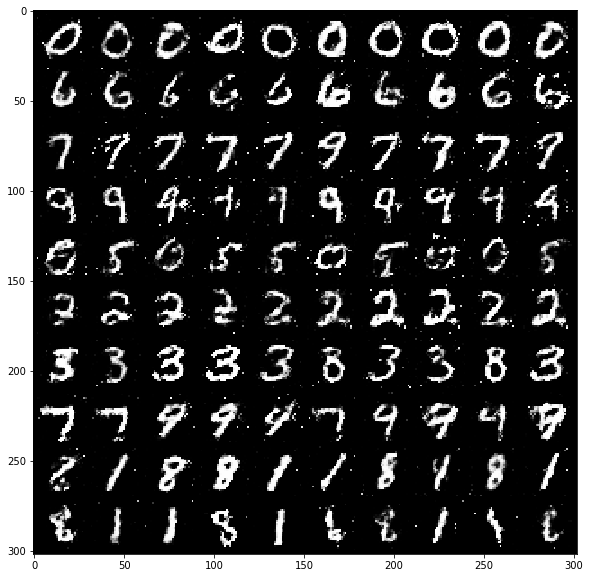

[Epoch 34/500] [Batch 599/600] [D loss: 6.493296] [G loss: 8.355718] [C loss 1: 0.008637] [C loss 2: 0.002735] 	 Time Interv: 20.080794


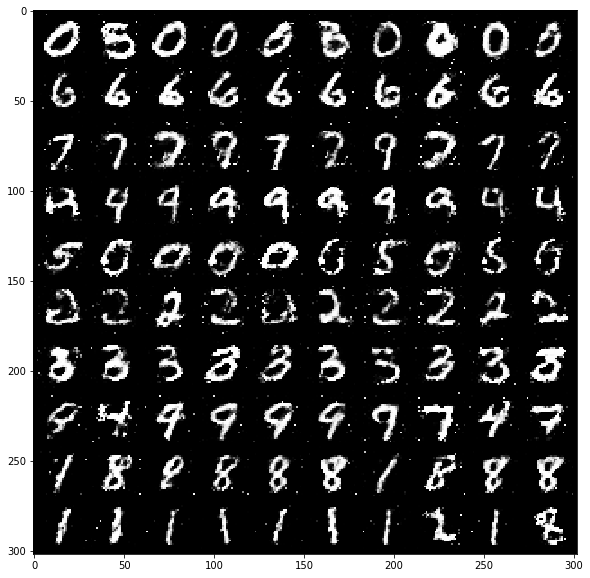

[Epoch 36/500] [Batch 599/600] [D loss: 6.458731] [G loss: 8.428608] [C loss 1: 0.010576] [C loss 2: 0.002844] 	 Time Interv: 20.046023


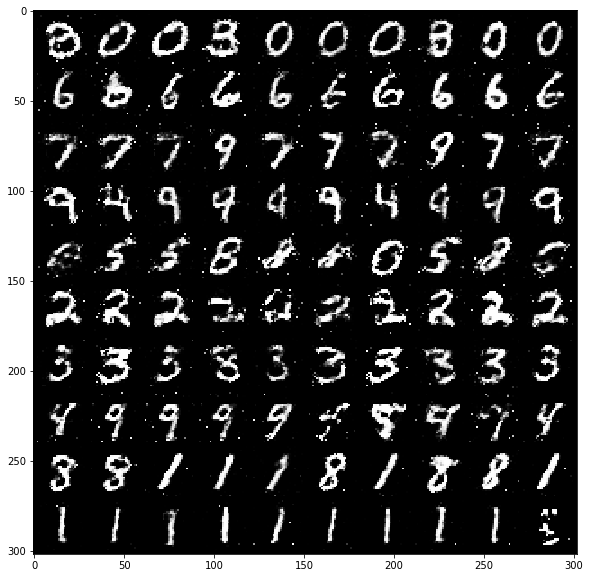

[Epoch 38/500] [Batch 599/600] [D loss: 6.416122] [G loss: 8.532546] [C loss 1: 0.009201] [C loss 2: 0.003129] 	 Time Interv: 20.039201


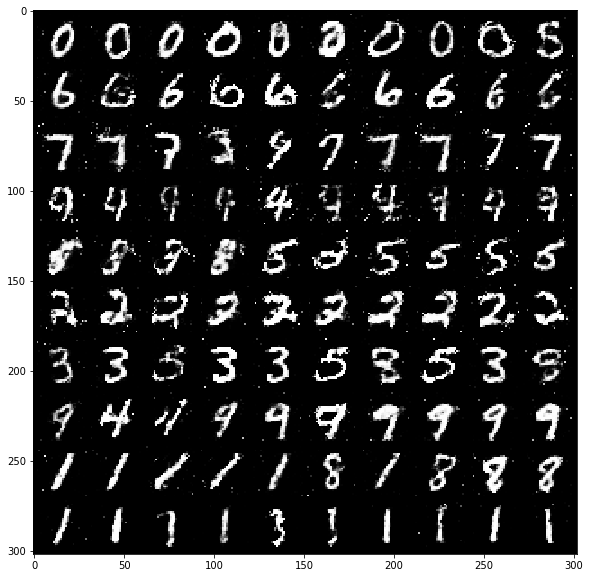

[Epoch 40/500] [Batch 599/600] [D loss: 6.436357] [G loss: 8.499413] [C loss 1: 0.013522] [C loss 2: 0.003534] 	 Time Interv: 20.058865


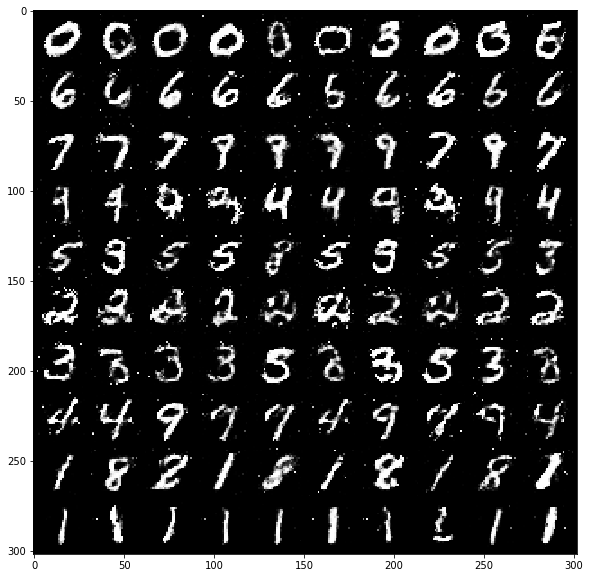

[Epoch 42/500] [Batch 599/600] [D loss: 6.417411] [G loss: 8.511158] [C loss 1: 0.012263] [C loss 2: 0.003326] 	 Time Interv: 20.052090


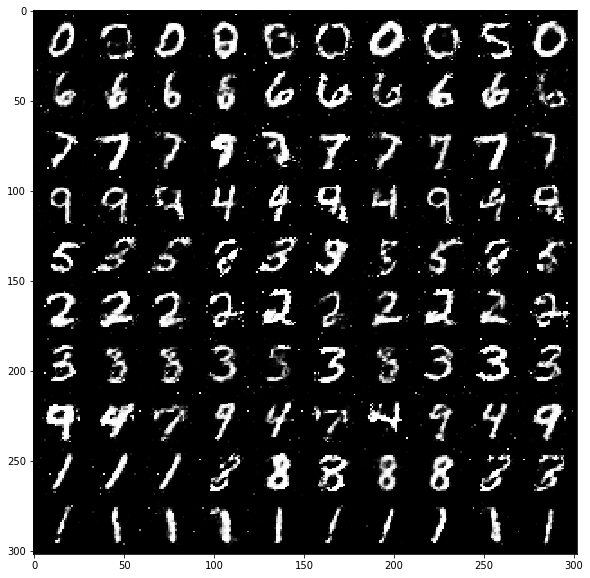

[Epoch 44/500] [Batch 599/600] [D loss: 6.425973] [G loss: 8.534080] [C loss 1: 0.011136] [C loss 2: 0.002308] 	 Time Interv: 20.025454


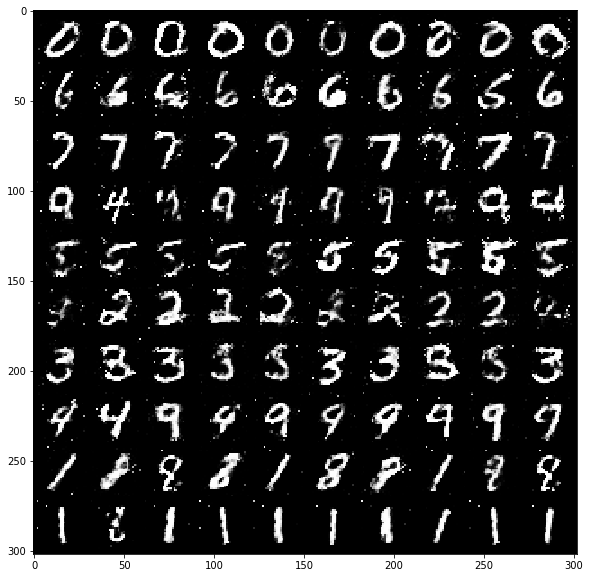

[Epoch 46/500] [Batch 599/600] [D loss: 6.446132] [G loss: 8.511146] [C loss 1: 0.012248] [C loss 2: 0.002603] 	 Time Interv: 20.040068


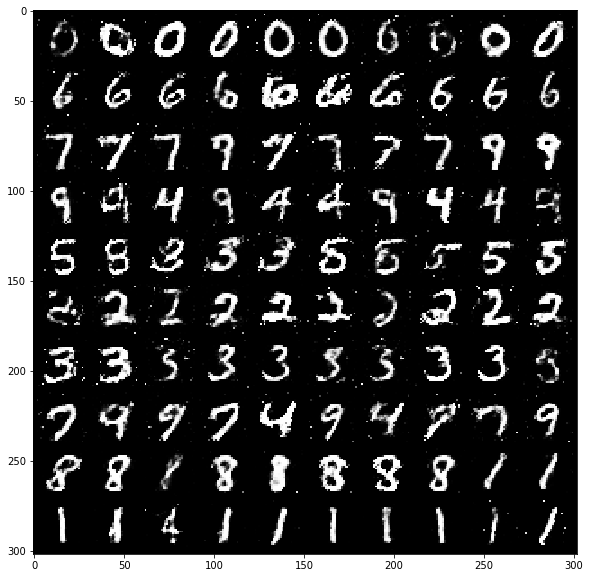

[Epoch 48/500] [Batch 599/600] [D loss: 6.417826] [G loss: 8.545789] [C loss 1: 0.012279] [C loss 2: 0.002692] 	 Time Interv: 20.089620


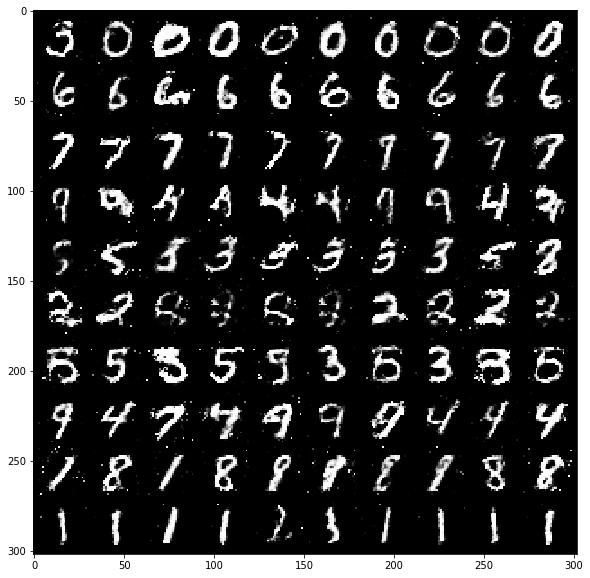

[Epoch 50/500] [Batch 599/600] [D loss: 6.475529] [G loss: 8.454252] [C loss 1: 0.009050] [C loss 2: 0.001915] 	 Time Interv: 20.051868


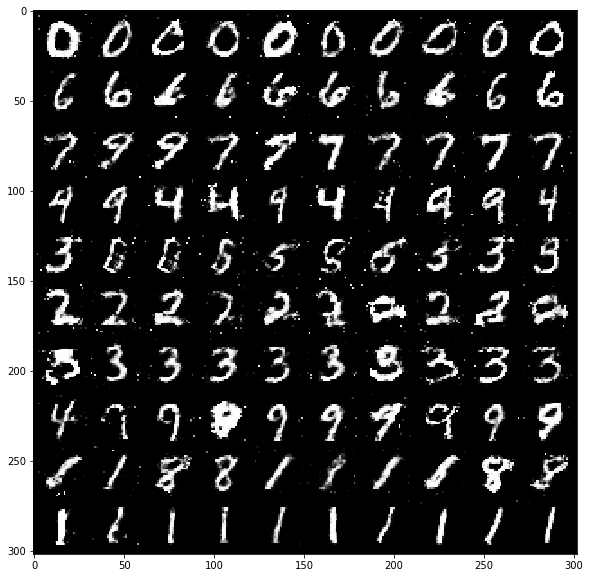

[Epoch 52/500] [Batch 599/600] [D loss: 6.440726] [G loss: 8.588691] [C loss 1: 0.011228] [C loss 2: 0.002058] 	 Time Interv: 20.078222


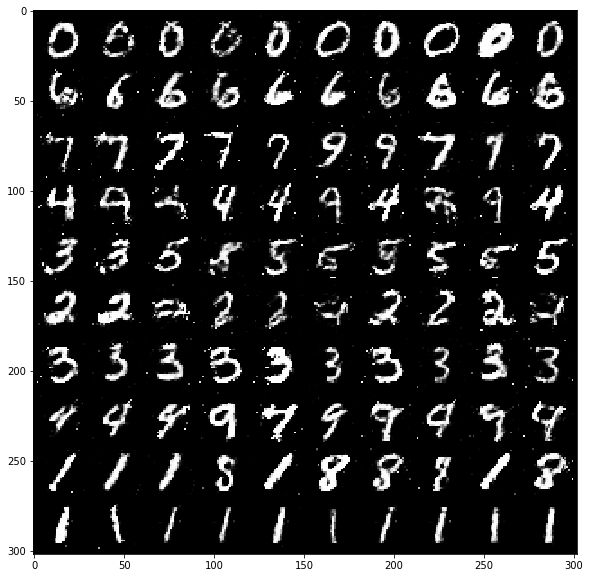

[Epoch 54/500] [Batch 599/600] [D loss: 6.434588] [G loss: 8.532392] [C loss 1: 0.011863] [C loss 2: 0.002597] 	 Time Interv: 20.302288


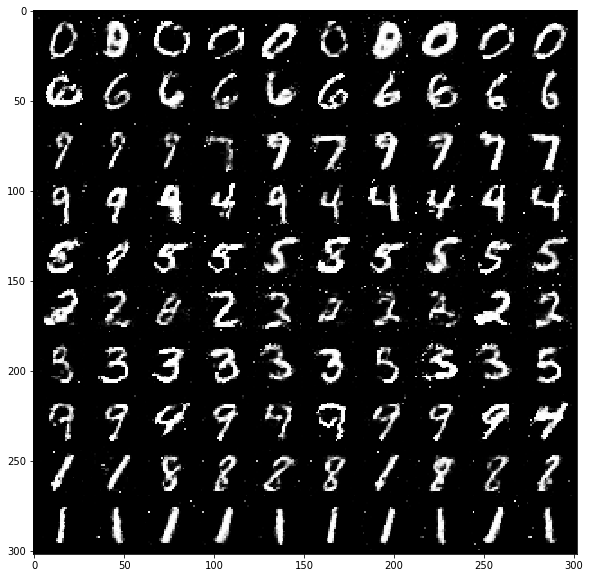

[Epoch 56/500] [Batch 599/600] [D loss: 6.383932] [G loss: 8.699209] [C loss 1: 0.013718] [C loss 2: 0.002071] 	 Time Interv: 20.116827


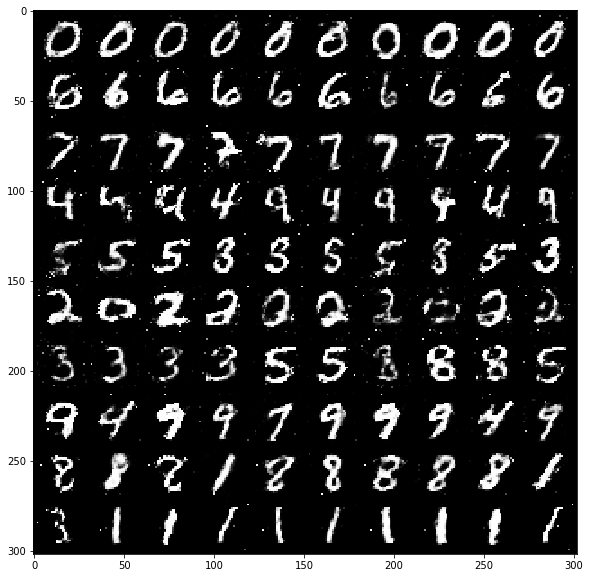

[Epoch 58/500] [Batch 599/600] [D loss: 6.378428] [G loss: 8.729692] [C loss 1: 0.014990] [C loss 2: 0.002029] 	 Time Interv: 20.092065


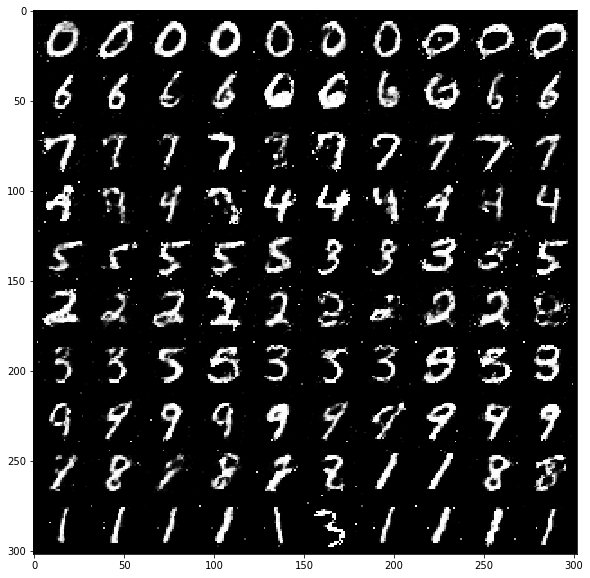

[Epoch 60/500] [Batch 599/600] [D loss: 6.381271] [G loss: 8.736991] [C loss 1: 0.013772] [C loss 2: 0.001964] 	 Time Interv: 20.128061


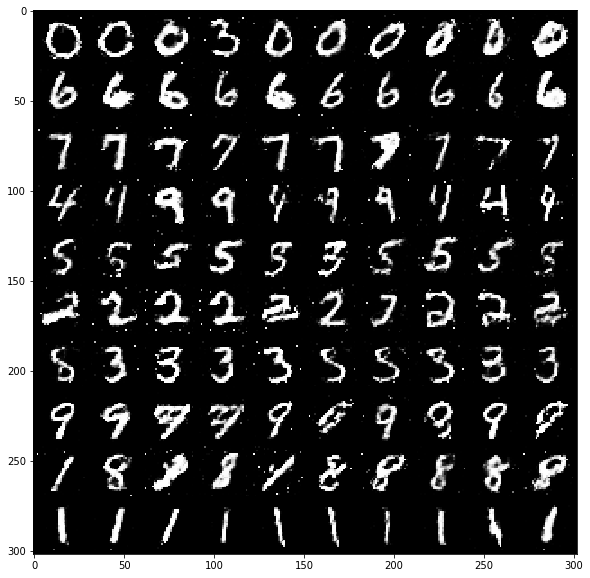

[Epoch 62/500] [Batch 599/600] [D loss: 6.359945] [G loss: 8.732691] [C loss 1: 0.013185] [C loss 2: 0.001676] 	 Time Interv: 20.316440


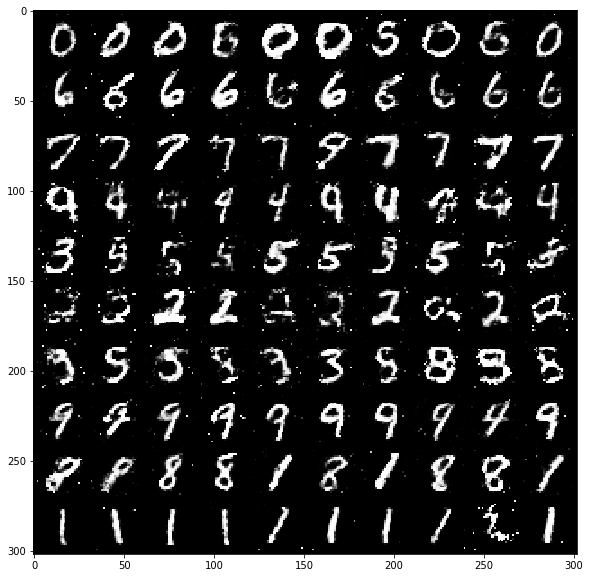

[Epoch 64/500] [Batch 599/600] [D loss: 6.409956] [G loss: 8.697768] [C loss 1: 0.010913] [C loss 2: 0.001393] 	 Time Interv: 20.404106


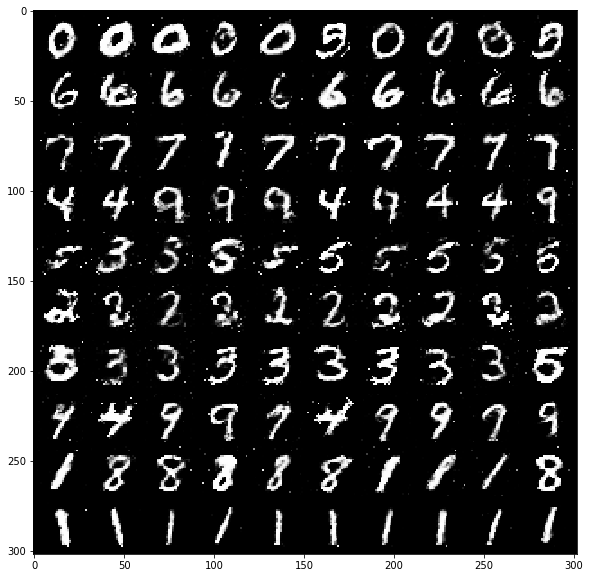

[Epoch 66/500] [Batch 599/600] [D loss: 6.382410] [G loss: 8.758056] [C loss 1: 0.011889] [C loss 2: 0.001574] 	 Time Interv: 24.496569


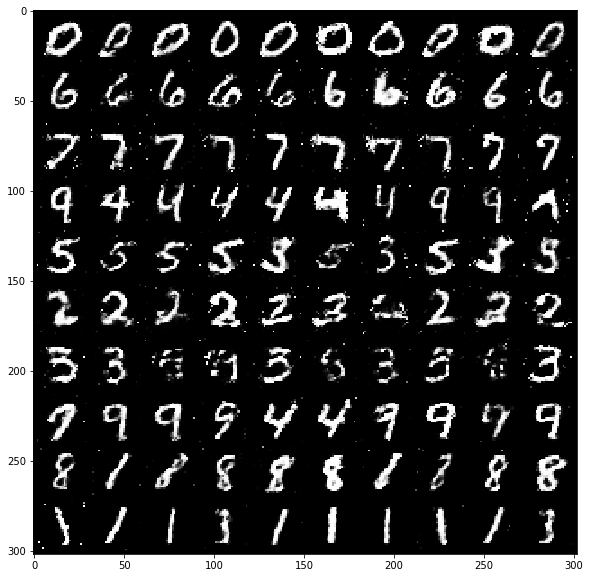

[Epoch 68/500] [Batch 599/600] [D loss: 6.414816] [G loss: 8.599970] [C loss 1: 0.013000] [C loss 2: 0.001625] 	 Time Interv: 25.063256


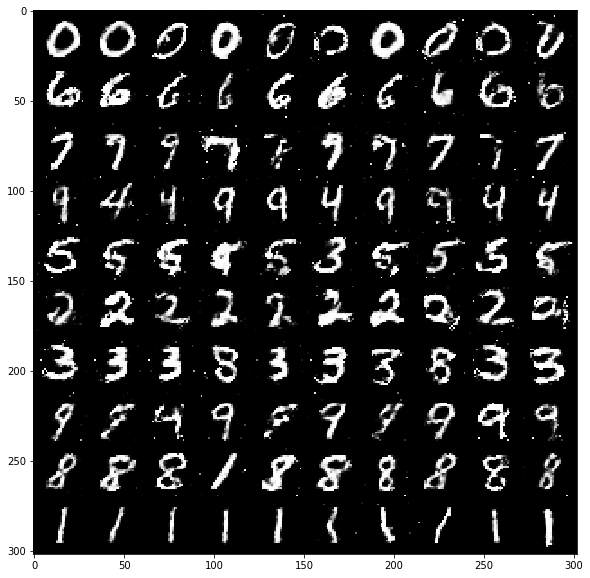

[Epoch 70/500] [Batch 599/600] [D loss: 6.392447] [G loss: 8.716572] [C loss 1: 0.011070] [C loss 2: 0.001561] 	 Time Interv: 25.165257


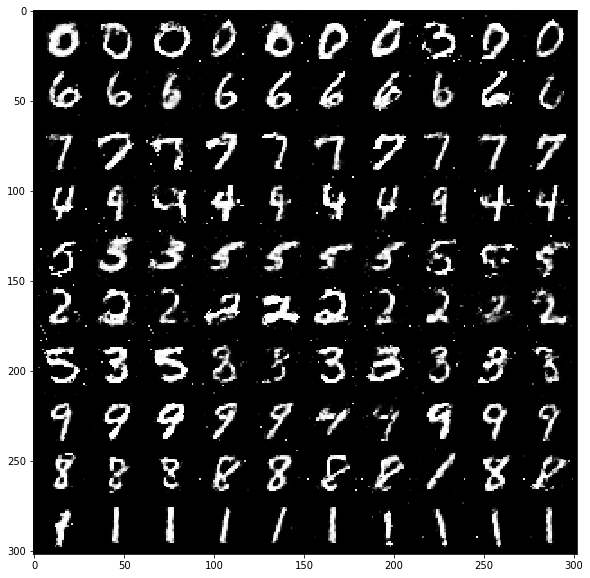

[Epoch 72/500] [Batch 599/600] [D loss: 6.431791] [G loss: 8.689936] [C loss 1: 0.012169] [C loss 2: 0.001252] 	 Time Interv: 29.158292


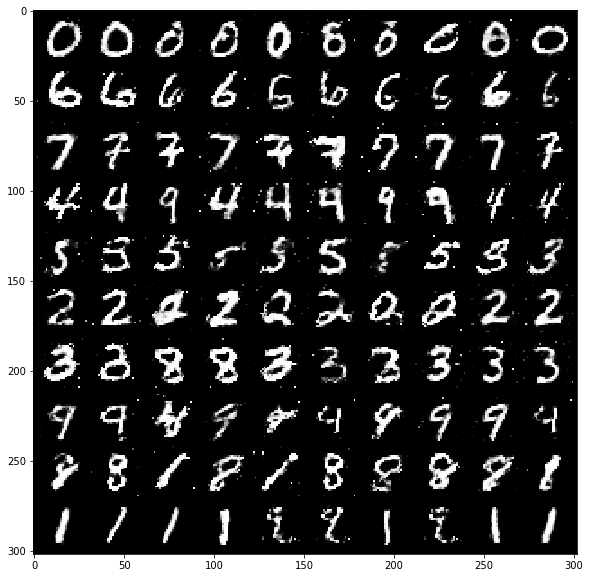

[Epoch 74/500] [Batch 599/600] [D loss: 6.402785] [G loss: 8.735908] [C loss 1: 0.011625] [C loss 2: 0.001590] 	 Time Interv: 29.799093


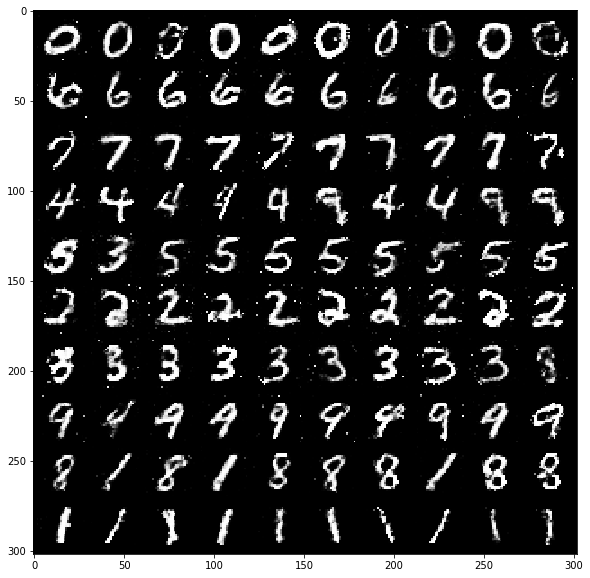

[Epoch 76/500] [Batch 599/600] [D loss: 6.399340] [G loss: 8.685439] [C loss 1: 0.014766] [C loss 2: 0.001657] 	 Time Interv: 28.896407


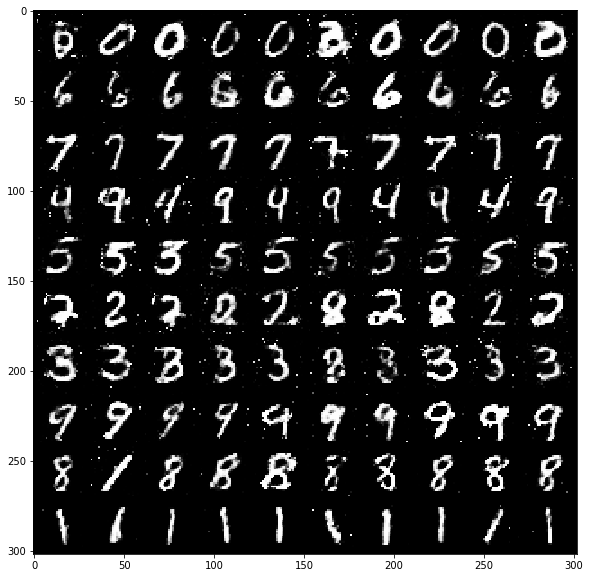

[Epoch 78/500] [Batch 599/600] [D loss: 6.385306] [G loss: 8.722408] [C loss 1: 0.014236] [C loss 2: 0.001073] 	 Time Interv: 29.115798


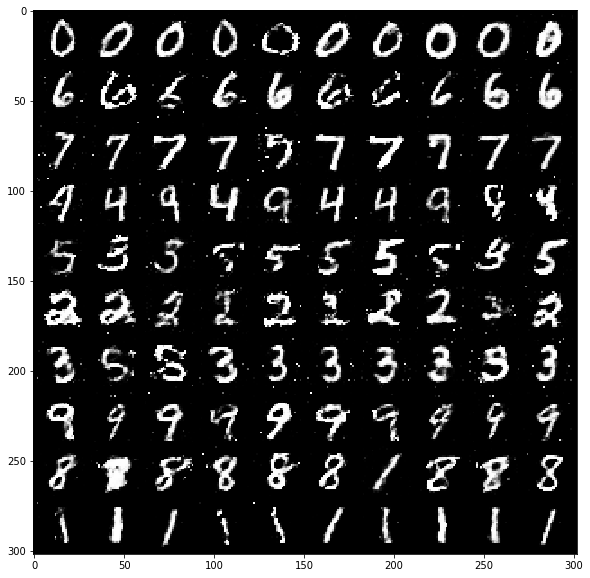

[Epoch 80/500] [Batch 599/600] [D loss: 6.415976] [G loss: 8.638123] [C loss 1: 0.013806] [C loss 2: 0.001427] 	 Time Interv: 29.470232


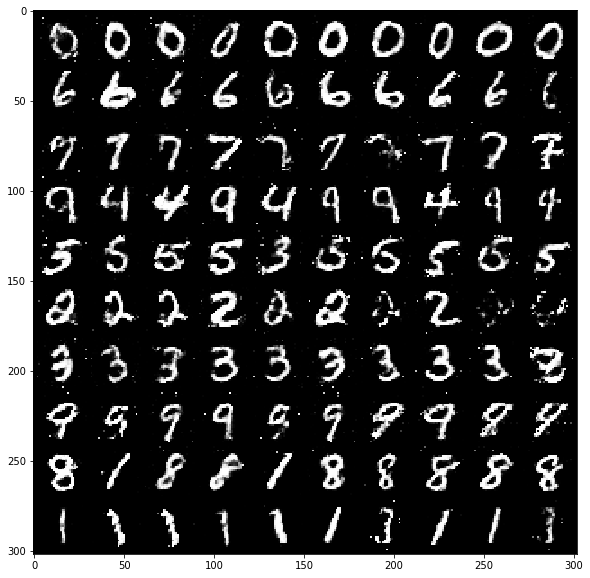

[Epoch 82/500] [Batch 599/600] [D loss: 6.370673] [G loss: 8.787979] [C loss 1: 0.016073] [C loss 2: 0.001441] 	 Time Interv: 29.296379


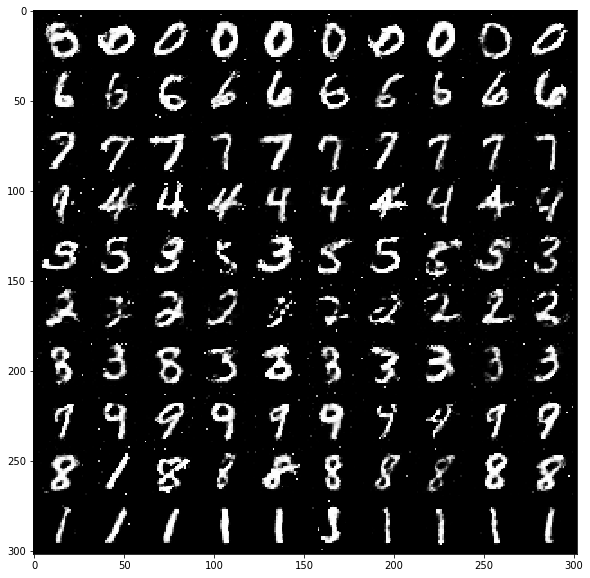

[Epoch 84/500] [Batch 599/600] [D loss: 6.391913] [G loss: 8.747509] [C loss 1: 0.014121] [C loss 2: 0.001133] 	 Time Interv: 29.499132


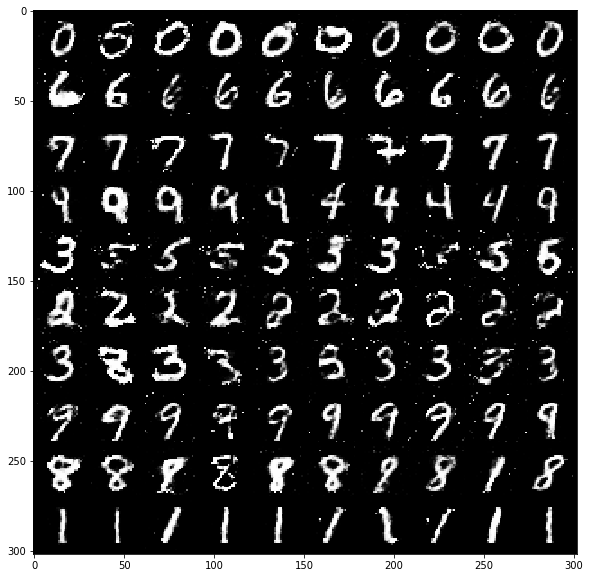

[Epoch 86/500] [Batch 599/600] [D loss: 6.401203] [G loss: 8.730876] [C loss 1: 0.015968] [C loss 2: 0.001393] 	 Time Interv: 29.617964


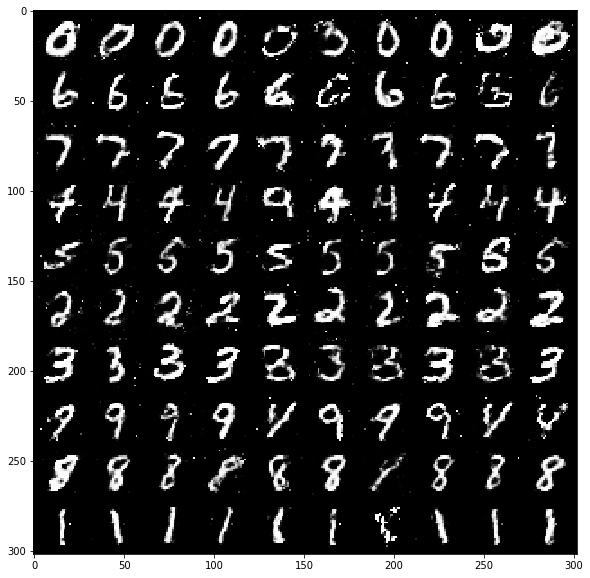

[Epoch 88/500] [Batch 599/600] [D loss: 6.424911] [G loss: 8.713934] [C loss 1: 0.012694] [C loss 2: 0.001090] 	 Time Interv: 30.165713


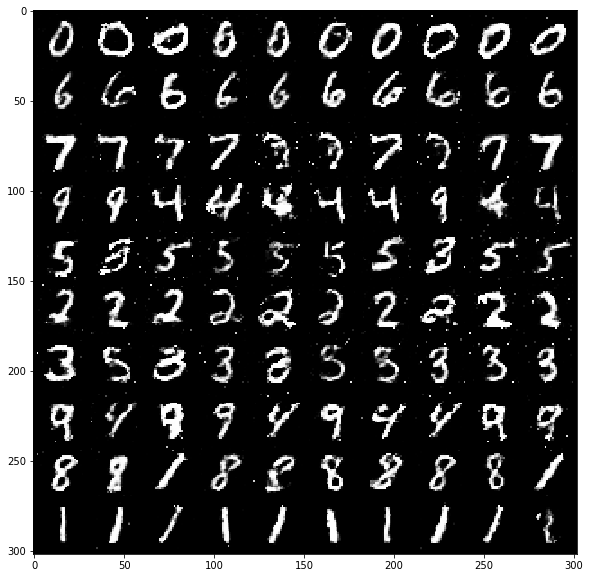

[Epoch 90/500] [Batch 599/600] [D loss: 6.395400] [G loss: 8.812731] [C loss 1: 0.015599] [C loss 2: 0.001300] 	 Time Interv: 28.848891


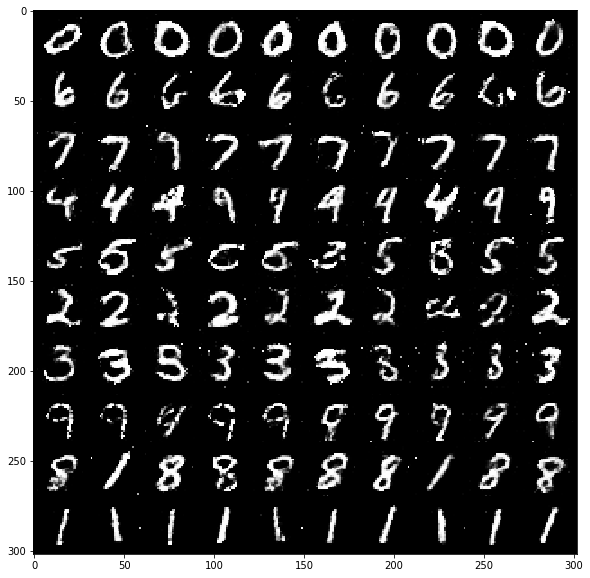

[Epoch 92/500] [Batch 599/600] [D loss: 6.385533] [G loss: 8.812496] [C loss 1: 0.013035] [C loss 2: 0.000964] 	 Time Interv: 29.678292


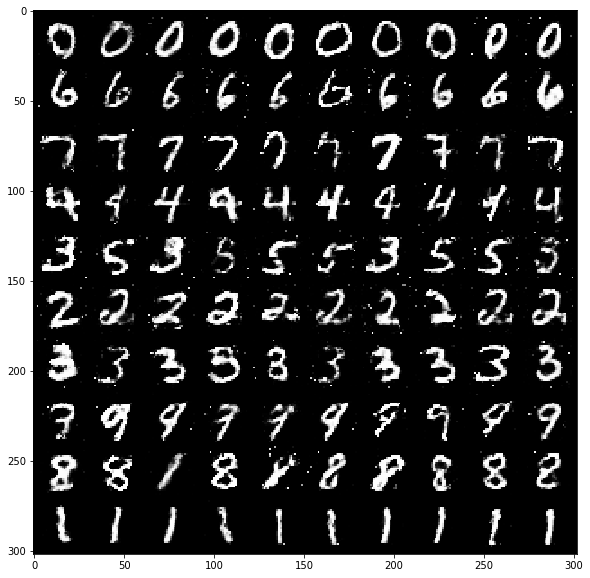

[Epoch 94/500] [Batch 599/600] [D loss: 6.390208] [G loss: 8.798343] [C loss 1: 0.017025] [C loss 2: 0.001133] 	 Time Interv: 29.594161


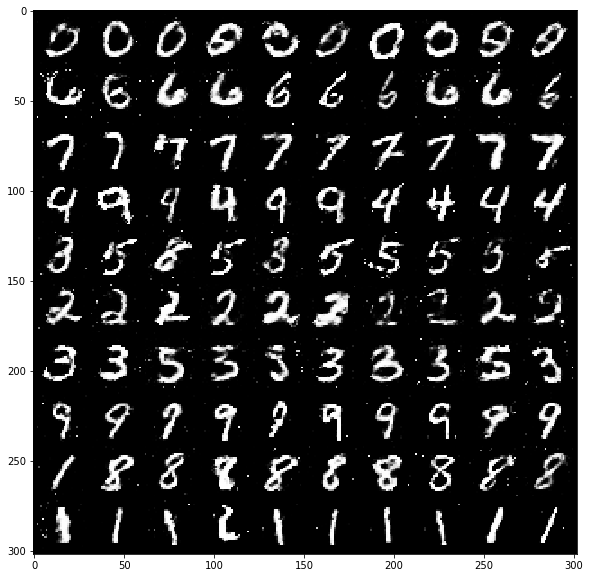

[Epoch 96/500] [Batch 599/600] [D loss: 6.365015] [G loss: 8.801278] [C loss 1: 0.016009] [C loss 2: 0.001047] 	 Time Interv: 29.485472


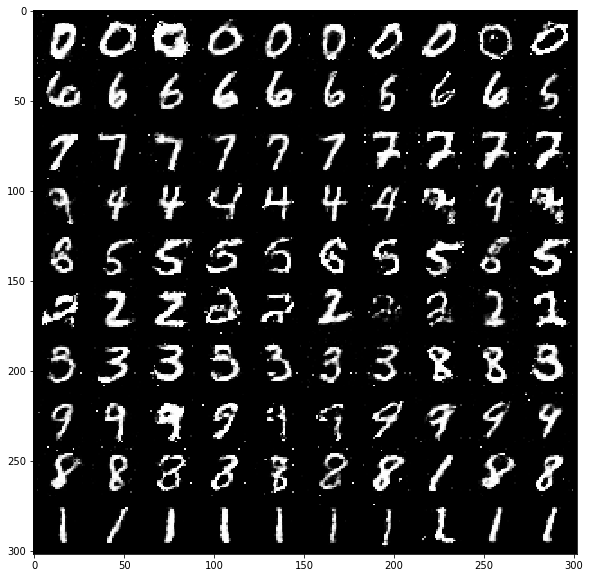

[Epoch 98/500] [Batch 599/600] [D loss: 6.369517] [G loss: 8.849288] [C loss 1: 0.015608] [C loss 2: 0.001301] 	 Time Interv: 28.703264


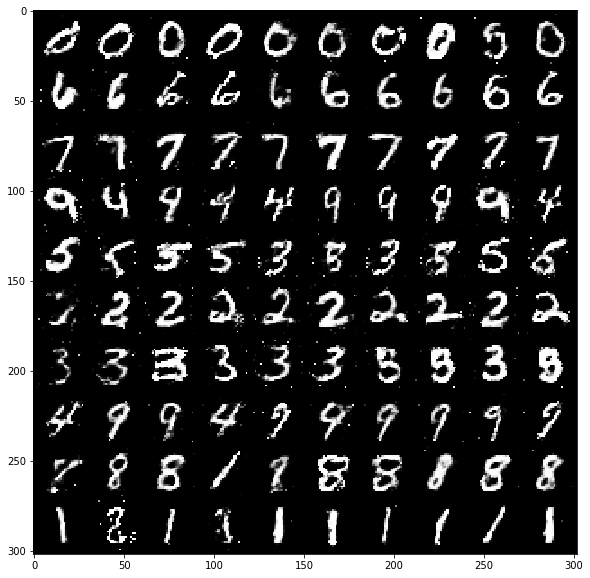

[Epoch 100/500] [Batch 599/600] [D loss: 6.387259] [G loss: 8.839242] [C loss 1: 0.013950] [C loss 2: 0.000930] 	 Time Interv: 29.507693


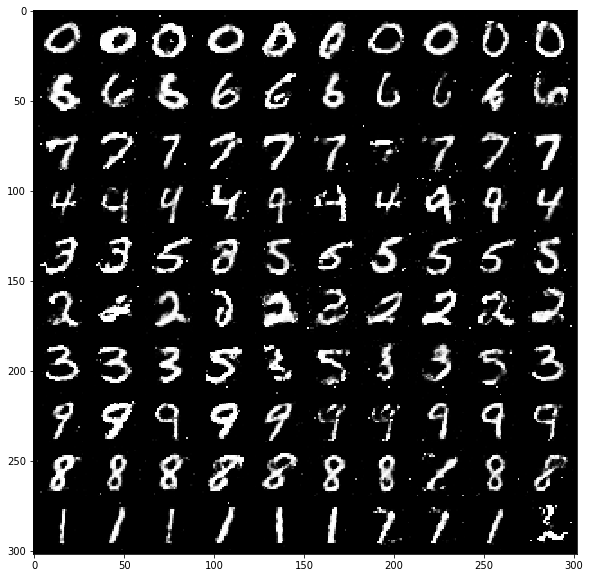

[Epoch 102/500] [Batch 599/600] [D loss: 6.364555] [G loss: 8.817135] [C loss 1: 0.015230] [C loss 2: 0.000828] 	 Time Interv: 28.808675


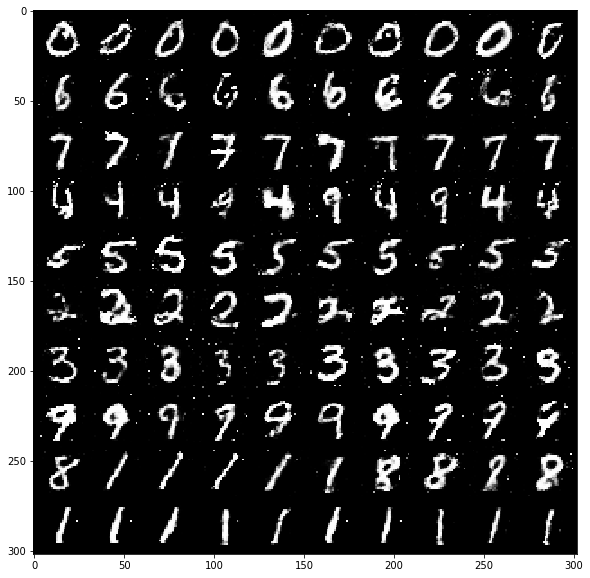

[Epoch 104/500] [Batch 599/600] [D loss: 6.358684] [G loss: 8.853005] [C loss 1: 0.016047] [C loss 2: 0.000864] 	 Time Interv: 29.798160


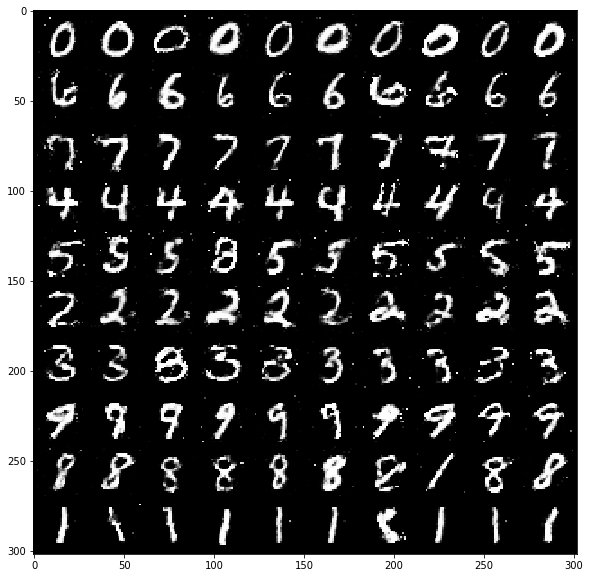

[Epoch 106/500] [Batch 599/600] [D loss: 6.309730] [G loss: 8.953855] [C loss 1: 0.016033] [C loss 2: 0.000780] 	 Time Interv: 29.303123


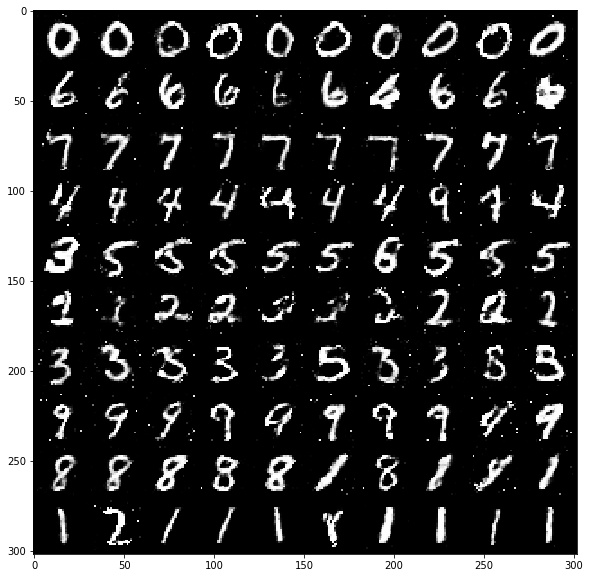

[Epoch 108/500] [Batch 599/600] [D loss: 6.344281] [G loss: 8.879120] [C loss 1: 0.015358] [C loss 2: 0.000766] 	 Time Interv: 30.025339


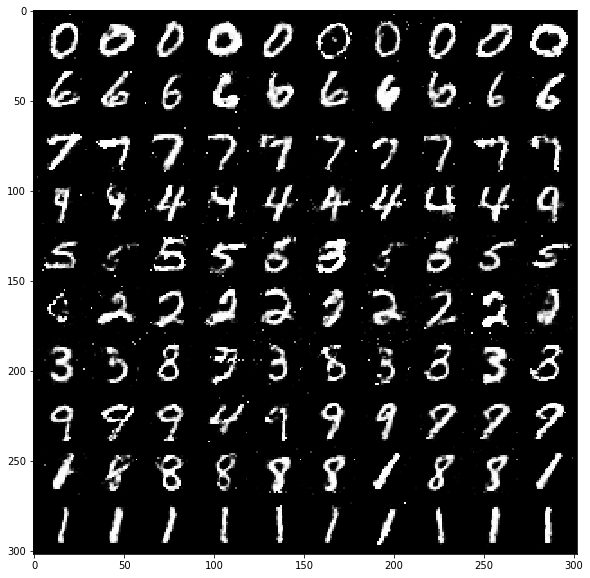

[Epoch 110/500] [Batch 599/600] [D loss: 6.297889] [G loss: 8.997263] [C loss 1: 0.015646] [C loss 2: 0.000903] 	 Time Interv: 28.992304


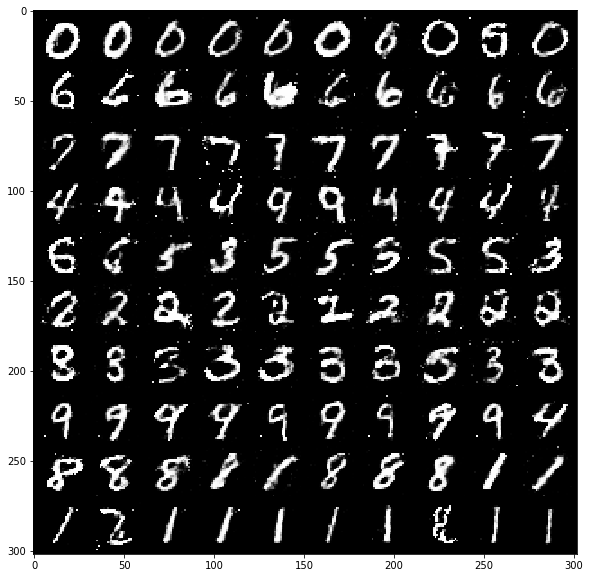

[Epoch 112/500] [Batch 599/600] [D loss: 6.291705] [G loss: 9.061347] [C loss 1: 0.017413] [C loss 2: 0.001147] 	 Time Interv: 28.780658


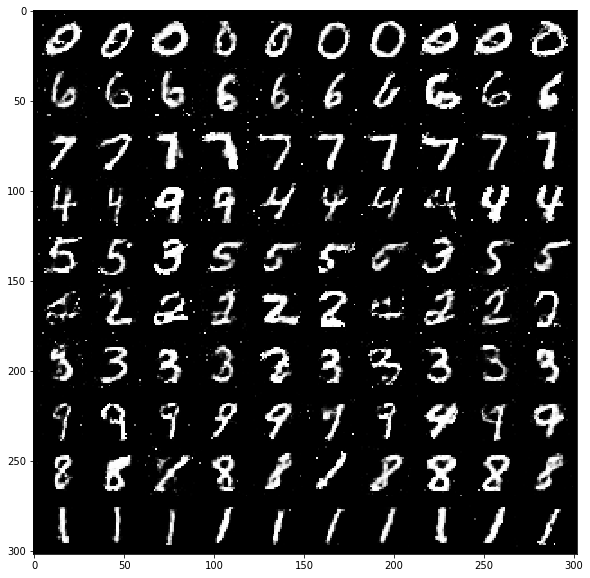

[Epoch 114/500] [Batch 599/600] [D loss: 6.307453] [G loss: 9.014594] [C loss 1: 0.015974] [C loss 2: 0.000782] 	 Time Interv: 29.054950


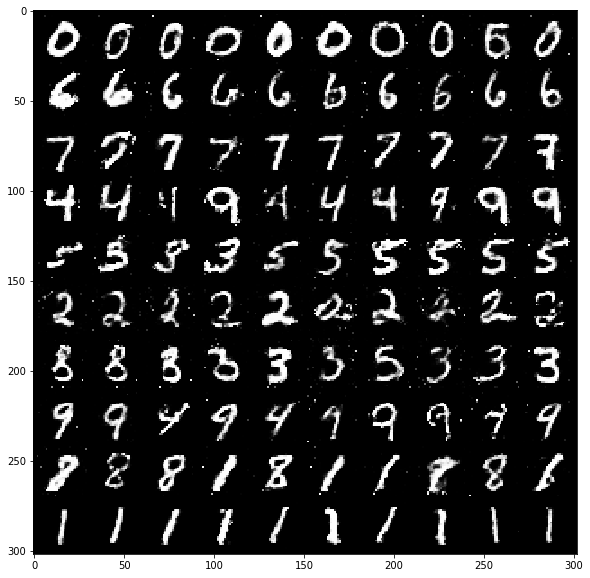

[Epoch 116/500] [Batch 599/600] [D loss: 6.328710] [G loss: 8.985474] [C loss 1: 0.013950] [C loss 2: 0.000775] 	 Time Interv: 29.143701


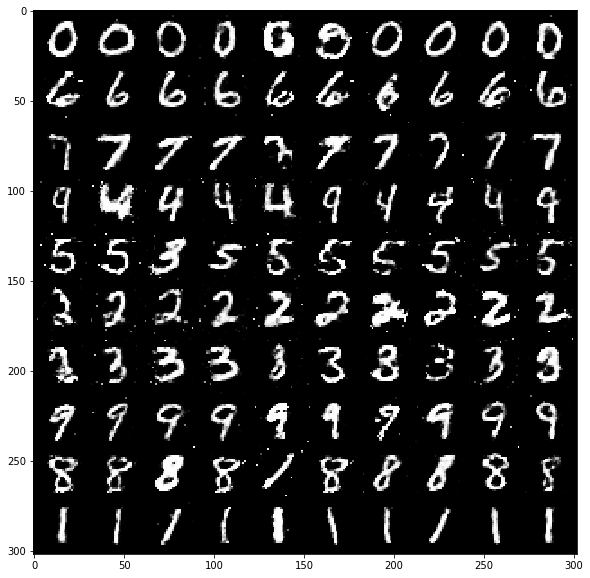

[Epoch 118/500] [Batch 599/600] [D loss: 6.296726] [G loss: 9.056319] [C loss 1: 0.014654] [C loss 2: 0.000767] 	 Time Interv: 29.537691


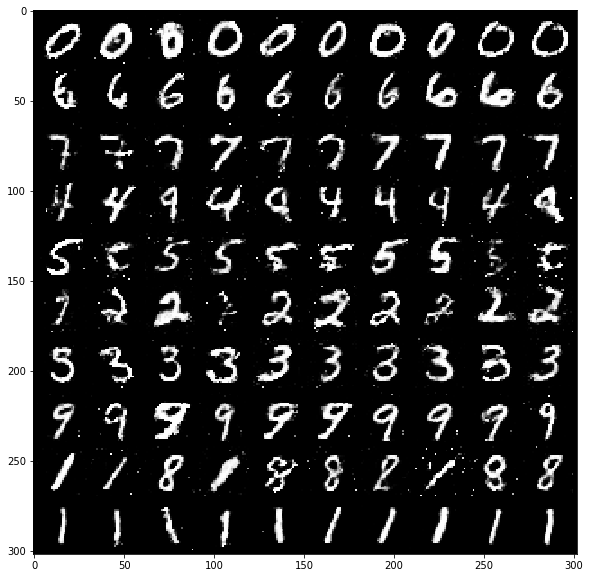

[Epoch 120/500] [Batch 599/600] [D loss: 6.262217] [G loss: 9.145079] [C loss 1: 0.017296] [C loss 2: 0.000775] 	 Time Interv: 29.304970


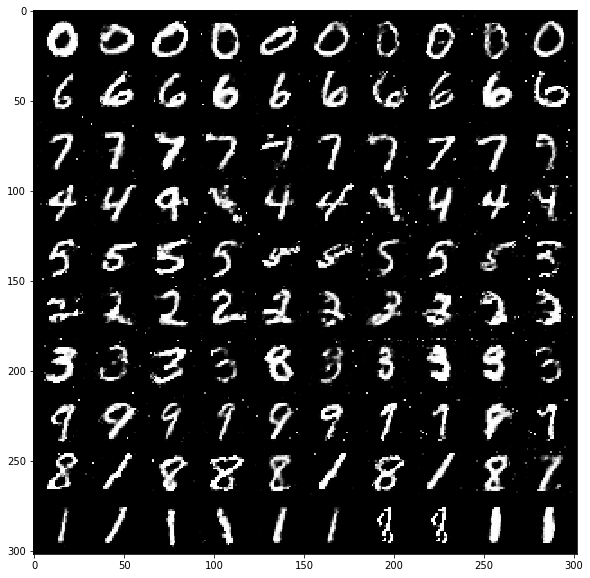

[Epoch 122/500] [Batch 599/600] [D loss: 6.261975] [G loss: 9.147071] [C loss 1: 0.019068] [C loss 2: 0.000759] 	 Time Interv: 29.320126


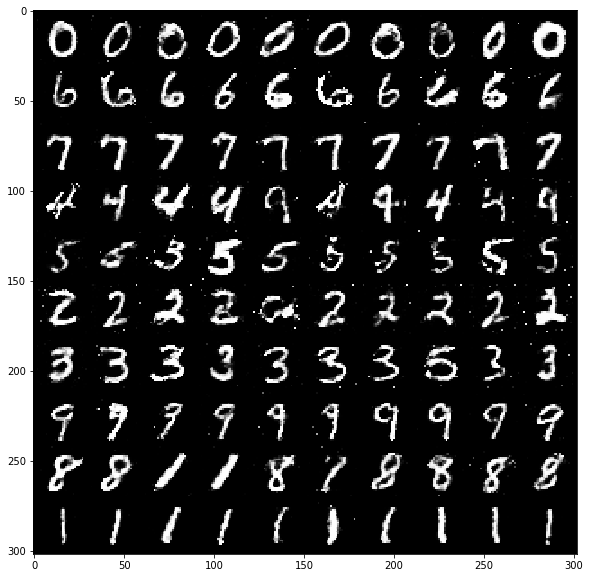

[Epoch 124/500] [Batch 599/600] [D loss: 6.273098] [G loss: 9.190843] [C loss 1: 0.016381] [C loss 2: 0.000783] 	 Time Interv: 29.213559


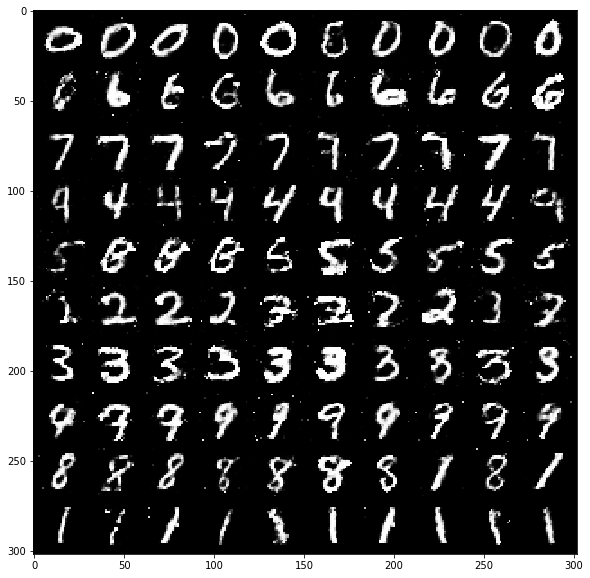

[Epoch 126/500] [Batch 599/600] [D loss: 6.269933] [G loss: 9.112356] [C loss 1: 0.015227] [C loss 2: 0.000592] 	 Time Interv: 29.273054


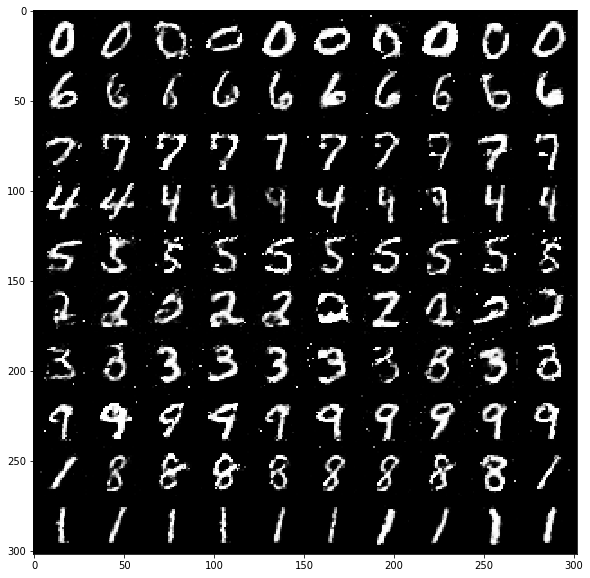

[Epoch 128/500] [Batch 599/600] [D loss: 6.222878] [G loss: 9.193765] [C loss 1: 0.018042] [C loss 2: 0.000786] 	 Time Interv: 28.990553


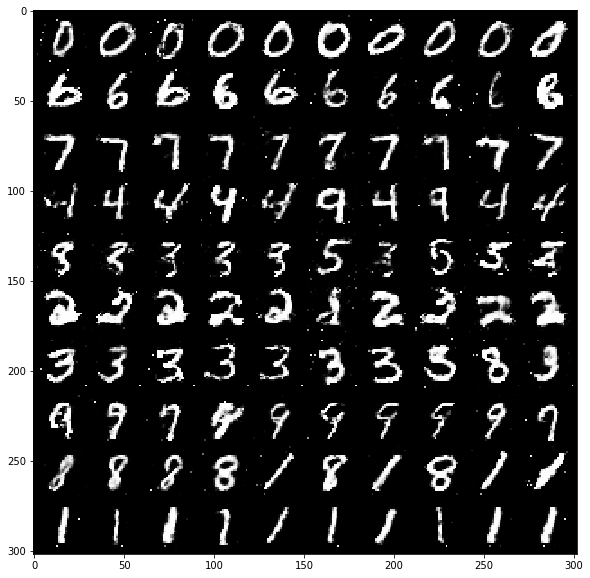

[Epoch 130/500] [Batch 599/600] [D loss: 6.291538] [G loss: 9.097932] [C loss 1: 0.017542] [C loss 2: 0.000630] 	 Time Interv: 28.801619


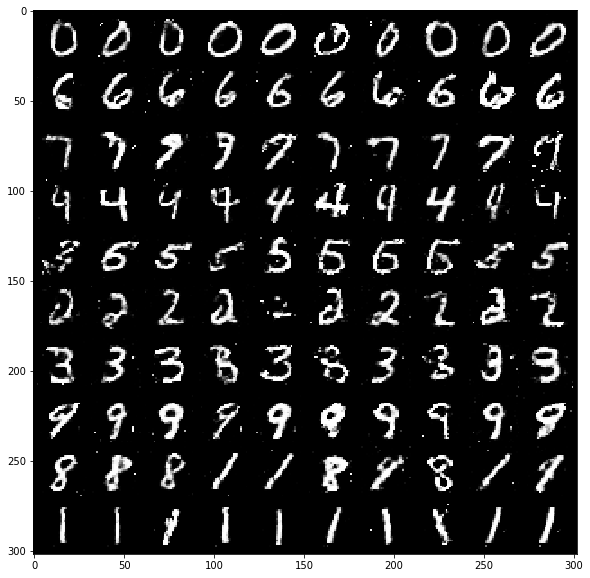

[Epoch 132/500] [Batch 599/600] [D loss: 6.261431] [G loss: 9.145034] [C loss 1: 0.018340] [C loss 2: 0.000866] 	 Time Interv: 30.254005


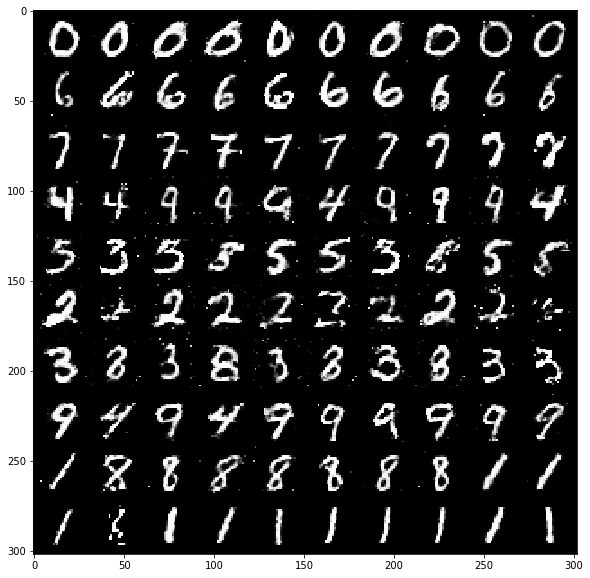

[Epoch 134/500] [Batch 599/600] [D loss: 6.245966] [G loss: 9.196457] [C loss 1: 0.019304] [C loss 2: 0.000924] 	 Time Interv: 29.118251


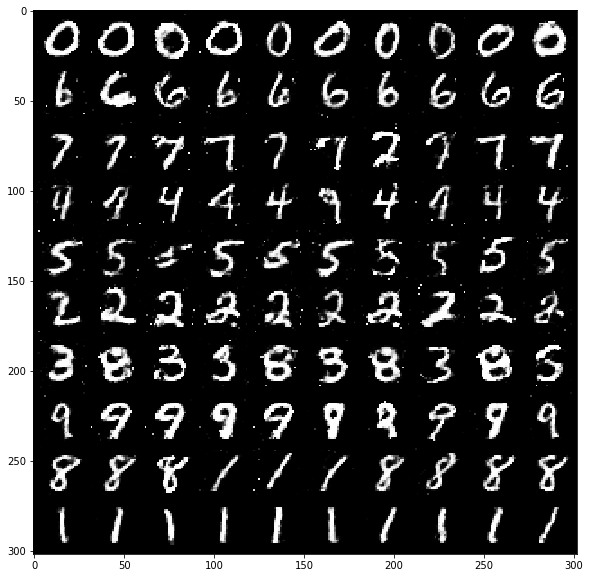

[Epoch 136/500] [Batch 599/600] [D loss: 6.241645] [G loss: 9.222476] [C loss 1: 0.016634] [C loss 2: 0.000607] 	 Time Interv: 29.190895


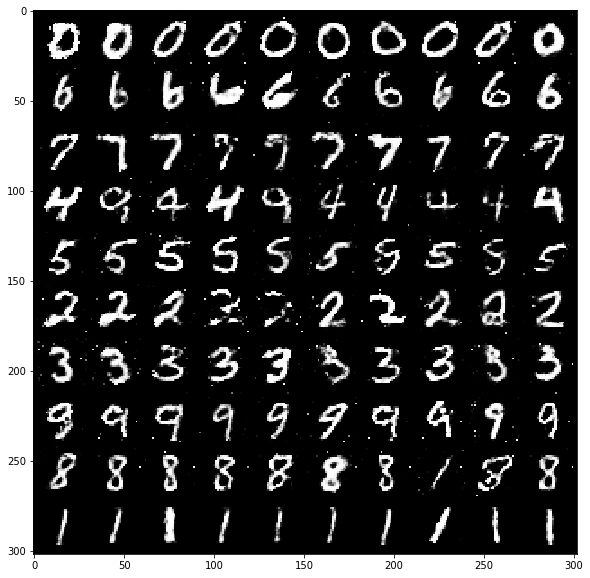

[Epoch 138/500] [Batch 599/600] [D loss: 6.257209] [G loss: 9.206660] [C loss 1: 0.018231] [C loss 2: 0.000589] 	 Time Interv: 29.865324


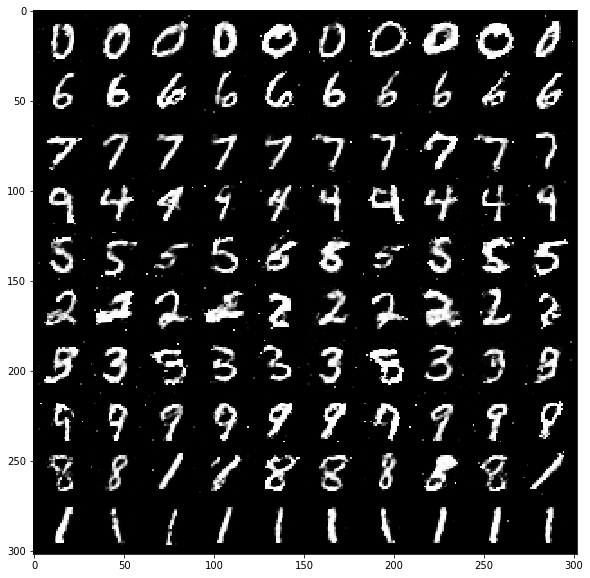

[Epoch 140/500] [Batch 599/600] [D loss: 6.283051] [G loss: 9.211062] [C loss 1: 0.014942] [C loss 2: 0.000494] 	 Time Interv: 29.510123


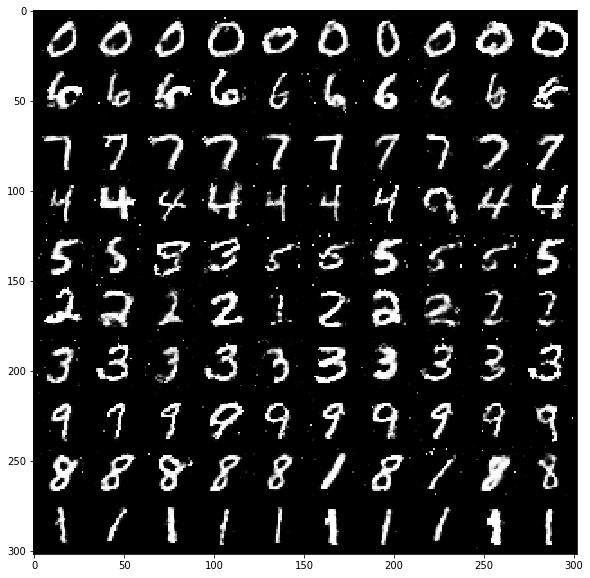

[Epoch 142/500] [Batch 599/600] [D loss: 6.288196] [G loss: 9.159237] [C loss 1: 0.017020] [C loss 2: 0.000602] 	 Time Interv: 29.182941


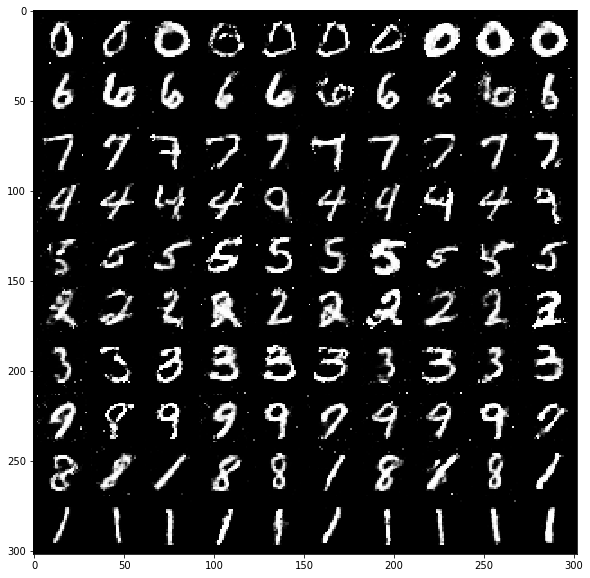

[Epoch 144/500] [Batch 599/600] [D loss: 6.231135] [G loss: 9.302299] [C loss 1: 0.016019] [C loss 2: 0.000690] 	 Time Interv: 29.021527


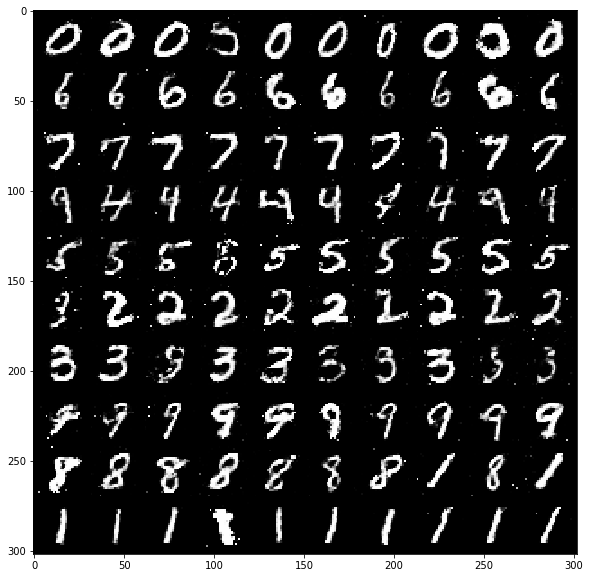

[Epoch 146/500] [Batch 599/600] [D loss: 6.197728] [G loss: 9.281344] [C loss 1: 0.018675] [C loss 2: 0.000715] 	 Time Interv: 29.086626


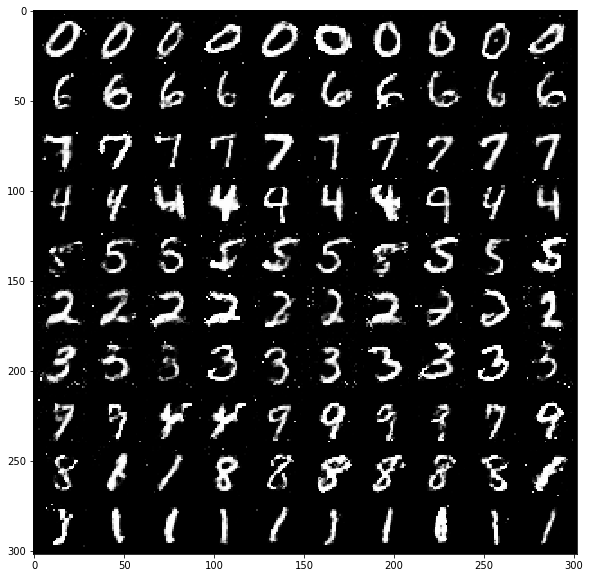

[Epoch 148/500] [Batch 599/600] [D loss: 6.303237] [G loss: 9.196803] [C loss 1: 0.017077] [C loss 2: 0.000542] 	 Time Interv: 28.741078


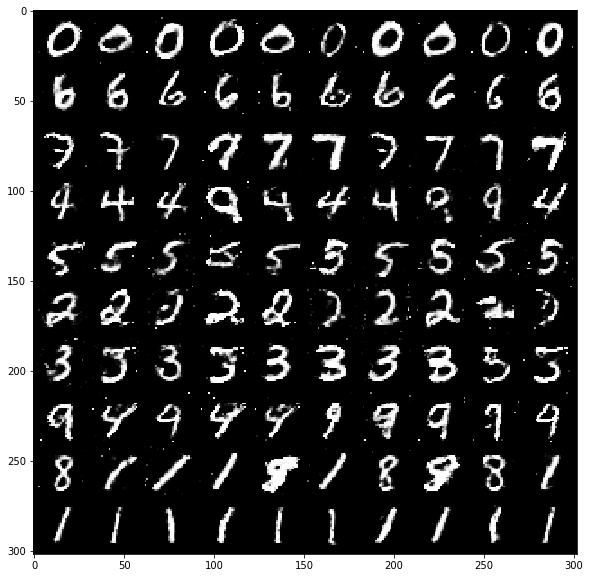

[Epoch 150/500] [Batch 599/600] [D loss: 6.217498] [G loss: 9.245710] [C loss 1: 0.016354] [C loss 2: 0.000562] 	 Time Interv: 29.501040


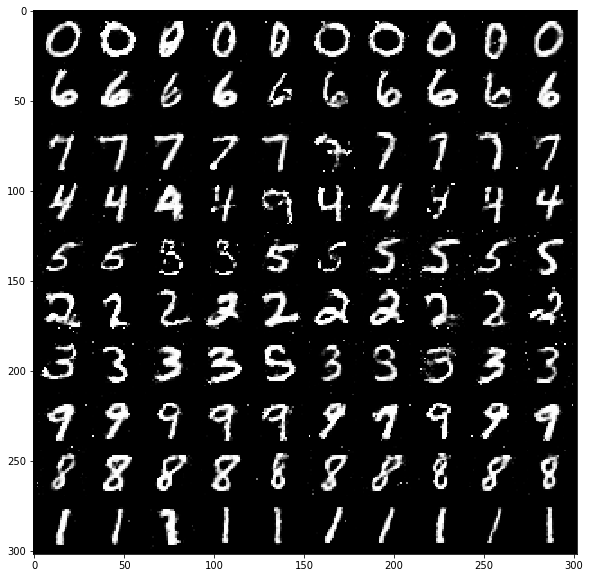

[Epoch 152/500] [Batch 599/600] [D loss: 6.197881] [G loss: 9.322616] [C loss 1: 0.018354] [C loss 2: 0.000555] 	 Time Interv: 28.870760


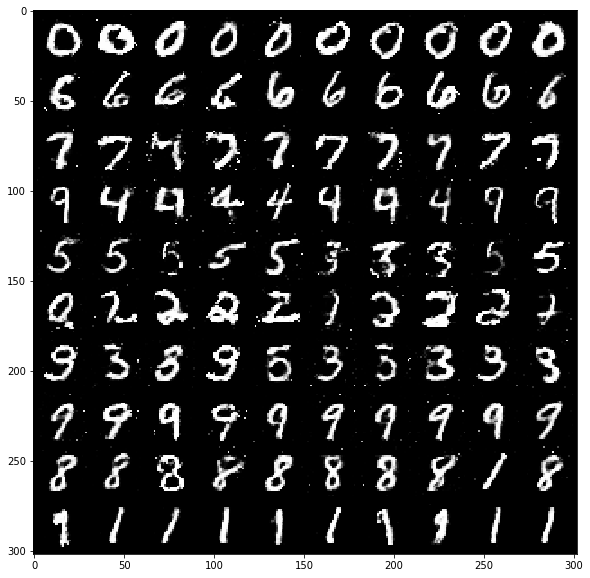

[Epoch 154/500] [Batch 599/600] [D loss: 6.228374] [G loss: 9.251080] [C loss 1: 0.018865] [C loss 2: 0.000598] 	 Time Interv: 29.377573


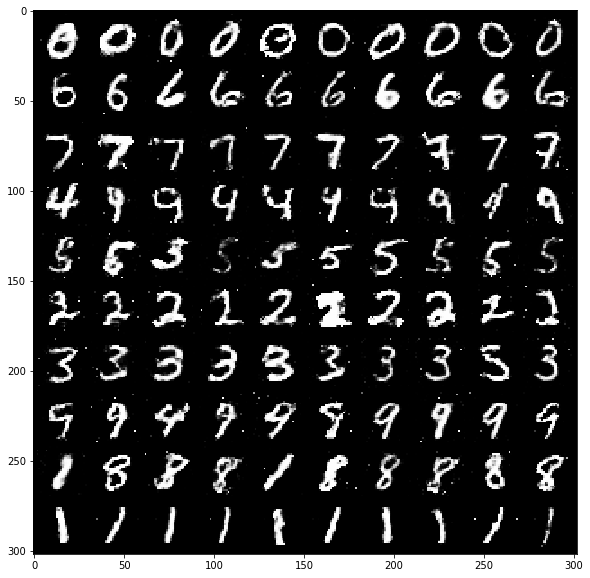

[Epoch 156/500] [Batch 599/600] [D loss: 6.200928] [G loss: 9.344491] [C loss 1: 0.017895] [C loss 2: 0.000419] 	 Time Interv: 29.390195


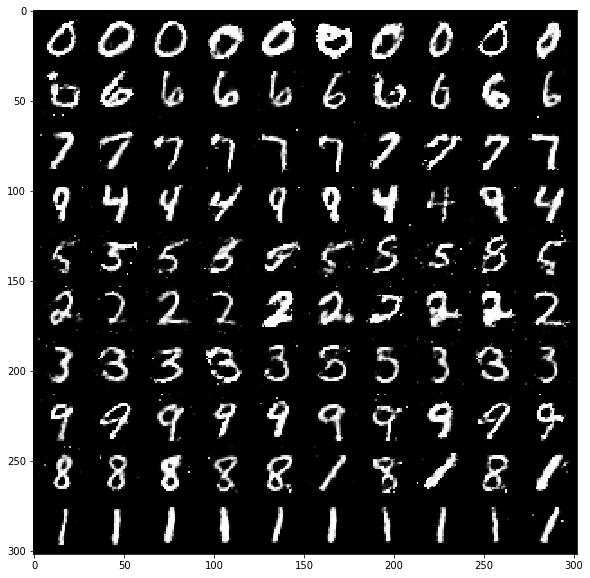

[Epoch 158/500] [Batch 599/600] [D loss: 6.187723] [G loss: 9.336200] [C loss 1: 0.018673] [C loss 2: 0.000573] 	 Time Interv: 29.686837


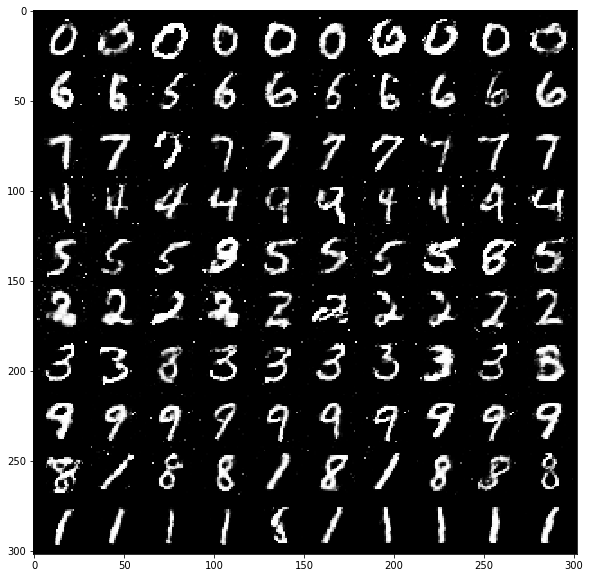

[Epoch 160/500] [Batch 599/600] [D loss: 6.184399] [G loss: 9.429441] [C loss 1: 0.021319] [C loss 2: 0.000690] 	 Time Interv: 30.201752


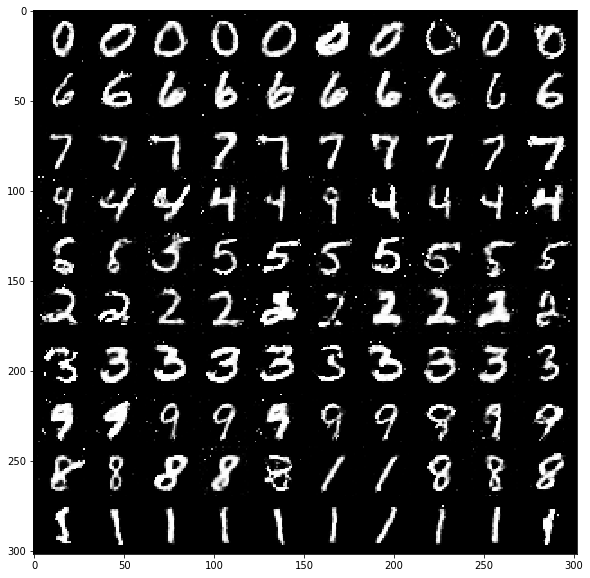

[Epoch 162/500] [Batch 599/600] [D loss: 6.220568] [G loss: 9.381569] [C loss 1: 0.017125] [C loss 2: 0.000520] 	 Time Interv: 29.101862


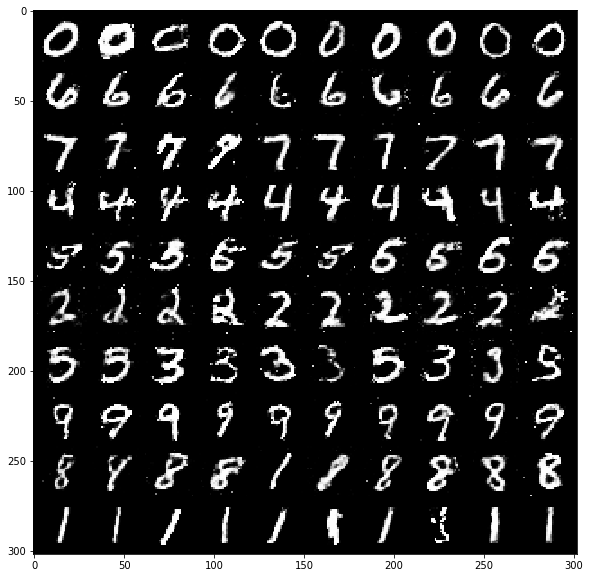

[Epoch 164/500] [Batch 599/600] [D loss: 6.232865] [G loss: 9.338901] [C loss 1: 0.021330] [C loss 2: 0.000626] 	 Time Interv: 29.208771


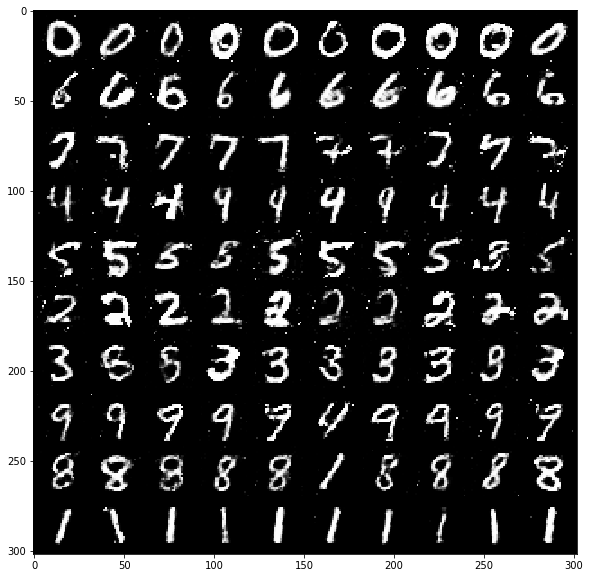

[Epoch 166/500] [Batch 599/600] [D loss: 6.242034] [G loss: 9.318562] [C loss 1: 0.020650] [C loss 2: 0.000489] 	 Time Interv: 29.223577


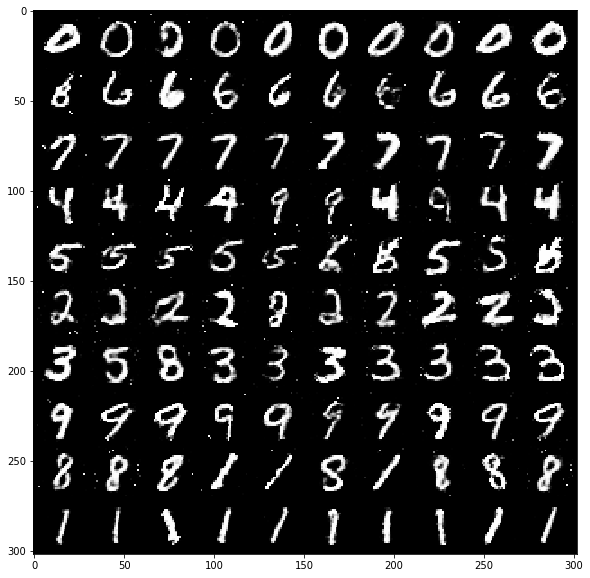

[Epoch 168/500] [Batch 599/600] [D loss: 6.161796] [G loss: 9.475404] [C loss 1: 0.020393] [C loss 2: 0.000530] 	 Time Interv: 29.450815


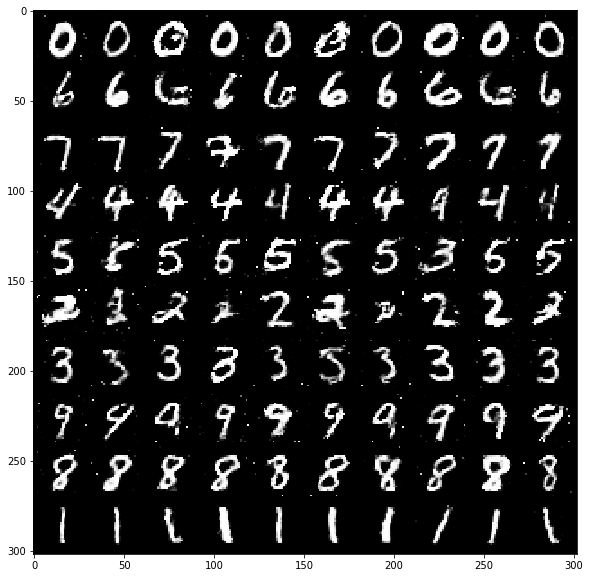

[Epoch 170/500] [Batch 599/600] [D loss: 6.186777] [G loss: 9.388189] [C loss 1: 0.022253] [C loss 2: 0.000511] 	 Time Interv: 29.833507


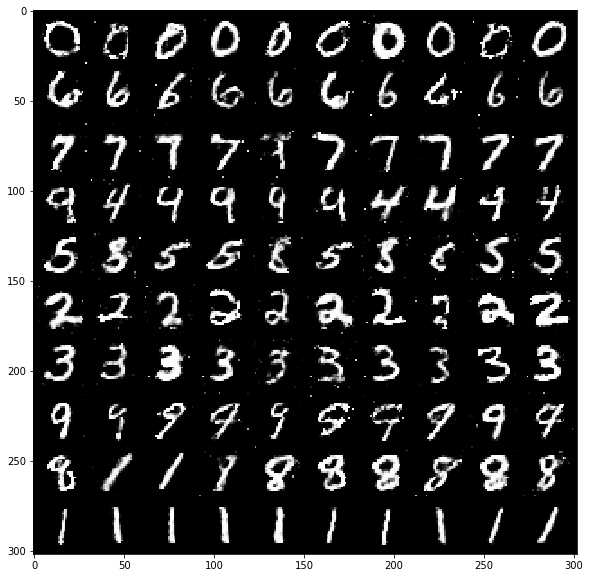

[Epoch 172/500] [Batch 599/600] [D loss: 6.191798] [G loss: 9.421840] [C loss 1: 0.019582] [C loss 2: 0.000429] 	 Time Interv: 28.876249


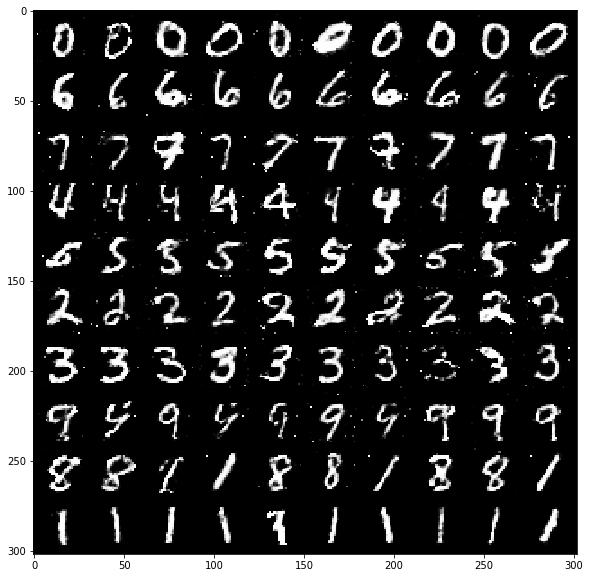

[Epoch 174/500] [Batch 599/600] [D loss: 6.226578] [G loss: 9.393100] [C loss 1: 0.017322] [C loss 2: 0.000455] 	 Time Interv: 28.951726


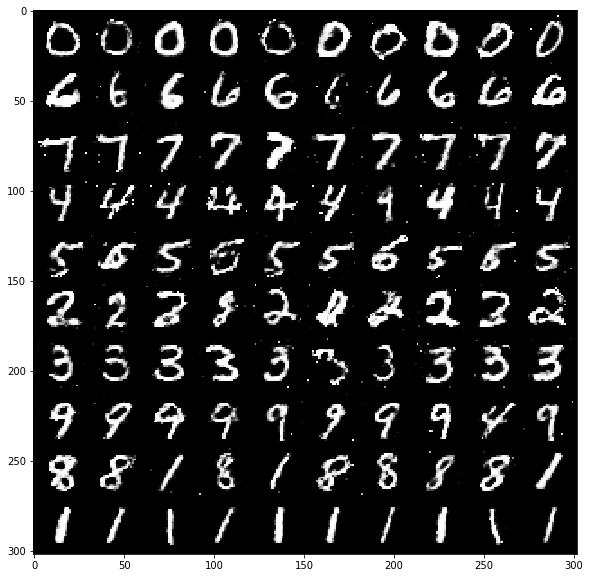

[Epoch 176/500] [Batch 599/600] [D loss: 6.145609] [G loss: 9.541541] [C loss 1: 0.020324] [C loss 2: 0.000511] 	 Time Interv: 28.687027


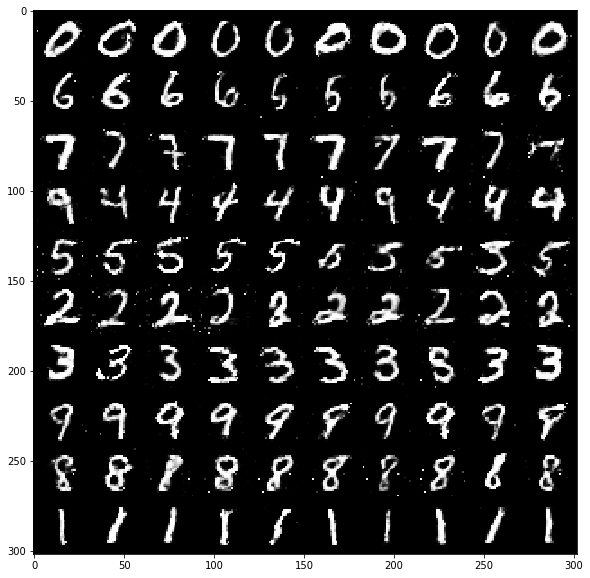

[Epoch 178/500] [Batch 599/600] [D loss: 6.187884] [G loss: 9.405614] [C loss 1: 0.016846] [C loss 2: 0.000485] 	 Time Interv: 29.521235


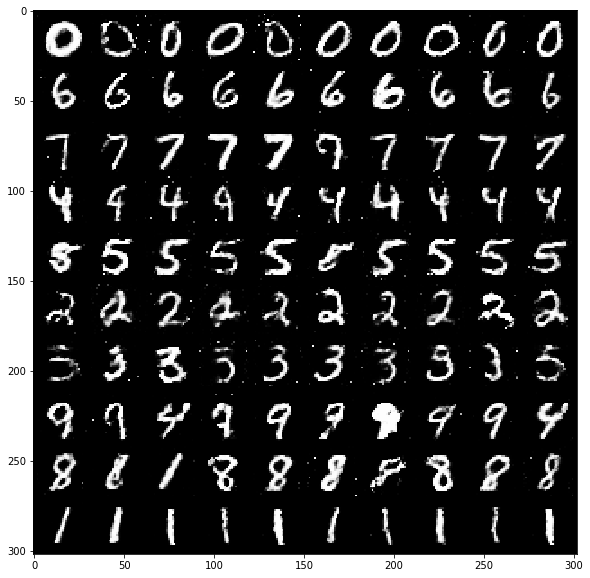

[Epoch 180/500] [Batch 599/600] [D loss: 6.149706] [G loss: 9.591759] [C loss 1: 0.018058] [C loss 2: 0.000504] 	 Time Interv: 29.199486


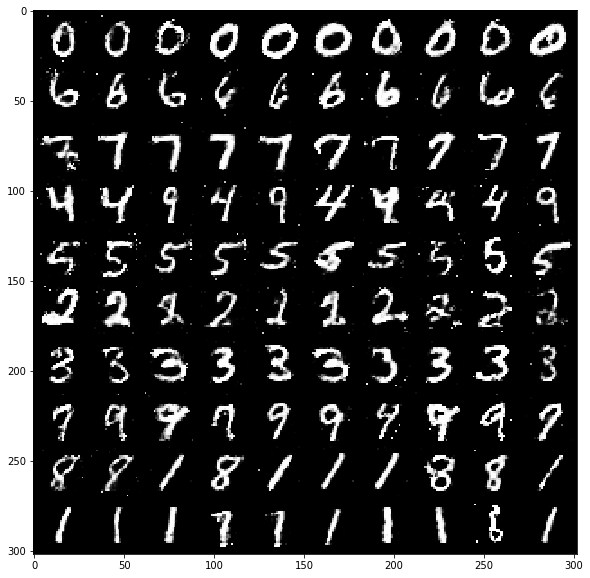

[Epoch 182/500] [Batch 599/600] [D loss: 6.129137] [G loss: 9.554292] [C loss 1: 0.022360] [C loss 2: 0.000573] 	 Time Interv: 29.337334


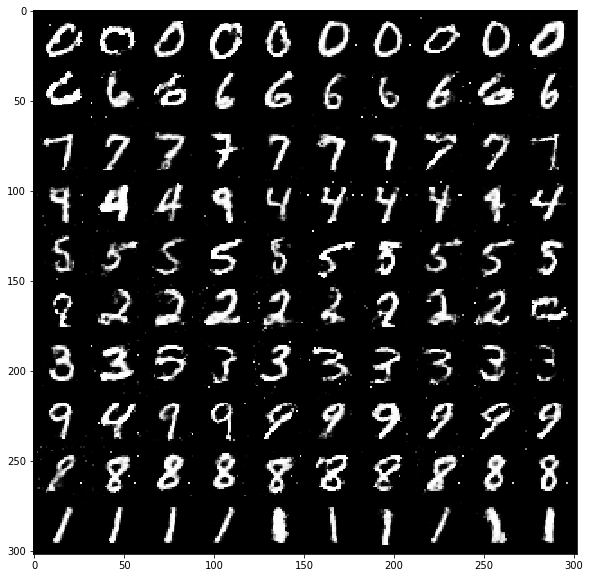

[Epoch 184/500] [Batch 599/600] [D loss: 6.100545] [G loss: 9.666707] [C loss 1: 0.024465] [C loss 2: 0.000687] 	 Time Interv: 30.063011


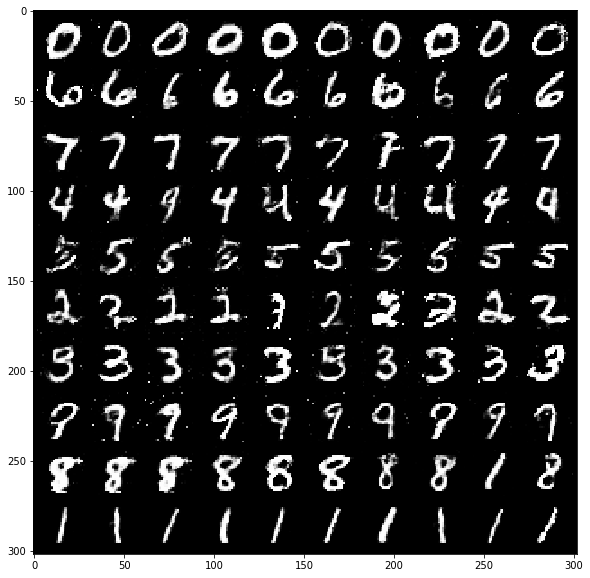

[Epoch 186/500] [Batch 599/600] [D loss: 6.195677] [G loss: 9.493730] [C loss 1: 0.020920] [C loss 2: 0.000481] 	 Time Interv: 29.035419


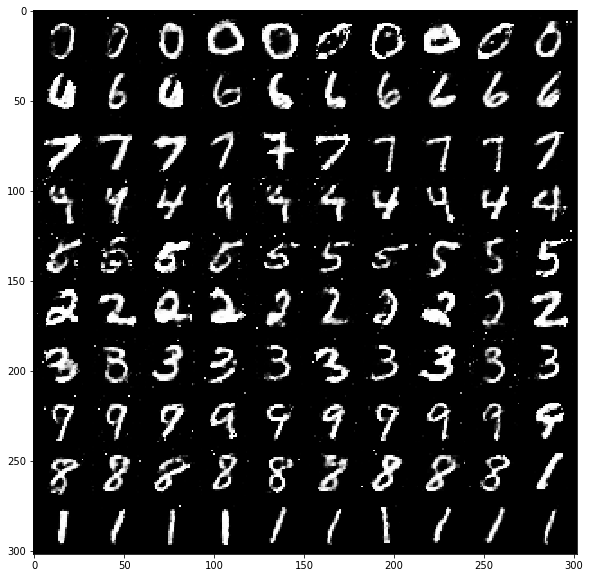

[Epoch 188/500] [Batch 599/600] [D loss: 6.138527] [G loss: 9.578169] [C loss 1: 0.022250] [C loss 2: 0.000464] 	 Time Interv: 30.111204


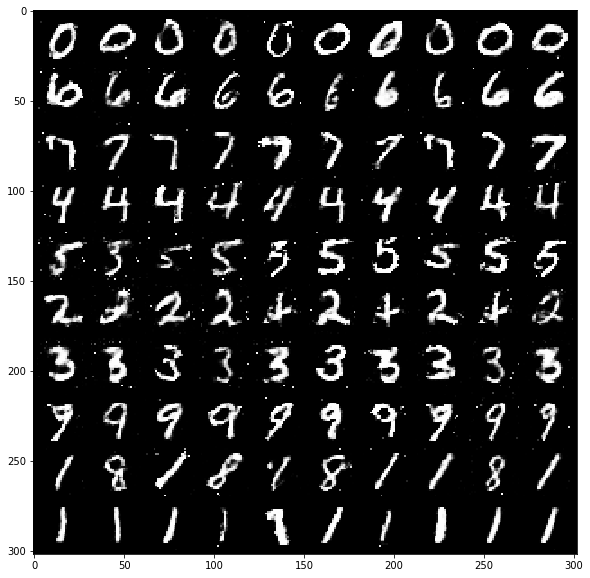

[Epoch 190/500] [Batch 599/600] [D loss: 6.132608] [G loss: 9.530326] [C loss 1: 0.022210] [C loss 2: 0.000452] 	 Time Interv: 29.028698


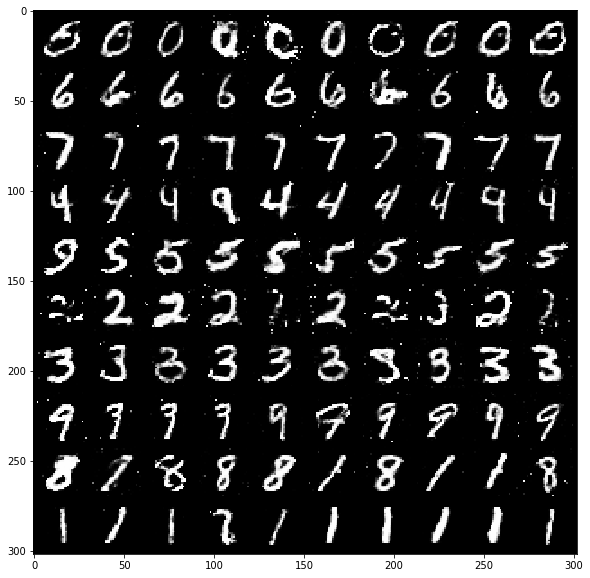

[Epoch 192/500] [Batch 599/600] [D loss: 6.117958] [G loss: 9.557459] [C loss 1: 0.026493] [C loss 2: 0.000668] 	 Time Interv: 29.228983


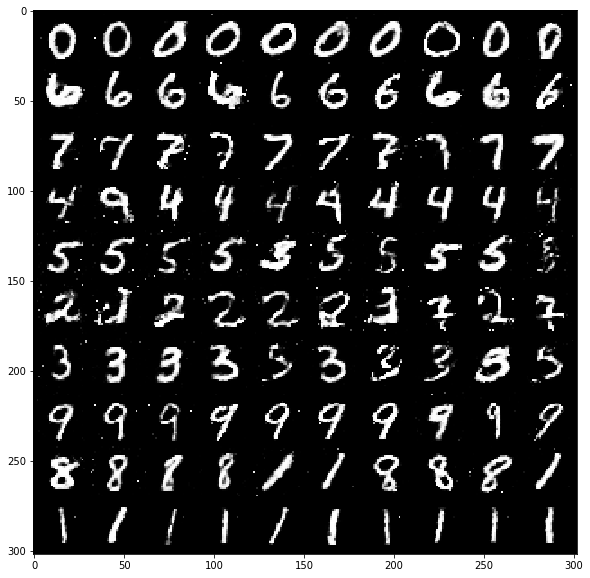

[Epoch 194/500] [Batch 599/600] [D loss: 6.094559] [G loss: 9.620192] [C loss 1: 0.020904] [C loss 2: 0.000381] 	 Time Interv: 29.151557


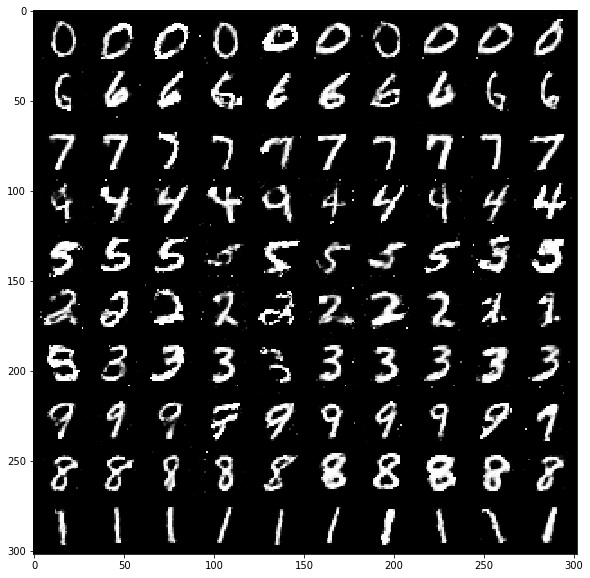

[Epoch 196/500] [Batch 599/600] [D loss: 6.117464] [G loss: 9.611869] [C loss 1: 0.016533] [C loss 2: 0.000278] 	 Time Interv: 29.230654


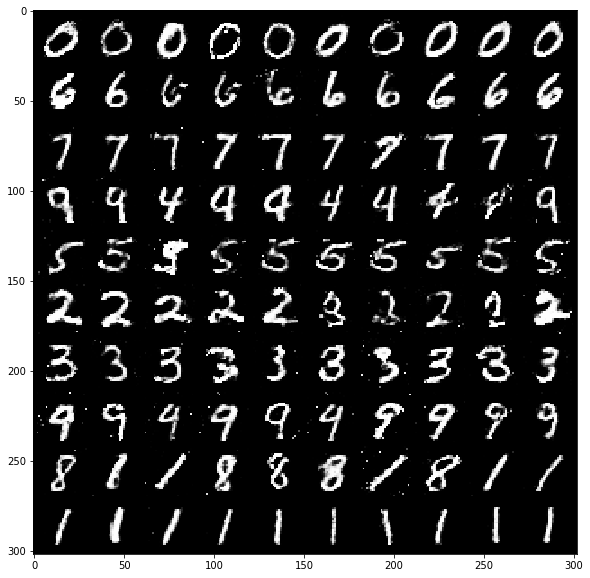

[Epoch 198/500] [Batch 599/600] [D loss: 6.137364] [G loss: 9.643654] [C loss 1: 0.023676] [C loss 2: 0.000744] 	 Time Interv: 29.245806


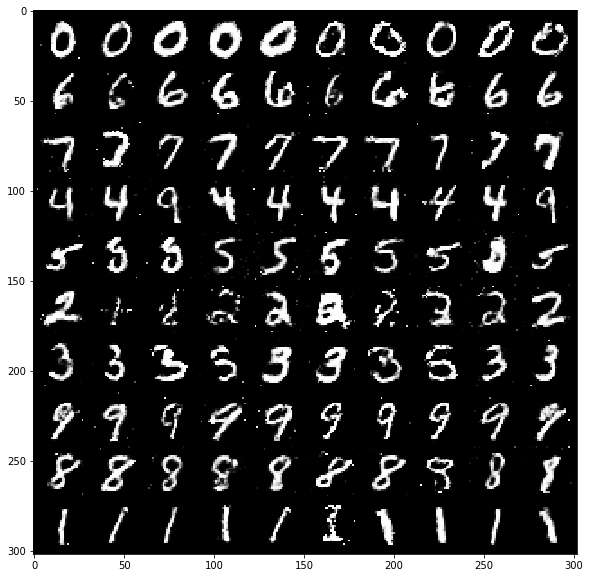

[Epoch 200/500] [Batch 599/600] [D loss: 6.147149] [G loss: 9.598466] [C loss 1: 0.021918] [C loss 2: 0.000437] 	 Time Interv: 28.761996


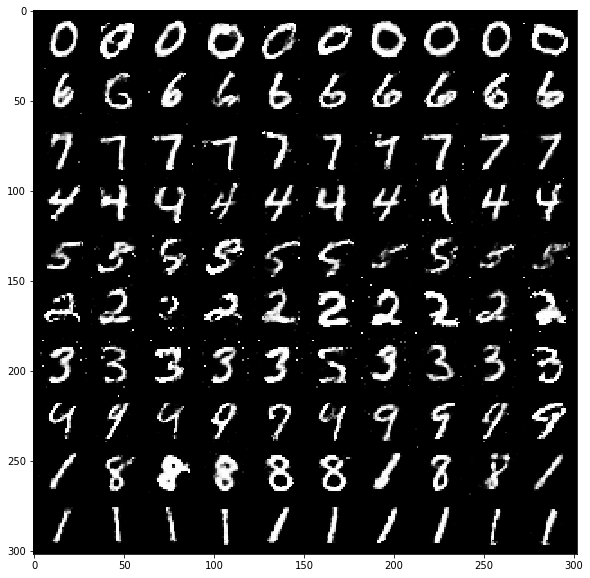

[Epoch 202/500] [Batch 599/600] [D loss: 6.111612] [G loss: 9.660022] [C loss 1: 0.021914] [C loss 2: 0.000534] 	 Time Interv: 29.225146


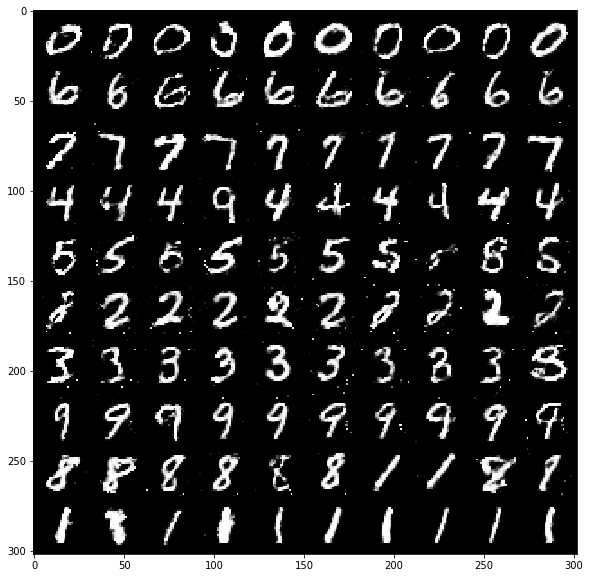

[Epoch 204/500] [Batch 599/600] [D loss: 6.073512] [G loss: 9.714237] [C loss 1: 0.024359] [C loss 2: 0.000691] 	 Time Interv: 28.944017


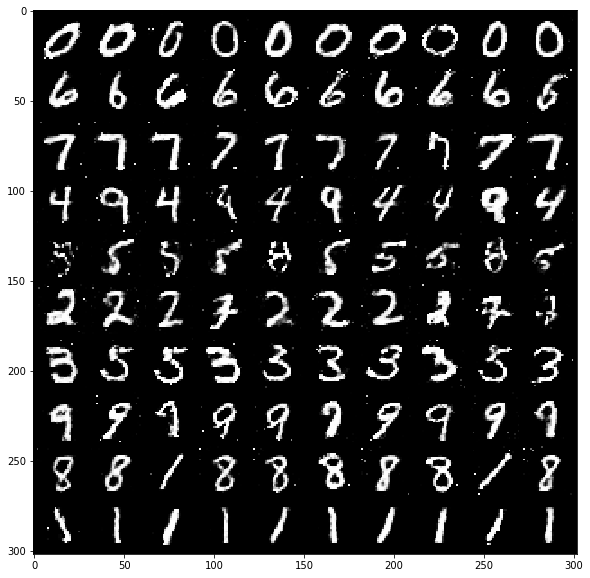

[Epoch 206/500] [Batch 599/600] [D loss: 6.094283] [G loss: 9.717772] [C loss 1: 0.023496] [C loss 2: 0.000548] 	 Time Interv: 28.392841


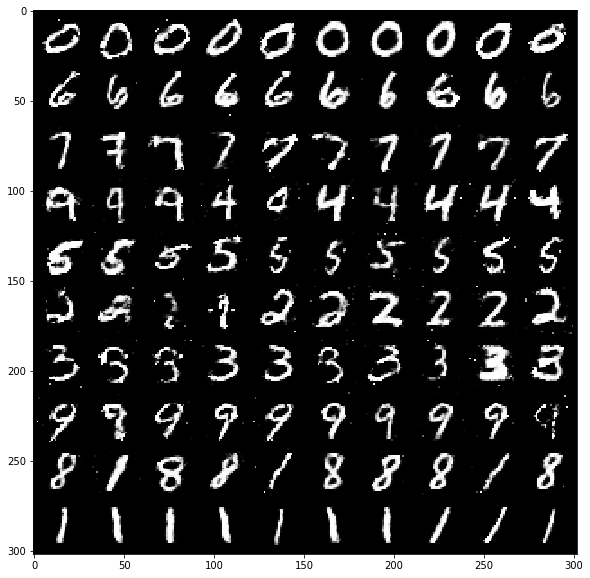

[Epoch 208/500] [Batch 599/600] [D loss: 6.063150] [G loss: 9.705531] [C loss 1: 0.024672] [C loss 2: 0.000595] 	 Time Interv: 29.437045


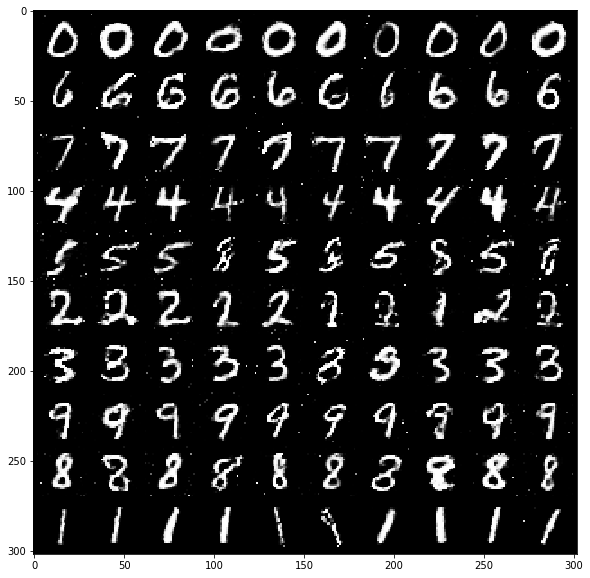

[Epoch 210/500] [Batch 599/600] [D loss: 6.157951] [G loss: 9.603485] [C loss 1: 0.021746] [C loss 2: 0.000505] 	 Time Interv: 28.926373


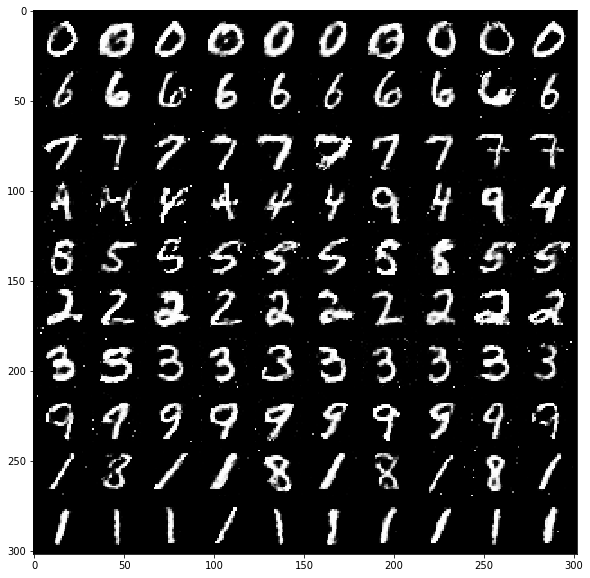

[Epoch 212/500] [Batch 599/600] [D loss: 6.084693] [G loss: 9.624744] [C loss 1: 0.022700] [C loss 2: 0.000534] 	 Time Interv: 28.842458


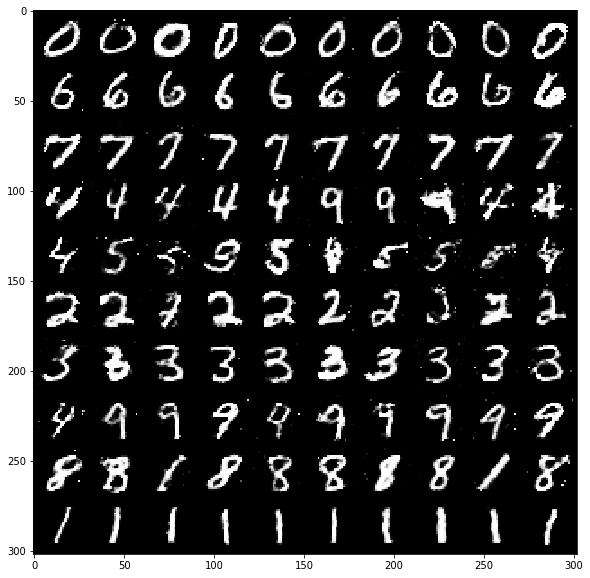

[Epoch 214/500] [Batch 599/600] [D loss: 6.066260] [G loss: 9.786001] [C loss 1: 0.023099] [C loss 2: 0.000402] 	 Time Interv: 28.874600


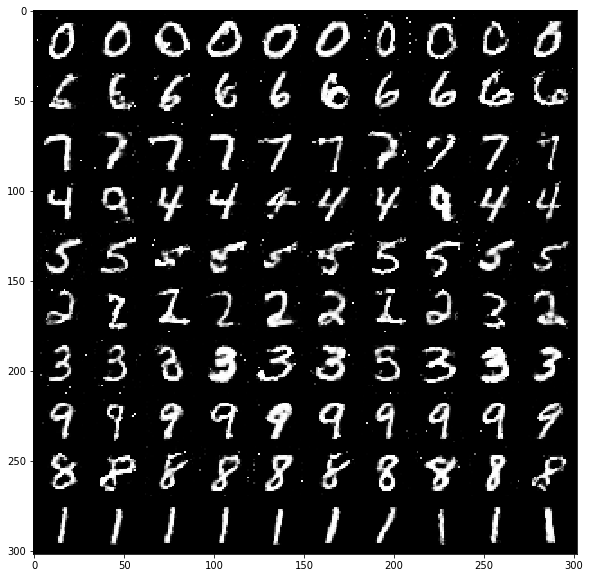

[Epoch 216/500] [Batch 599/600] [D loss: 6.102220] [G loss: 9.771799] [C loss 1: 0.022178] [C loss 2: 0.000331] 	 Time Interv: 29.117180


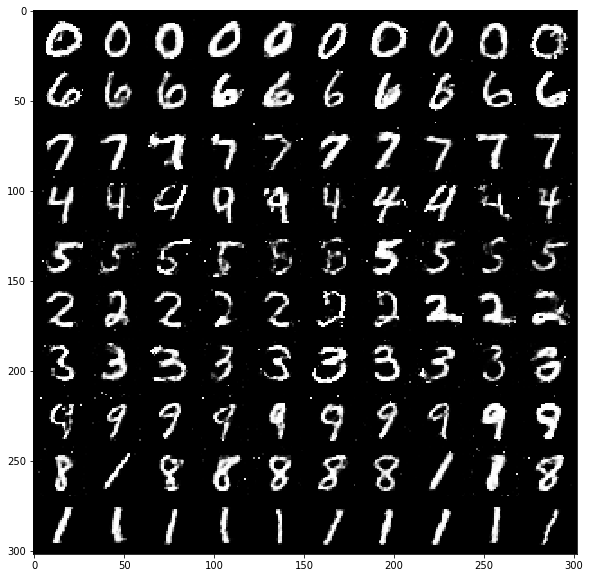

[Epoch 218/500] [Batch 599/600] [D loss: 6.079934] [G loss: 9.775146] [C loss 1: 0.019865] [C loss 2: 0.000317] 	 Time Interv: 29.252630


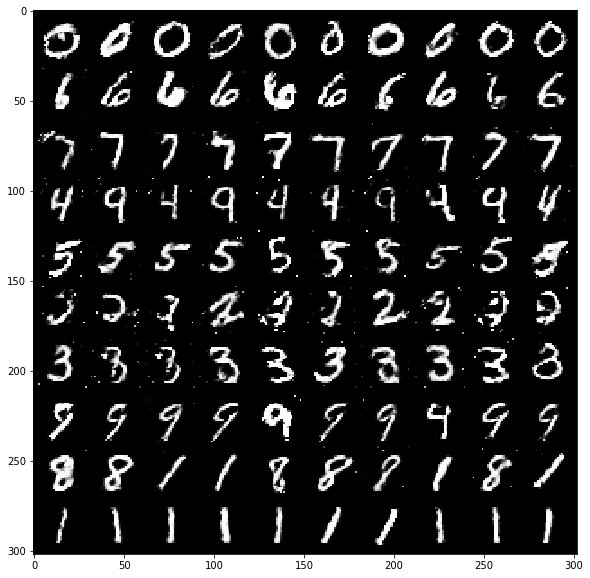

[Epoch 220/500] [Batch 599/600] [D loss: 6.076922] [G loss: 9.794070] [C loss 1: 0.025525] [C loss 2: 0.000423] 	 Time Interv: 28.976869


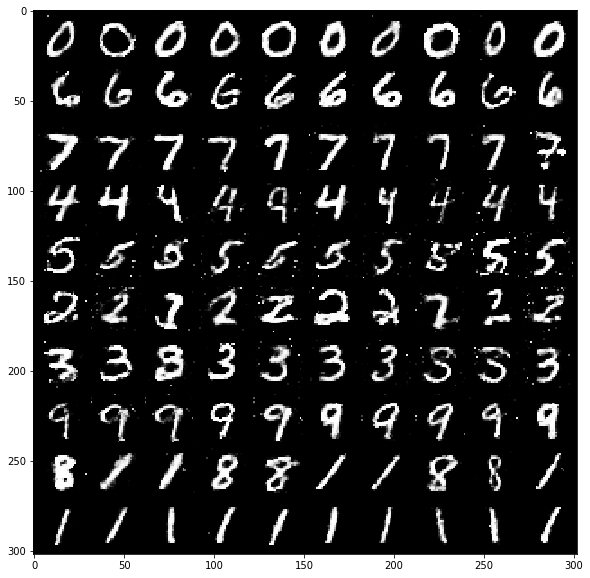

[Epoch 222/500] [Batch 599/600] [D loss: 6.061204] [G loss: 9.788582] [C loss 1: 0.022596] [C loss 2: 0.000495] 	 Time Interv: 29.148287


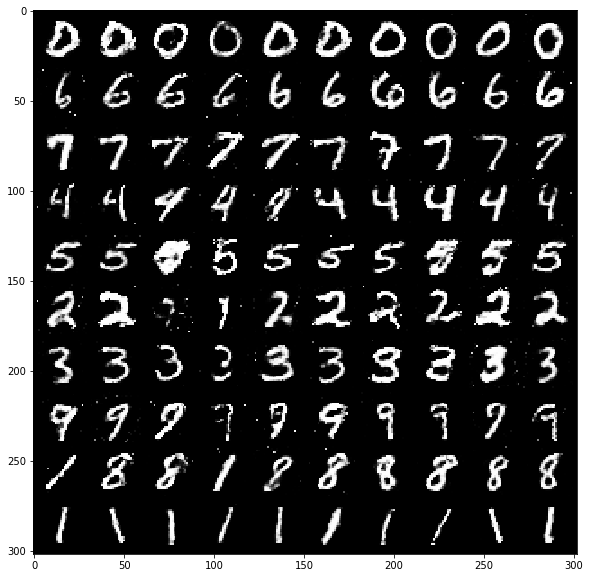

[Epoch 224/500] [Batch 599/600] [D loss: 6.104292] [G loss: 9.750138] [C loss 1: 0.021157] [C loss 2: 0.000334] 	 Time Interv: 29.210810


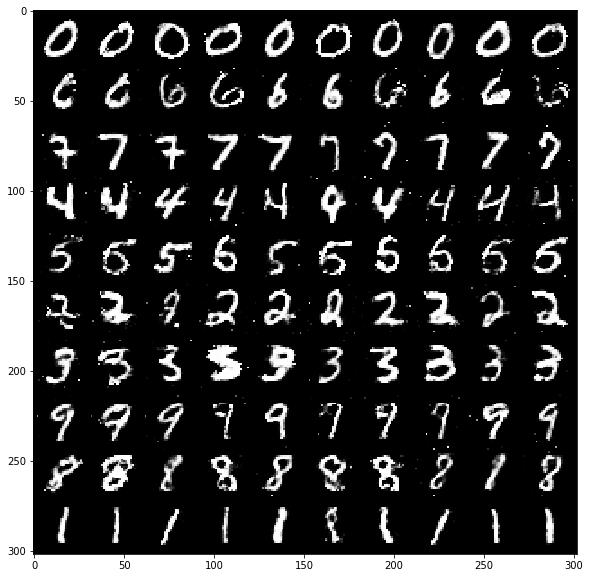

[Epoch 226/500] [Batch 599/600] [D loss: 6.114351] [G loss: 9.713618] [C loss 1: 0.022508] [C loss 2: 0.000325] 	 Time Interv: 29.843546


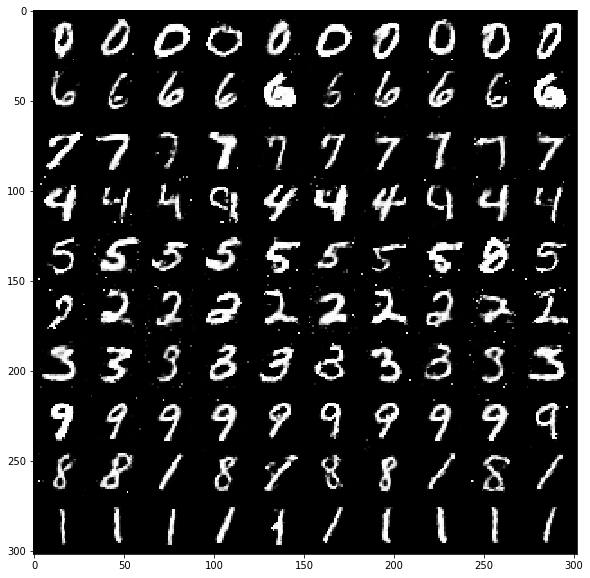

[Epoch 228/500] [Batch 599/600] [D loss: 6.073425] [G loss: 9.771991] [C loss 1: 0.026353] [C loss 2: 0.000403] 	 Time Interv: 29.506871


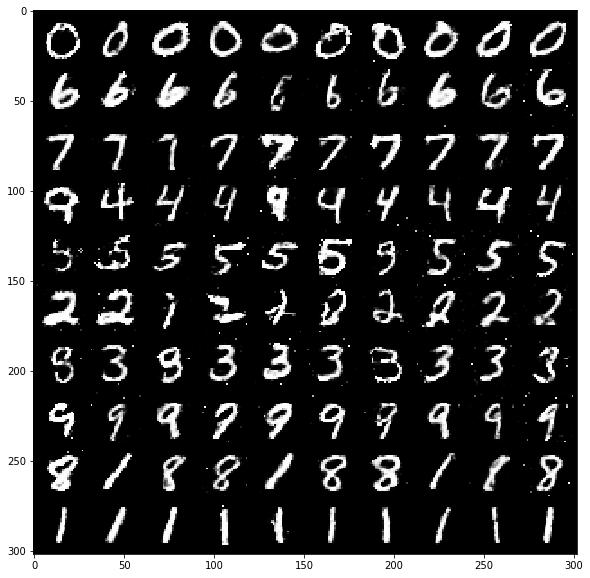

[Epoch 230/500] [Batch 599/600] [D loss: 6.026895] [G loss: 9.895146] [C loss 1: 0.026693] [C loss 2: 0.000431] 	 Time Interv: 29.560080


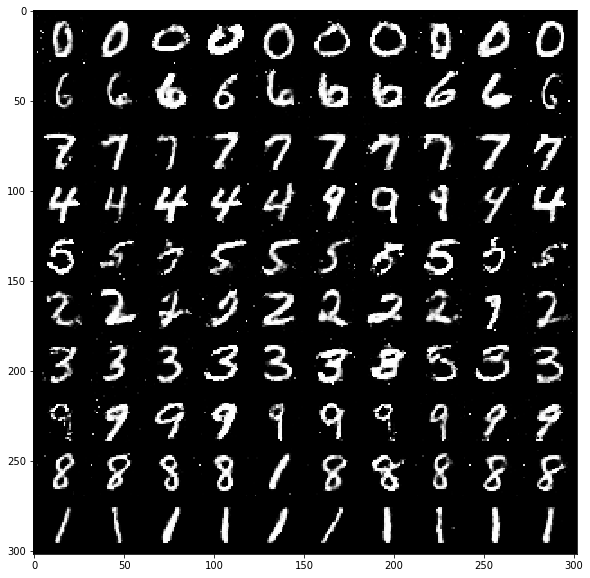

[Epoch 232/500] [Batch 599/600] [D loss: 6.058598] [G loss: 9.868442] [C loss 1: 0.024403] [C loss 2: 0.000435] 	 Time Interv: 28.552536


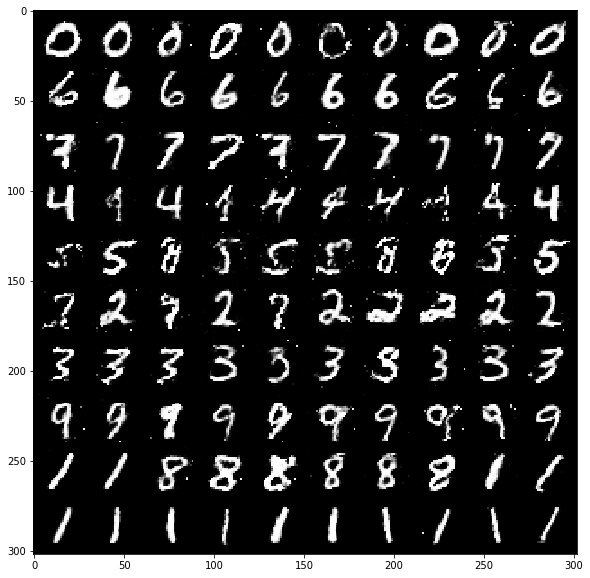

[Epoch 234/500] [Batch 599/600] [D loss: 6.074488] [G loss: 9.850332] [C loss 1: 0.024383] [C loss 2: 0.000380] 	 Time Interv: 28.642725


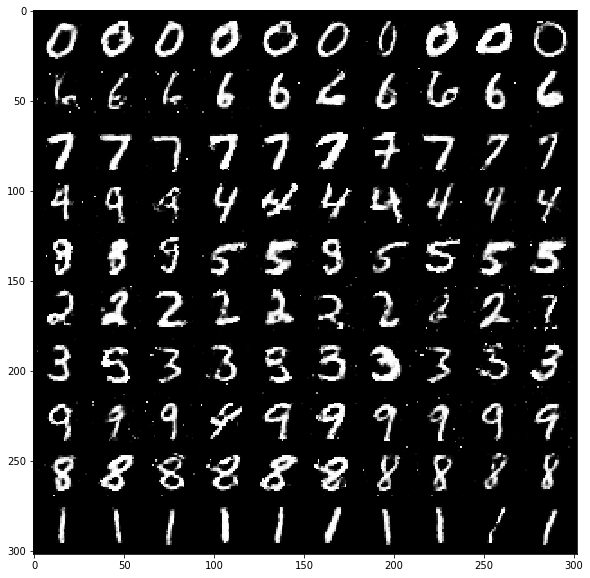

[Epoch 236/500] [Batch 599/600] [D loss: 6.049553] [G loss: 9.800670] [C loss 1: 0.025101] [C loss 2: 0.000567] 	 Time Interv: 28.870683


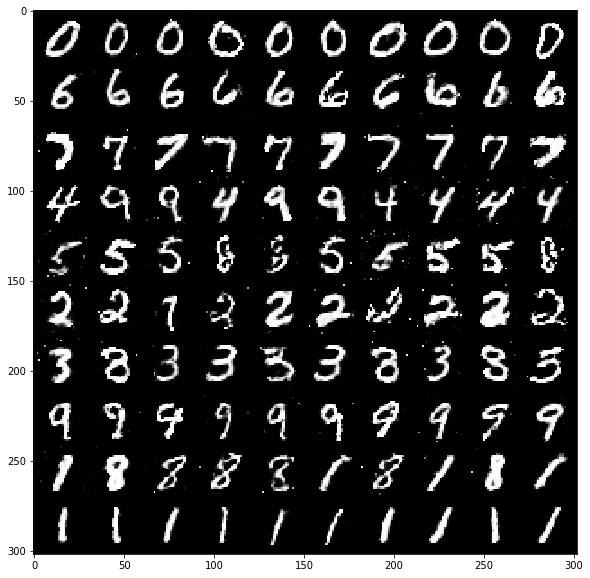

[Epoch 238/500] [Batch 599/600] [D loss: 6.071368] [G loss: 9.838037] [C loss 1: 0.026795] [C loss 2: 0.000442] 	 Time Interv: 29.692408


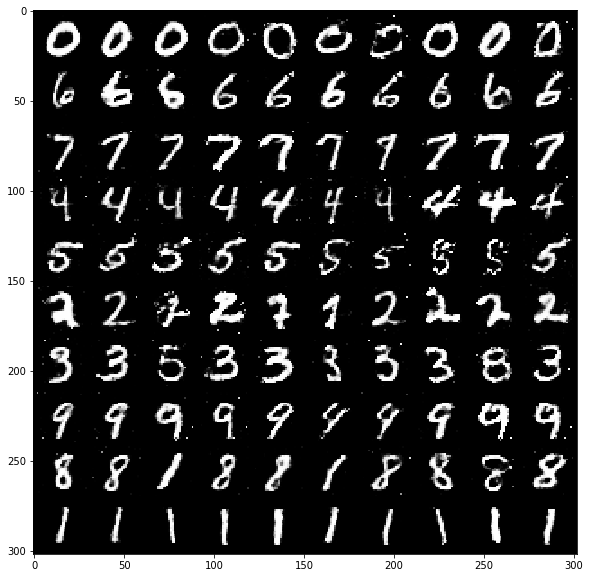

[Epoch 240/500] [Batch 599/600] [D loss: 5.934754] [G loss: 10.073188] [C loss 1: 0.027683] [C loss 2: 0.000443] 	 Time Interv: 29.121624


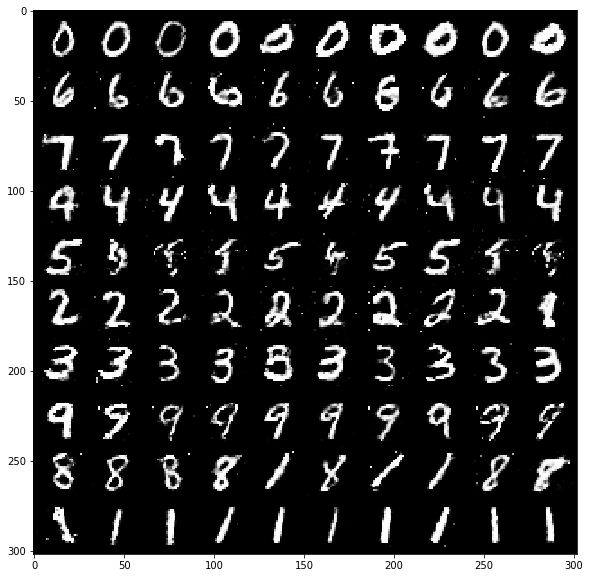

[Epoch 242/500] [Batch 599/600] [D loss: 6.030412] [G loss: 9.946076] [C loss 1: 0.028913] [C loss 2: 0.000515] 	 Time Interv: 28.626437


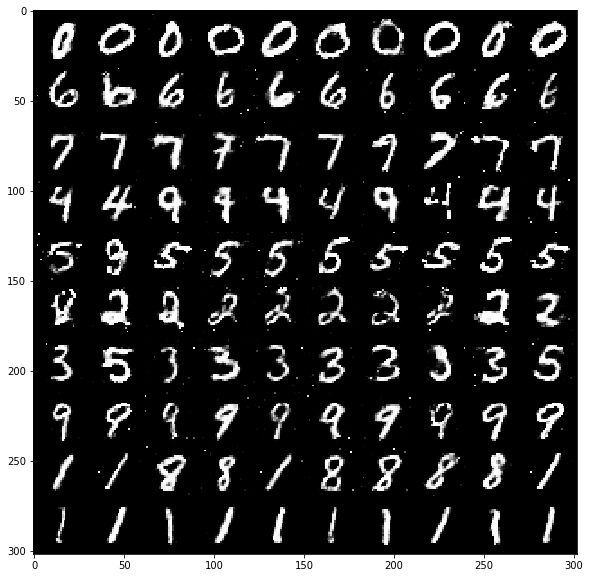

[Epoch 244/500] [Batch 599/600] [D loss: 5.944387] [G loss: 10.128276] [C loss 1: 0.025626] [C loss 2: 0.000569] 	 Time Interv: 29.244951


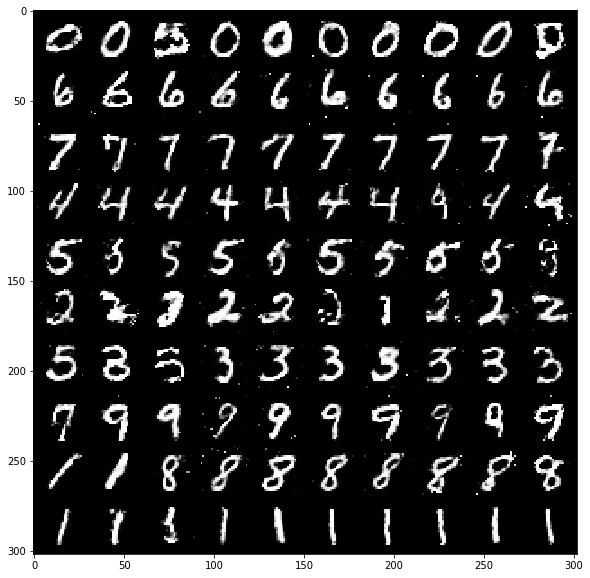

[Epoch 246/500] [Batch 599/600] [D loss: 6.006228] [G loss: 10.024327] [C loss 1: 0.023270] [C loss 2: 0.000424] 	 Time Interv: 28.966574


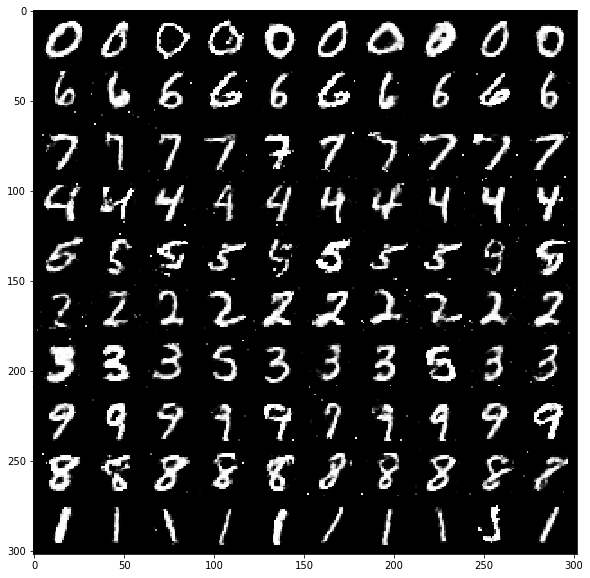

[Epoch 248/500] [Batch 599/600] [D loss: 6.026951] [G loss: 10.033483] [C loss 1: 0.022117] [C loss 2: 0.000276] 	 Time Interv: 29.800959


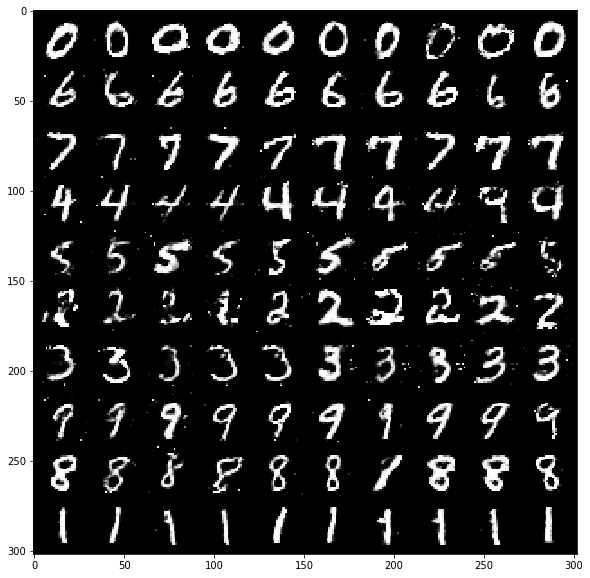

[Epoch 250/500] [Batch 599/600] [D loss: 6.051767] [G loss: 10.022498] [C loss 1: 0.021168] [C loss 2: 0.000295] 	 Time Interv: 30.559564


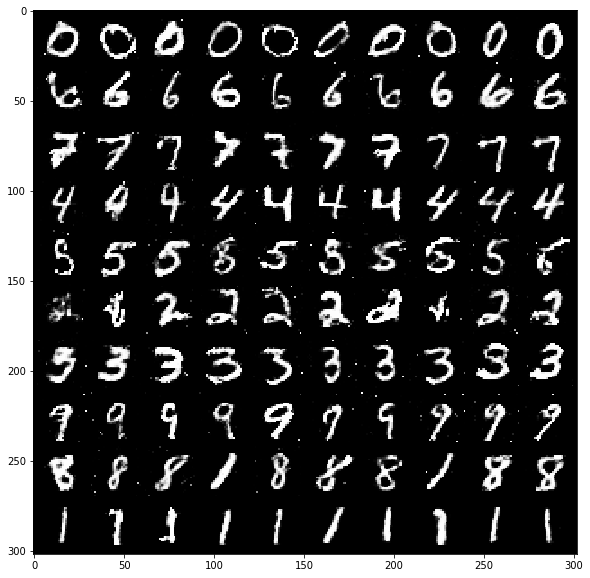

[Epoch 252/500] [Batch 599/600] [D loss: 5.998610] [G loss: 10.031216] [C loss 1: 0.025498] [C loss 2: 0.000281] 	 Time Interv: 29.259678


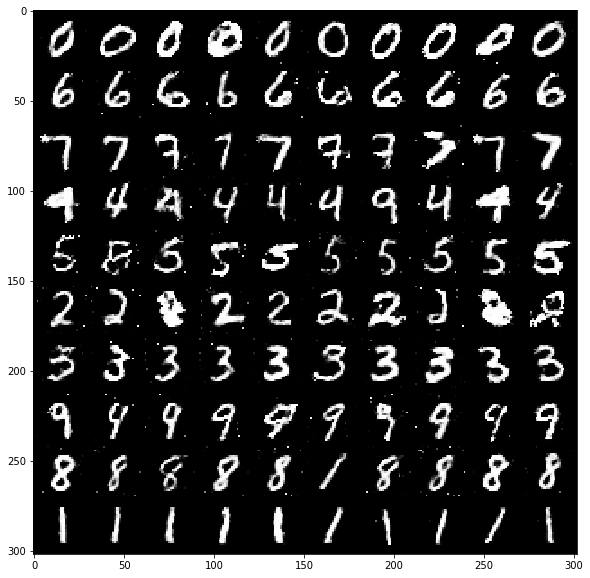

[Epoch 254/500] [Batch 599/600] [D loss: 6.017487] [G loss: 10.030914] [C loss 1: 0.022705] [C loss 2: 0.000416] 	 Time Interv: 28.733900


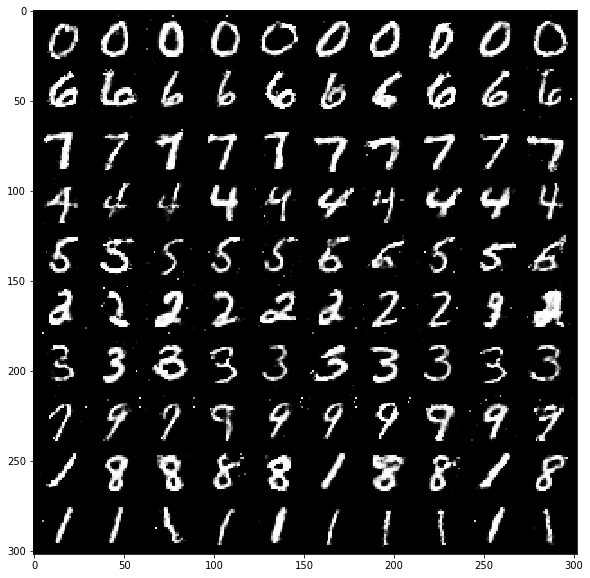

[Epoch 256/500] [Batch 599/600] [D loss: 6.000010] [G loss: 10.014707] [C loss 1: 0.022728] [C loss 2: 0.000306] 	 Time Interv: 29.091448


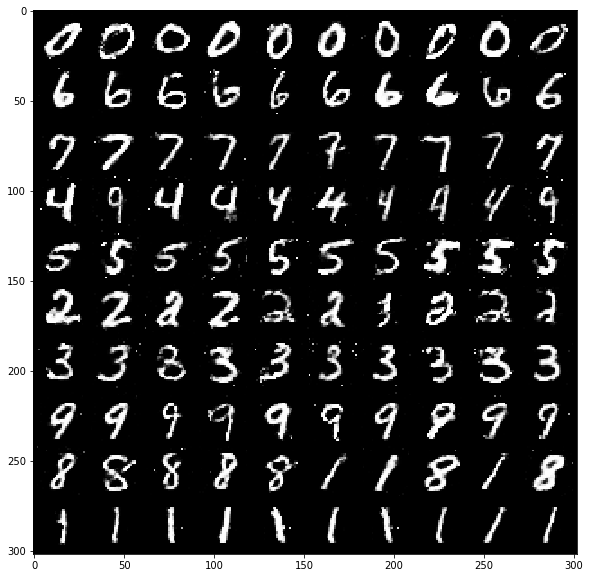

[Epoch 258/500] [Batch 599/600] [D loss: 5.963427] [G loss: 10.140855] [C loss 1: 0.025407] [C loss 2: 0.000297] 	 Time Interv: 29.756567


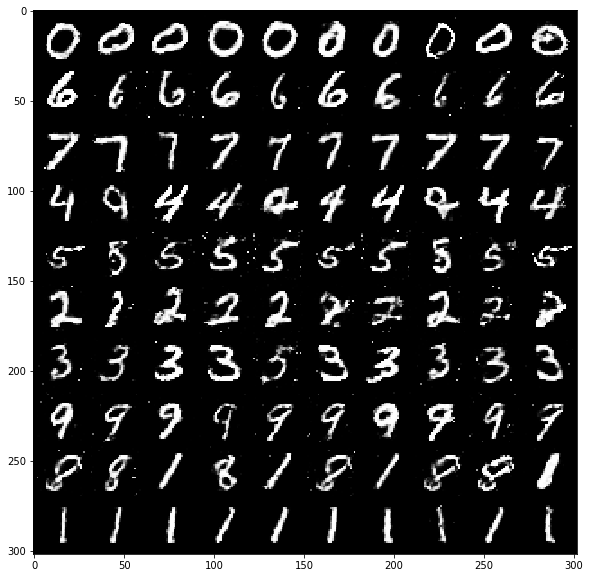

[Epoch 260/500] [Batch 599/600] [D loss: 6.005472] [G loss: 10.146562] [C loss 1: 0.027920] [C loss 2: 0.000409] 	 Time Interv: 29.239063


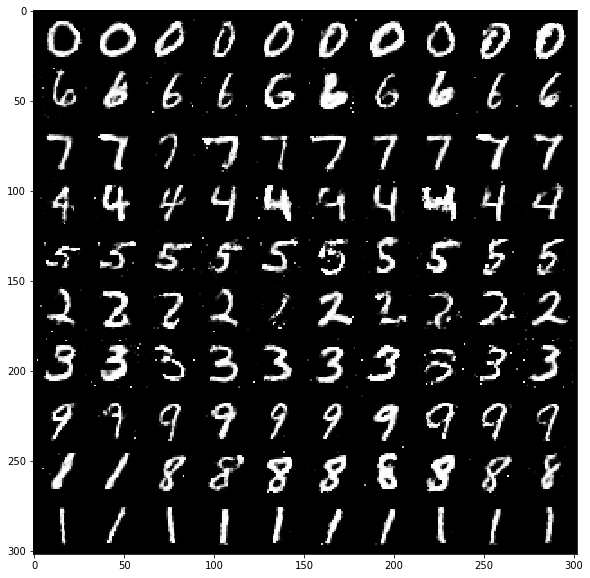

[Epoch 262/500] [Batch 599/600] [D loss: 5.959416] [G loss: 10.092507] [C loss 1: 0.024455] [C loss 2: 0.000340] 	 Time Interv: 29.340330


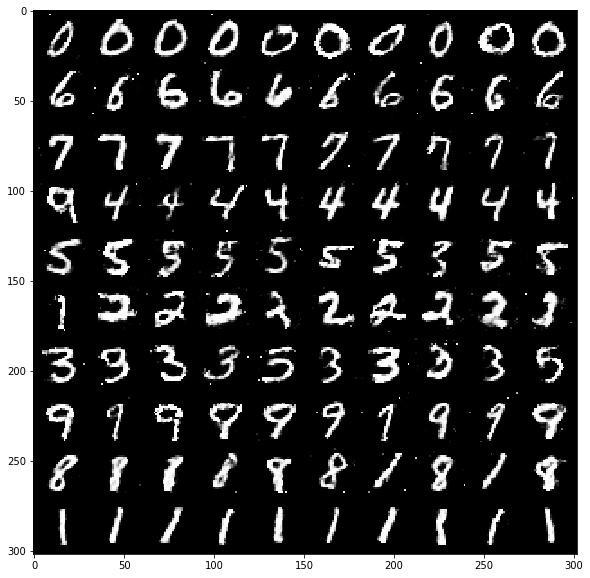

[Epoch 264/500] [Batch 599/600] [D loss: 5.962084] [G loss: 10.220968] [C loss 1: 0.026045] [C loss 2: 0.000488] 	 Time Interv: 29.466450


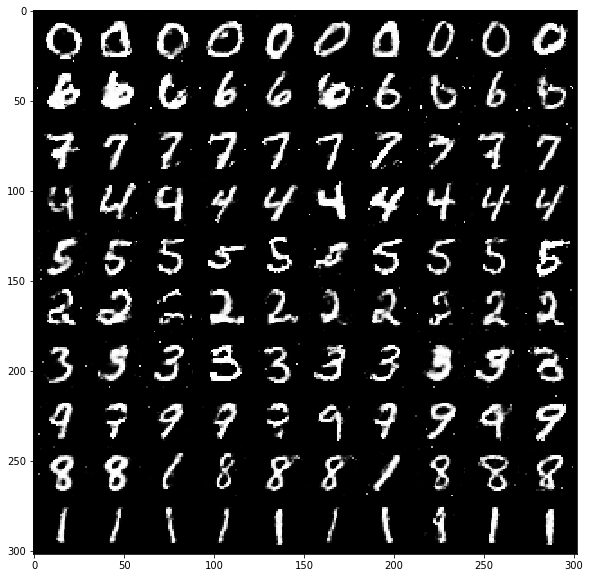

[Epoch 266/500] [Batch 599/600] [D loss: 5.974009] [G loss: 10.121528] [C loss 1: 0.021670] [C loss 2: 0.000352] 	 Time Interv: 29.172284


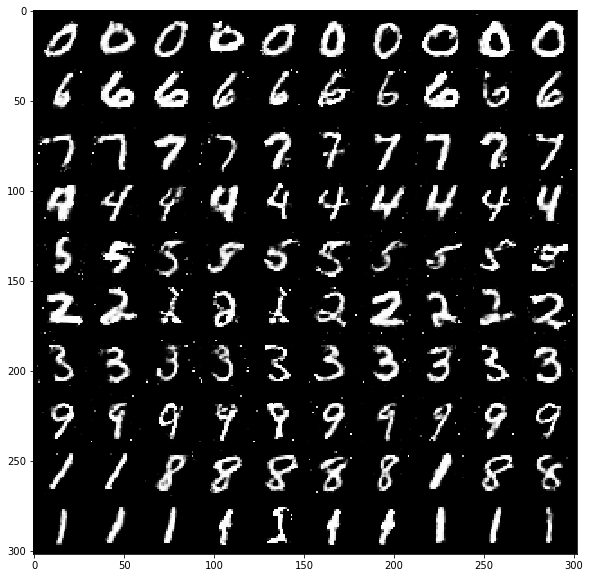

[Epoch 268/500] [Batch 599/600] [D loss: 5.969936] [G loss: 10.206392] [C loss 1: 0.025378] [C loss 2: 0.000339] 	 Time Interv: 29.079429


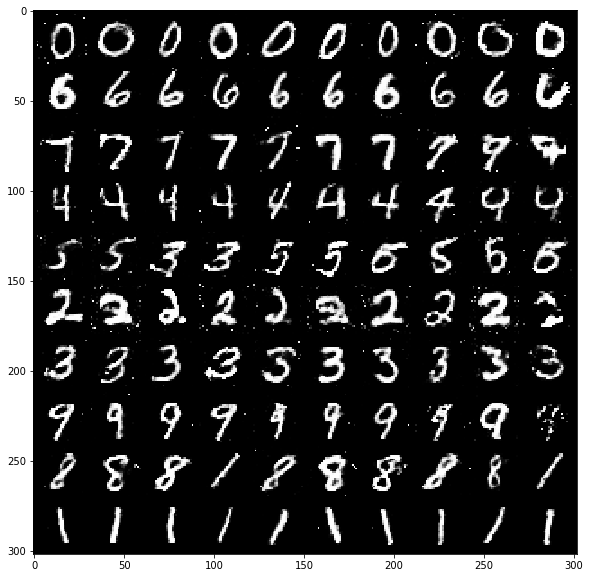

[Epoch 270/500] [Batch 599/600] [D loss: 5.984865] [G loss: 10.152207] [C loss 1: 0.024412] [C loss 2: 0.000289] 	 Time Interv: 29.970228


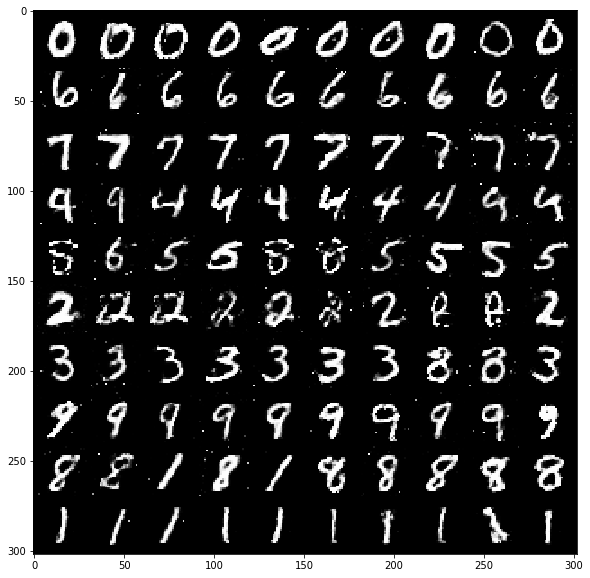

[Epoch 272/500] [Batch 599/600] [D loss: 5.936717] [G loss: 10.249179] [C loss 1: 0.020277] [C loss 2: 0.000259] 	 Time Interv: 26.674397


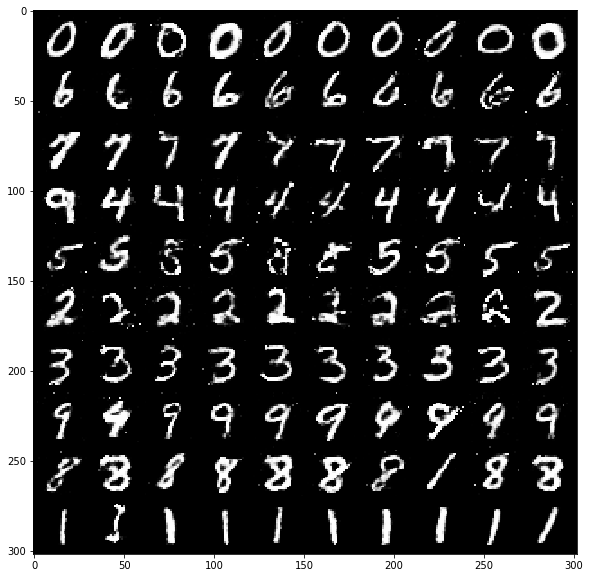

[Epoch 274/500] [Batch 599/600] [D loss: 5.973547] [G loss: 10.119815] [C loss 1: 0.024590] [C loss 2: 0.000273] 	 Time Interv: 24.782748


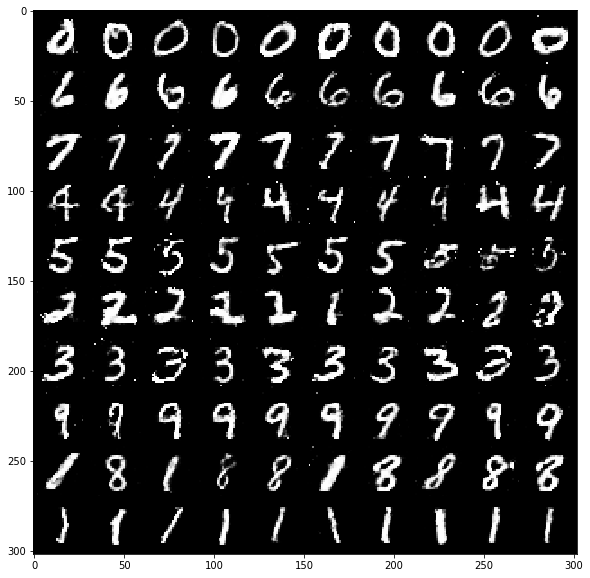

[Epoch 276/500] [Batch 599/600] [D loss: 5.912873] [G loss: 10.228014] [C loss 1: 0.025192] [C loss 2: 0.000432] 	 Time Interv: 24.905498


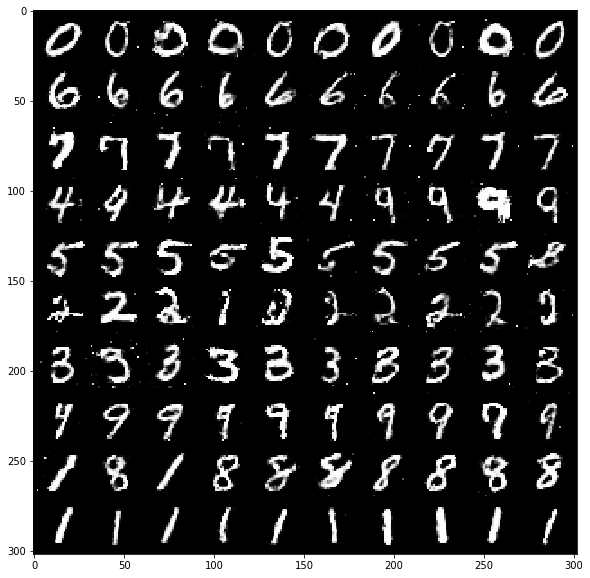

[Epoch 278/500] [Batch 599/600] [D loss: 5.965988] [G loss: 10.140917] [C loss 1: 0.024550] [C loss 2: 0.000382] 	 Time Interv: 24.794253


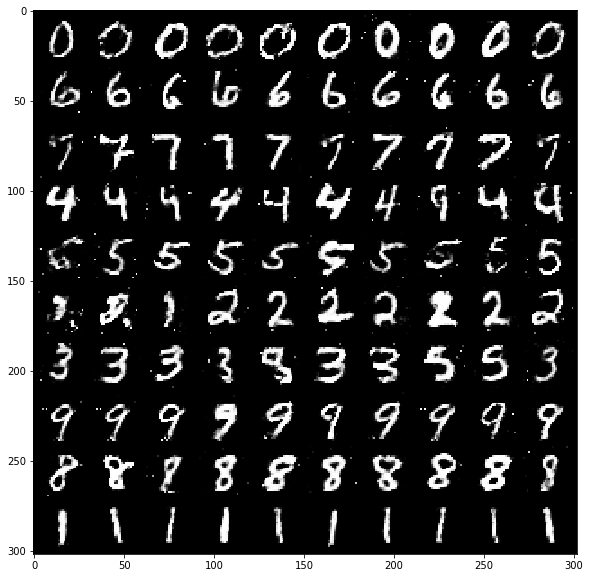

[Epoch 280/500] [Batch 599/600] [D loss: 5.967222] [G loss: 10.261575] [C loss 1: 0.029638] [C loss 2: 0.000570] 	 Time Interv: 24.537868


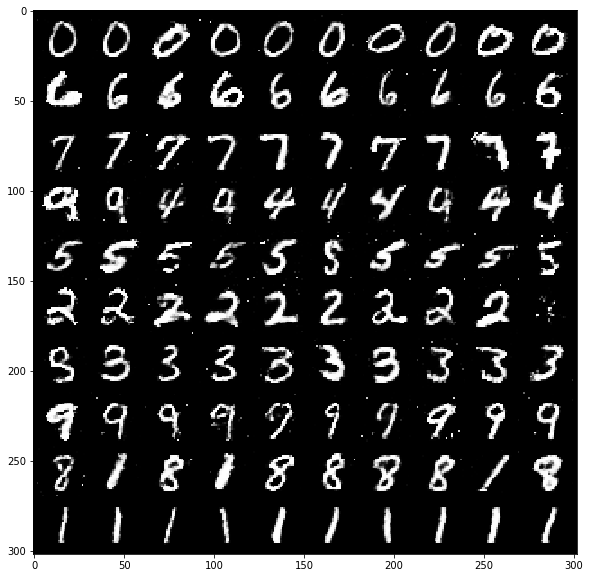

[Epoch 282/500] [Batch 599/600] [D loss: 5.946003] [G loss: 10.164902] [C loss 1: 0.022840] [C loss 2: 0.000346] 	 Time Interv: 24.874875


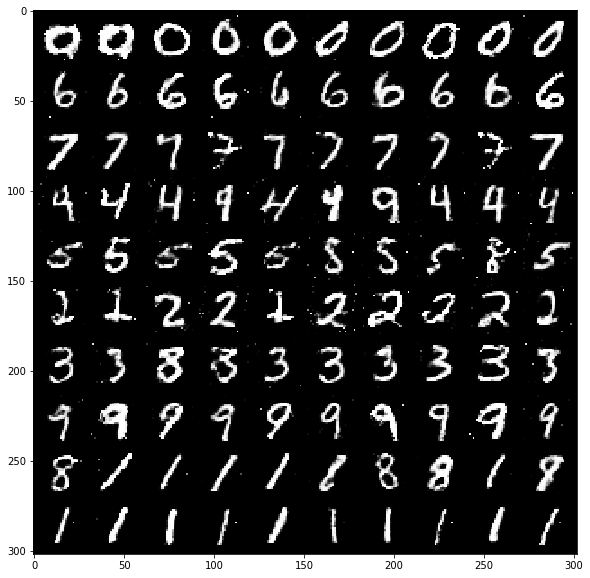

[Epoch 284/500] [Batch 599/600] [D loss: 5.924327] [G loss: 10.315796] [C loss 1: 0.030161] [C loss 2: 0.000380] 	 Time Interv: 26.042917


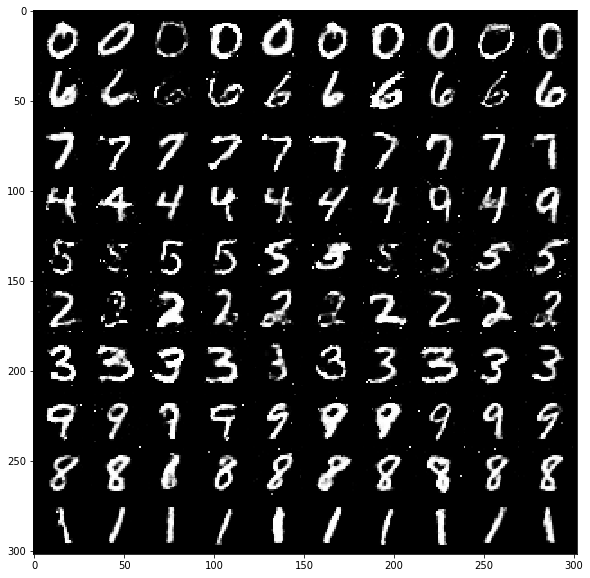

[Epoch 286/500] [Batch 599/600] [D loss: 5.876401] [G loss: 10.401449] [C loss 1: 0.029758] [C loss 2: 0.000511] 	 Time Interv: 25.951962


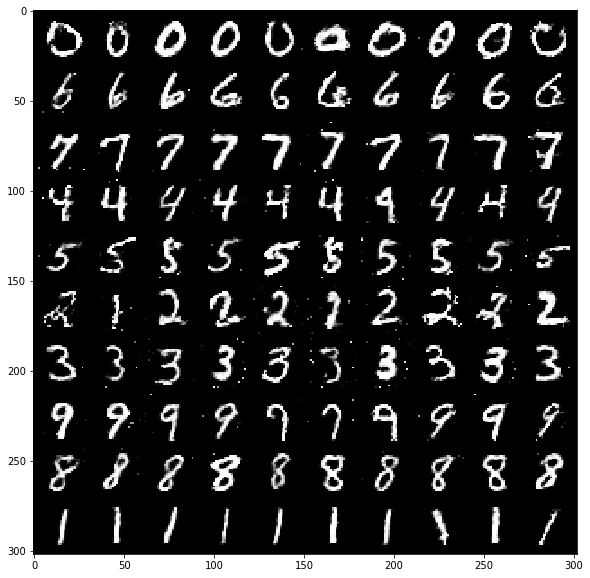

[Epoch 288/500] [Batch 599/600] [D loss: 5.985563] [G loss: 10.280055] [C loss 1: 0.022265] [C loss 2: 0.000265] 	 Time Interv: 24.862398


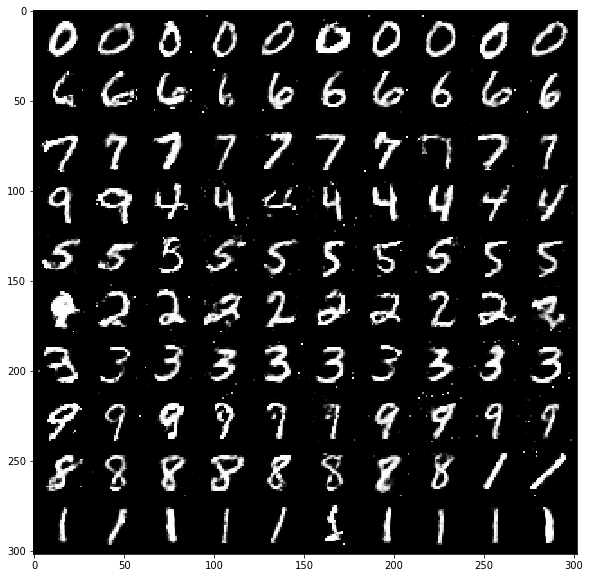

[Epoch 290/500] [Batch 599/600] [D loss: 5.923306] [G loss: 10.309909] [C loss 1: 0.027741] [C loss 2: 0.000587] 	 Time Interv: 24.737854


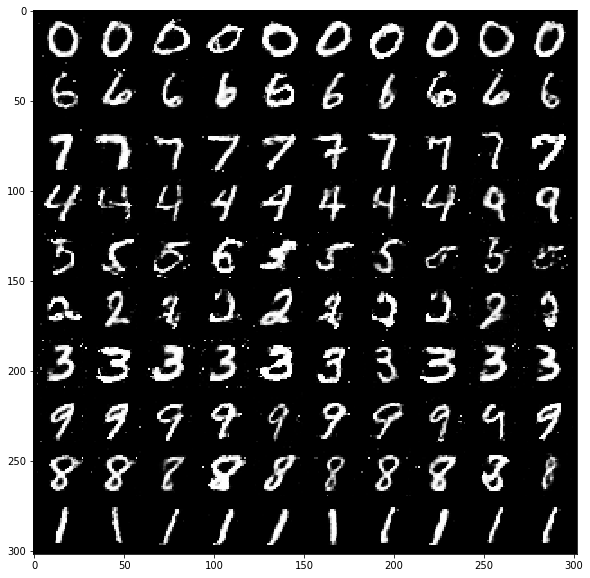

[Epoch 292/500] [Batch 599/600] [D loss: 5.952295] [G loss: 10.199314] [C loss 1: 0.025717] [C loss 2: 0.000234] 	 Time Interv: 24.872183


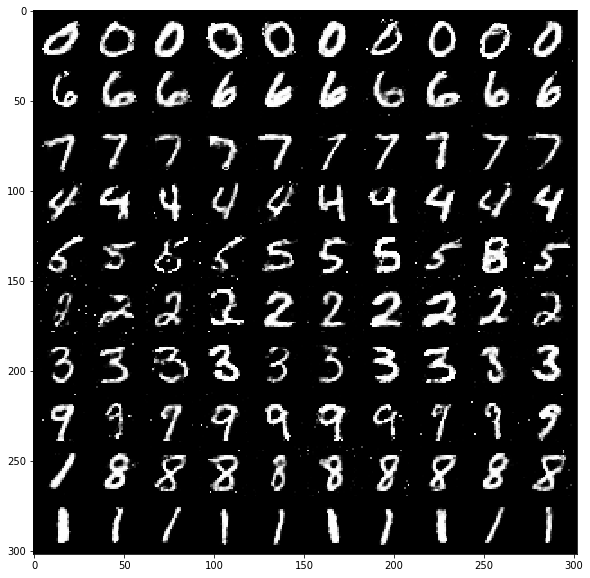

[Epoch 294/500] [Batch 599/600] [D loss: 6.021646] [G loss: 10.099009] [C loss 1: 0.025675] [C loss 2: 0.000288] 	 Time Interv: 25.290573


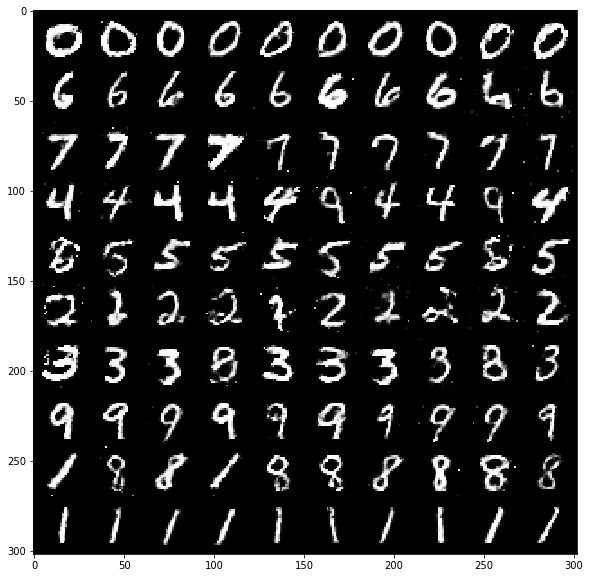

[Epoch 296/500] [Batch 599/600] [D loss: 5.911533] [G loss: 10.362975] [C loss 1: 0.029372] [C loss 2: 0.000321] 	 Time Interv: 24.496637


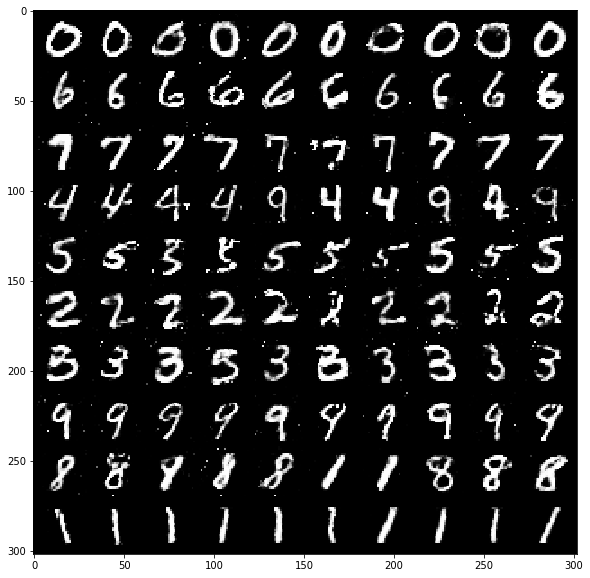

[Epoch 298/500] [Batch 599/600] [D loss: 5.914334] [G loss: 10.295819] [C loss 1: 0.023764] [C loss 2: 0.000299] 	 Time Interv: 24.962415


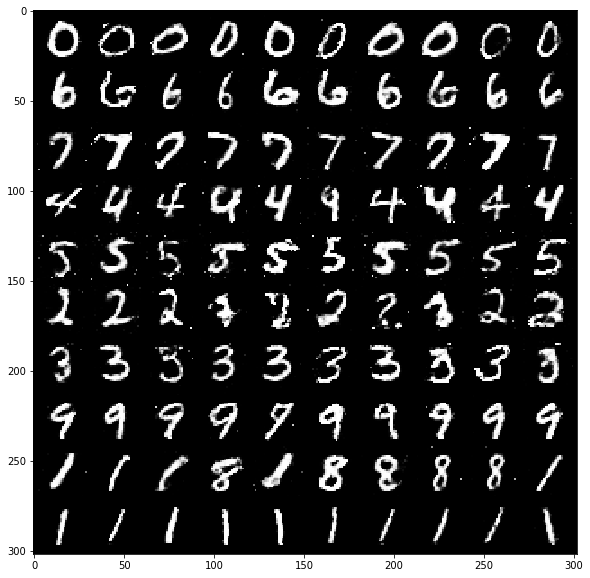

[Epoch 300/500] [Batch 599/600] [D loss: 5.934552] [G loss: 10.305266] [C loss 1: 0.024007] [C loss 2: 0.000329] 	 Time Interv: 24.605914


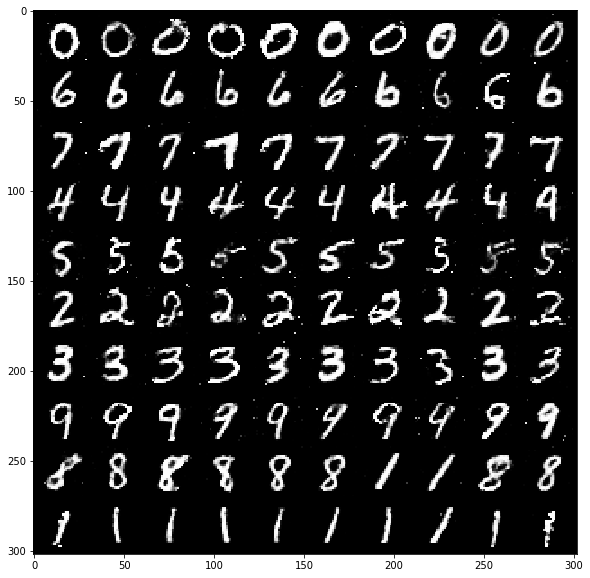

[Epoch 302/500] [Batch 599/600] [D loss: 5.907596] [G loss: 10.369395] [C loss 1: 0.025225] [C loss 2: 0.000241] 	 Time Interv: 24.783881


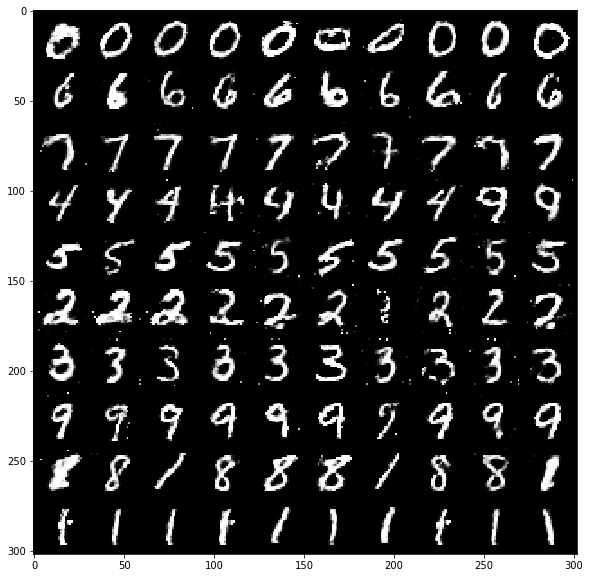

[Epoch 304/500] [Batch 599/600] [D loss: 5.888986] [G loss: 10.407913] [C loss 1: 0.032077] [C loss 2: 0.000439] 	 Time Interv: 25.328953


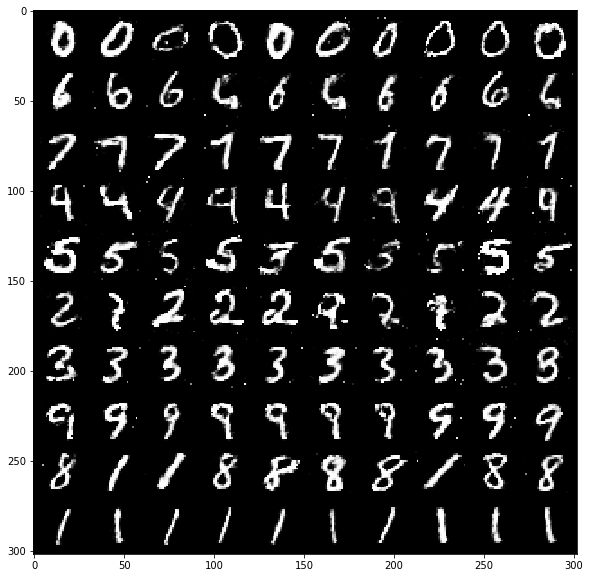

[Epoch 306/500] [Batch 599/600] [D loss: 5.941461] [G loss: 10.382115] [C loss 1: 0.023827] [C loss 2: 0.000257] 	 Time Interv: 24.638126


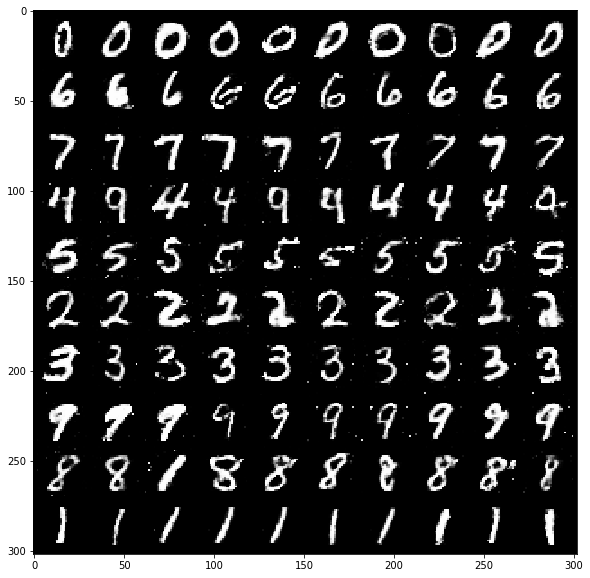

[Epoch 308/500] [Batch 599/600] [D loss: 5.893685] [G loss: 10.486744] [C loss 1: 0.030229] [C loss 2: 0.000452] 	 Time Interv: 25.281868


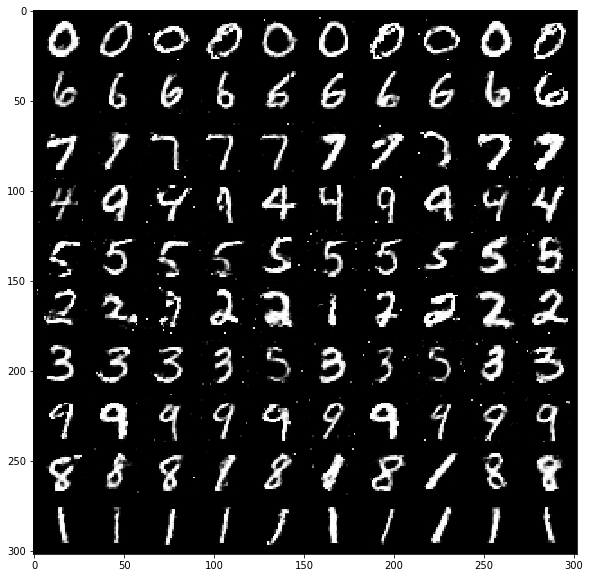

[Epoch 310/500] [Batch 599/600] [D loss: 5.879093] [G loss: 10.480683] [C loss 1: 0.027682] [C loss 2: 0.000211] 	 Time Interv: 24.538785


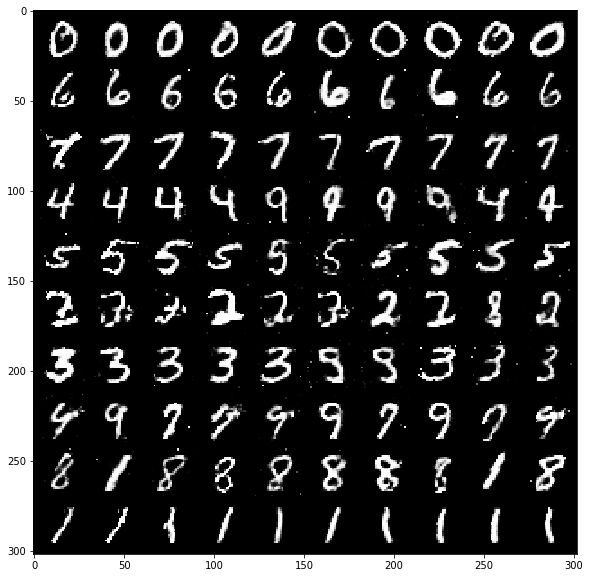

[Epoch 312/500] [Batch 599/600] [D loss: 5.920631] [G loss: 10.395905] [C loss 1: 0.026886] [C loss 2: 0.000408] 	 Time Interv: 25.087526


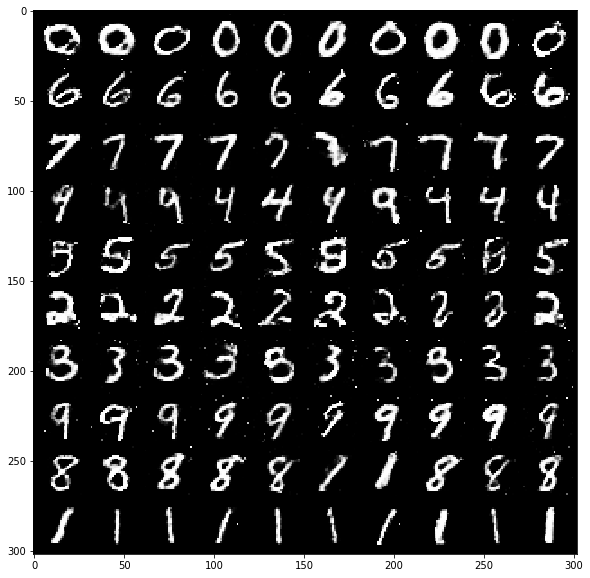

[Epoch 314/500] [Batch 599/600] [D loss: 5.956272] [G loss: 10.299228] [C loss 1: 0.021338] [C loss 2: 0.000284] 	 Time Interv: 24.960381


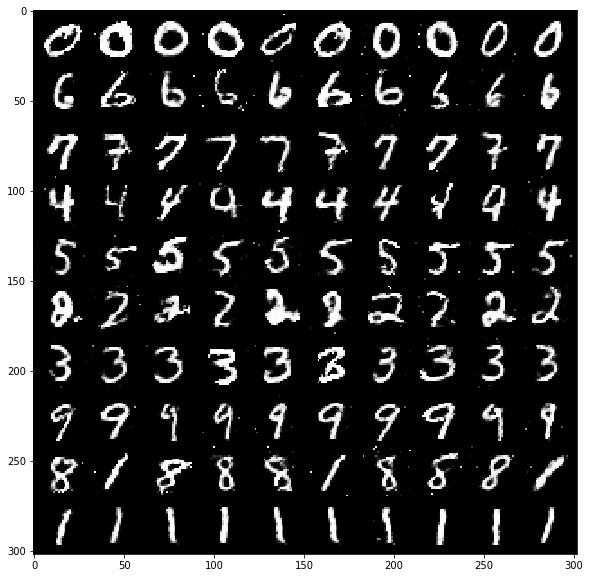

[Epoch 316/500] [Batch 599/600] [D loss: 5.925898] [G loss: 10.393168] [C loss 1: 0.025256] [C loss 2: 0.000340] 	 Time Interv: 24.913802


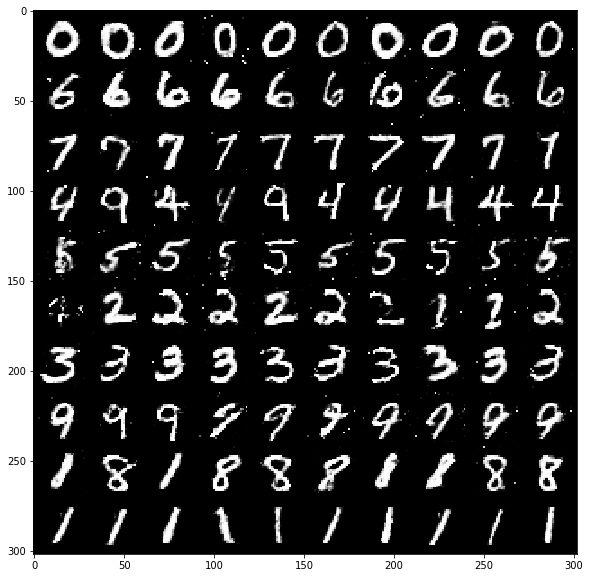

[Epoch 318/500] [Batch 599/600] [D loss: 5.896589] [G loss: 10.363191] [C loss 1: 0.031746] [C loss 2: 0.000328] 	 Time Interv: 24.532734


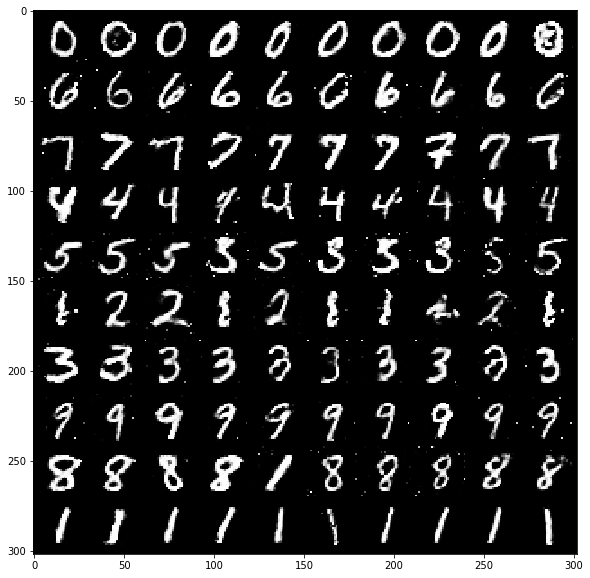

[Epoch 320/500] [Batch 599/600] [D loss: 5.926698] [G loss: 10.399818] [C loss 1: 0.032759] [C loss 2: 0.000378] 	 Time Interv: 25.014722


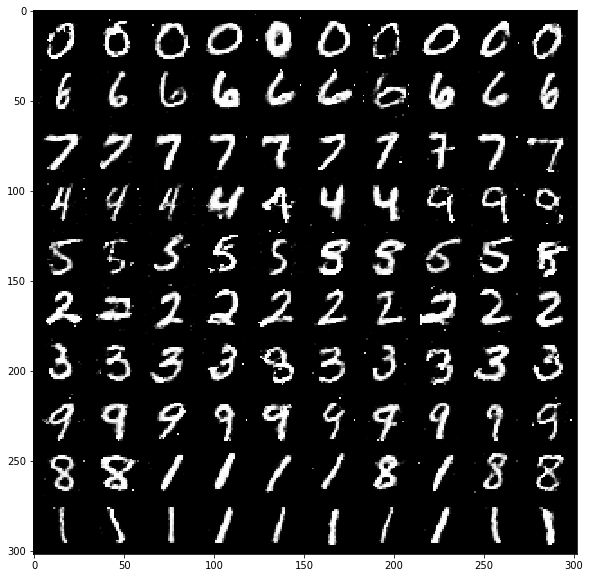

[Epoch 322/500] [Batch 599/600] [D loss: 5.865113] [G loss: 10.414323] [C loss 1: 0.031498] [C loss 2: 0.000302] 	 Time Interv: 24.995499


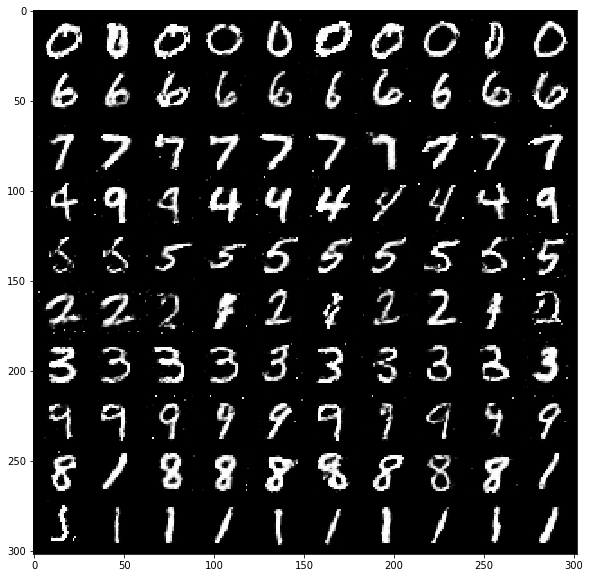

[Epoch 324/500] [Batch 599/600] [D loss: 5.922249] [G loss: 10.430891] [C loss 1: 0.030062] [C loss 2: 0.000334] 	 Time Interv: 24.724696


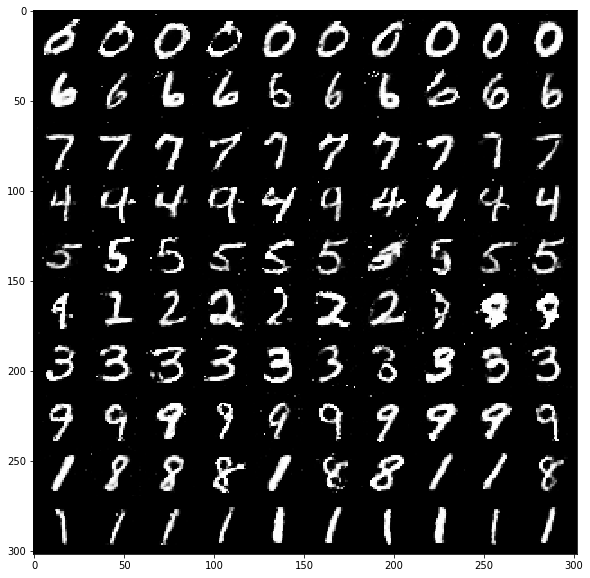

[Epoch 326/500] [Batch 599/600] [D loss: 5.896782] [G loss: 10.460293] [C loss 1: 0.028238] [C loss 2: 0.000215] 	 Time Interv: 25.448127


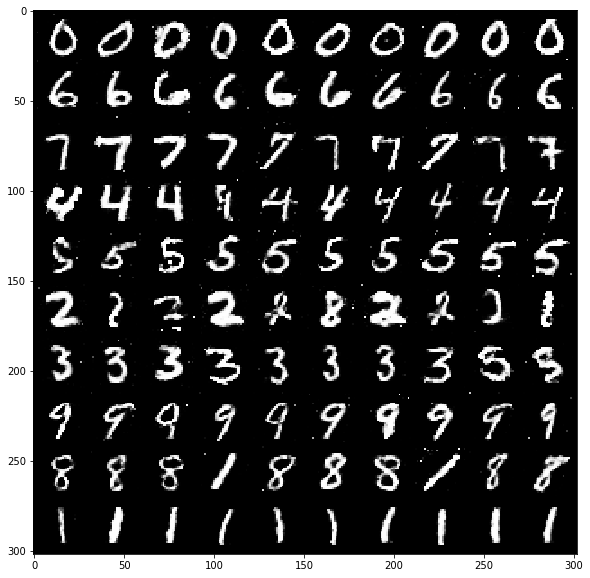

[Epoch 328/500] [Batch 599/600] [D loss: 5.805699] [G loss: 10.596137] [C loss 1: 0.032039] [C loss 2: 0.000288] 	 Time Interv: 24.944574


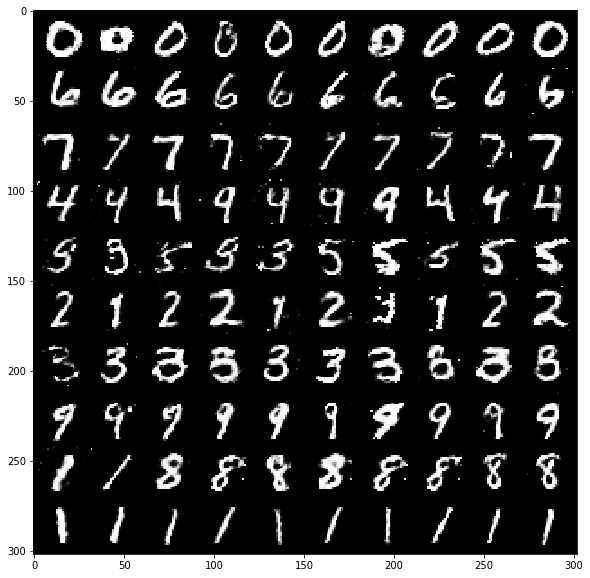

[Epoch 330/500] [Batch 599/600] [D loss: 5.849820] [G loss: 10.605683] [C loss 1: 0.029496] [C loss 2: 0.000413] 	 Time Interv: 25.134215


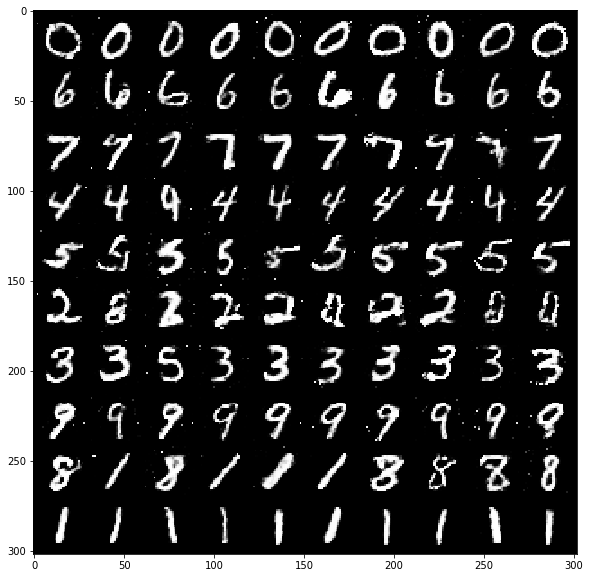

[Epoch 332/500] [Batch 599/600] [D loss: 5.841047] [G loss: 10.555253] [C loss 1: 0.029531] [C loss 2: 0.000336] 	 Time Interv: 24.532304


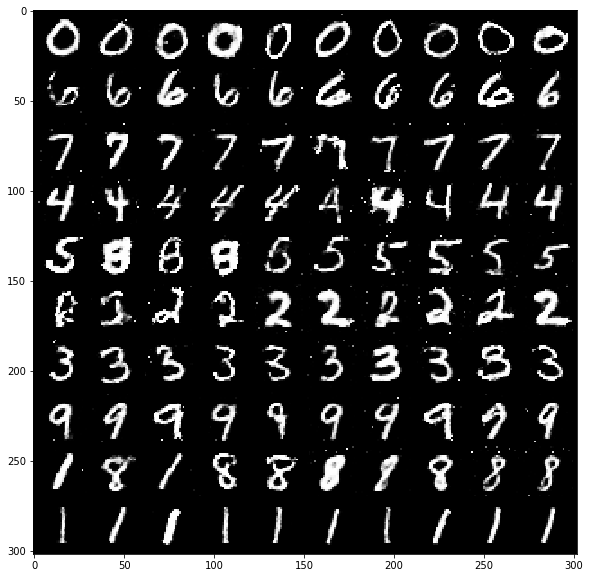

[Epoch 334/500] [Batch 599/600] [D loss: 5.921343] [G loss: 10.369810] [C loss 1: 0.029598] [C loss 2: 0.000445] 	 Time Interv: 24.787286


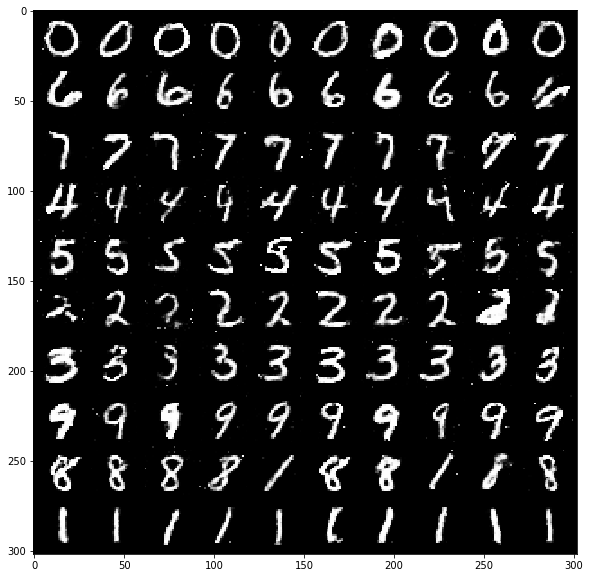

[Epoch 336/500] [Batch 599/600] [D loss: 5.887102] [G loss: 10.507729] [C loss 1: 0.027177] [C loss 2: 0.000379] 	 Time Interv: 25.723067


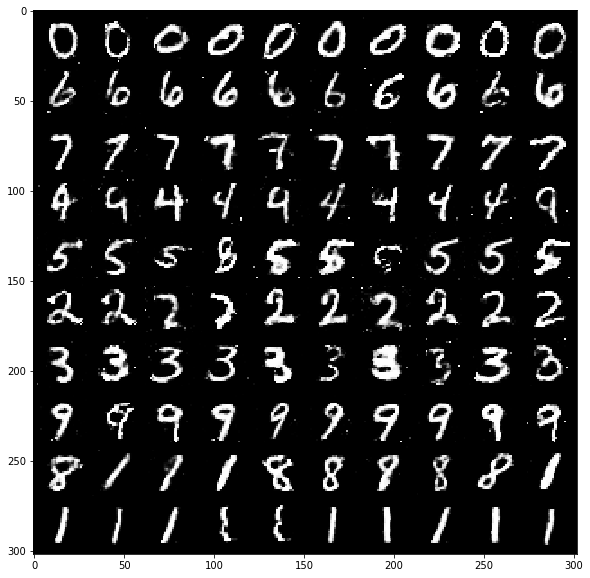

[Epoch 338/500] [Batch 599/600] [D loss: 5.846571] [G loss: 10.591179] [C loss 1: 0.028431] [C loss 2: 0.000260] 	 Time Interv: 24.712377


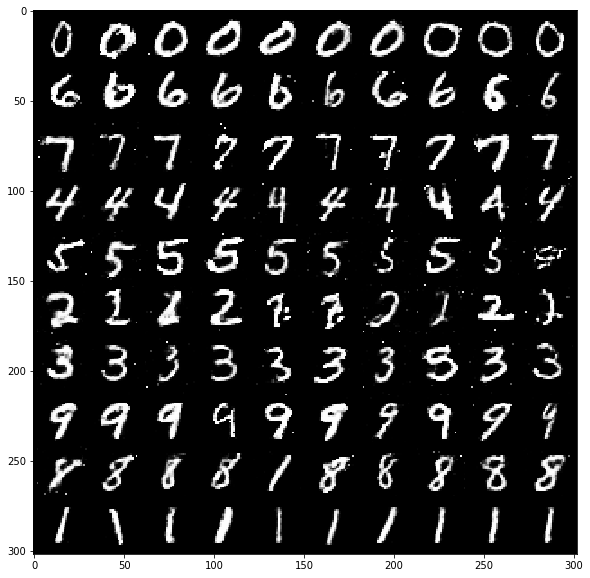

[Epoch 340/500] [Batch 599/600] [D loss: 5.871956] [G loss: 10.581751] [C loss 1: 0.026528] [C loss 2: 0.000259] 	 Time Interv: 24.396527


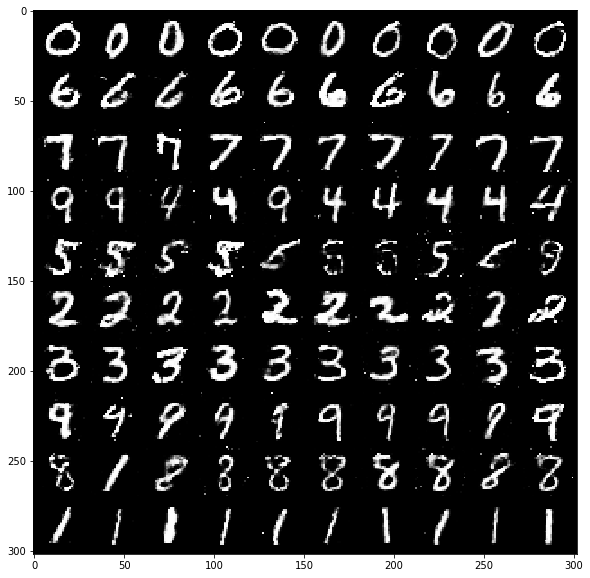

[Epoch 342/500] [Batch 599/600] [D loss: 5.807150] [G loss: 10.580261] [C loss 1: 0.033217] [C loss 2: 0.000354] 	 Time Interv: 24.536702


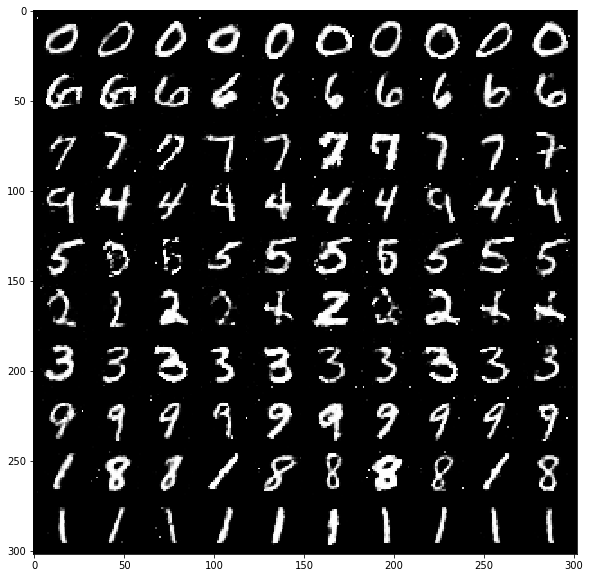

[Epoch 344/500] [Batch 599/600] [D loss: 5.914231] [G loss: 10.512161] [C loss 1: 0.029718] [C loss 2: 0.000302] 	 Time Interv: 24.648603


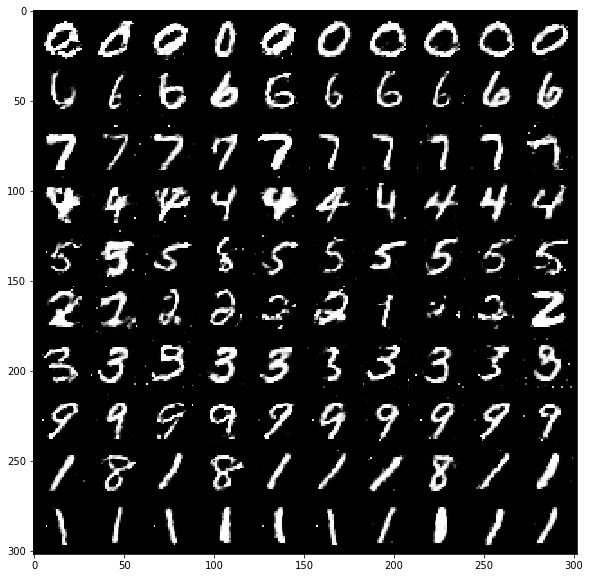

[Epoch 346/500] [Batch 599/600] [D loss: 5.816455] [G loss: 10.615816] [C loss 1: 0.029533] [C loss 2: 0.000316] 	 Time Interv: 24.944796


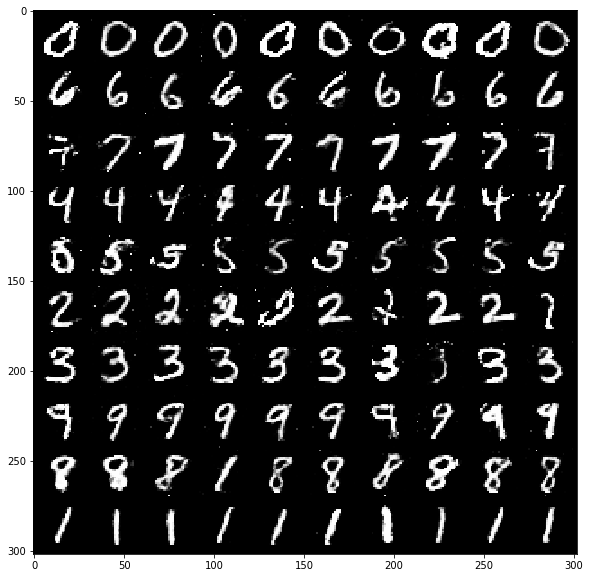

[Epoch 348/500] [Batch 599/600] [D loss: 5.878331] [G loss: 10.462639] [C loss 1: 0.029269] [C loss 2: 0.000218] 	 Time Interv: 25.356936


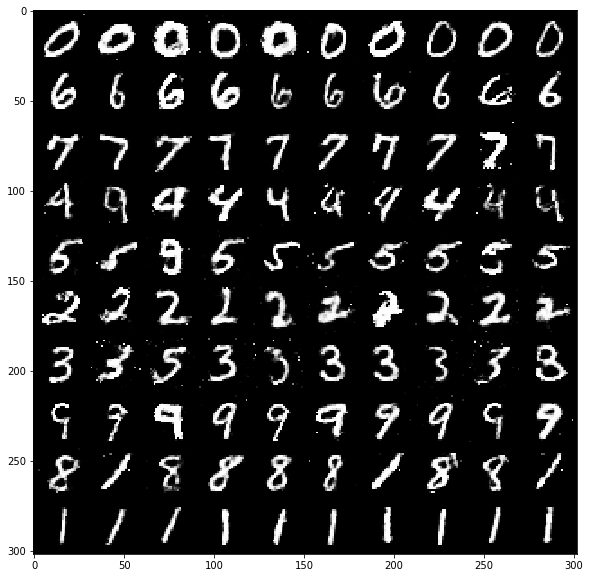

[Epoch 350/500] [Batch 599/600] [D loss: 5.821996] [G loss: 10.666743] [C loss 1: 0.033208] [C loss 2: 0.000334] 	 Time Interv: 26.219752


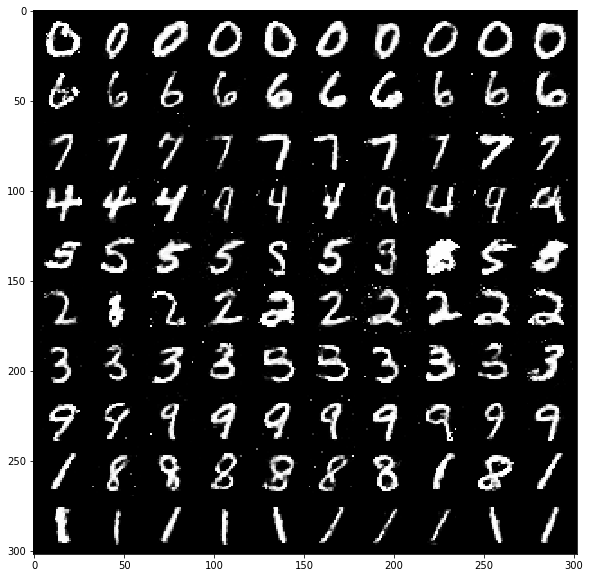

[Epoch 352/500] [Batch 599/600] [D loss: 5.827057] [G loss: 10.619827] [C loss 1: 0.028382] [C loss 2: 0.000332] 	 Time Interv: 24.898837


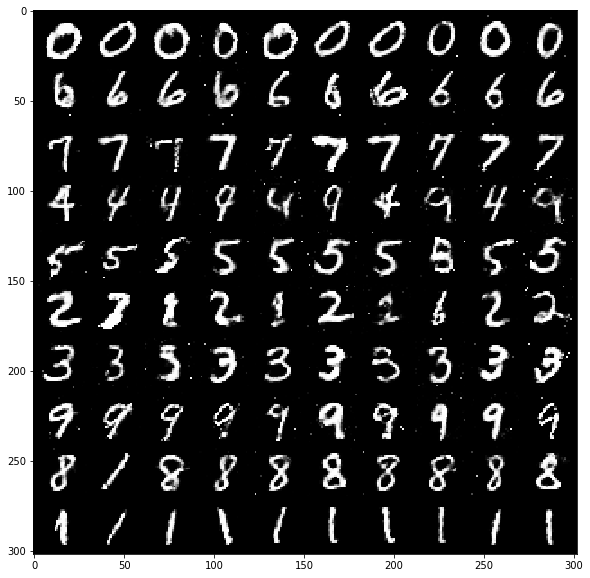

[Epoch 354/500] [Batch 599/600] [D loss: 5.847303] [G loss: 10.628692] [C loss 1: 0.034207] [C loss 2: 0.000448] 	 Time Interv: 25.002879


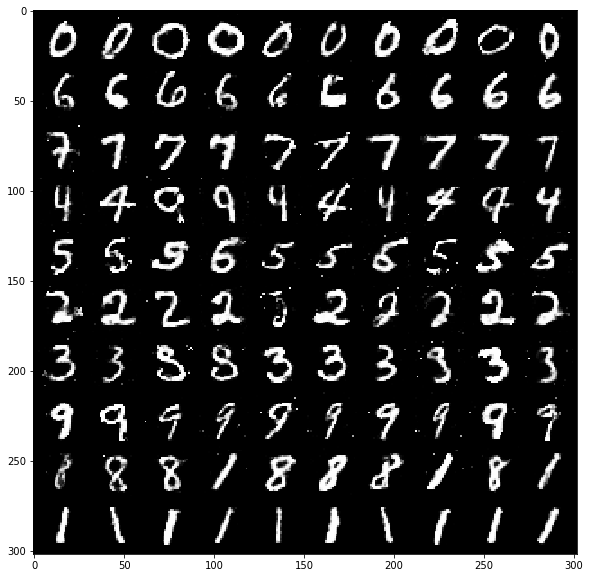

[Epoch 356/500] [Batch 599/600] [D loss: 5.890769] [G loss: 10.540718] [C loss 1: 0.028868] [C loss 2: 0.000302] 	 Time Interv: 24.923252


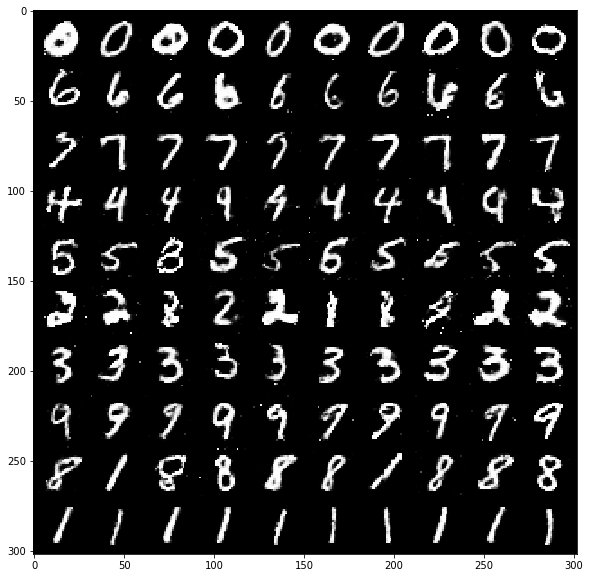

[Epoch 358/500] [Batch 599/600] [D loss: 5.884586] [G loss: 10.503624] [C loss 1: 0.029703] [C loss 2: 0.000349] 	 Time Interv: 24.991029


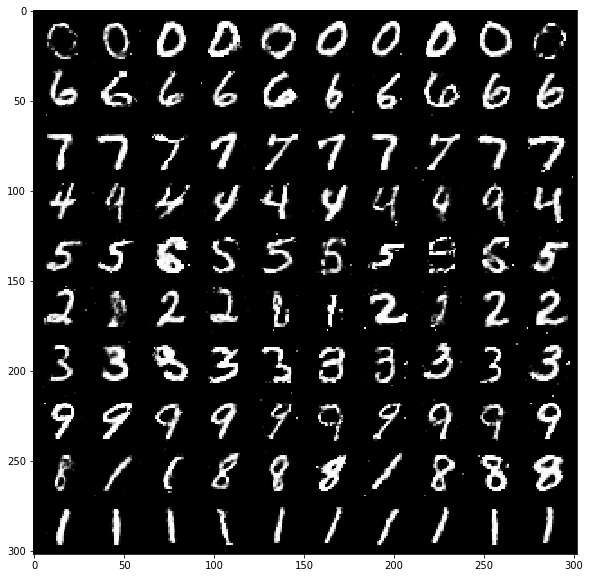

[Epoch 360/500] [Batch 599/600] [D loss: 5.906388] [G loss: 10.593267] [C loss 1: 0.032793] [C loss 2: 0.000241] 	 Time Interv: 25.512887


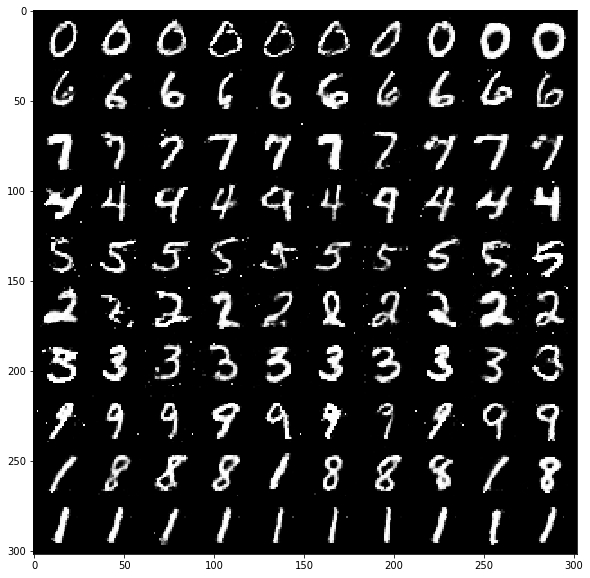

[Epoch 362/500] [Batch 599/600] [D loss: 5.873728] [G loss: 10.626914] [C loss 1: 0.030066] [C loss 2: 0.000226] 	 Time Interv: 24.827354


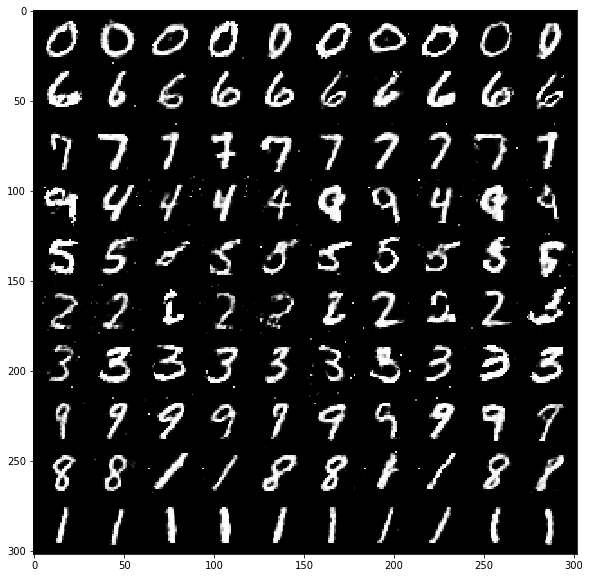

[Epoch 364/500] [Batch 599/600] [D loss: 5.866611] [G loss: 10.534171] [C loss 1: 0.035234] [C loss 2: 0.000288] 	 Time Interv: 24.650179


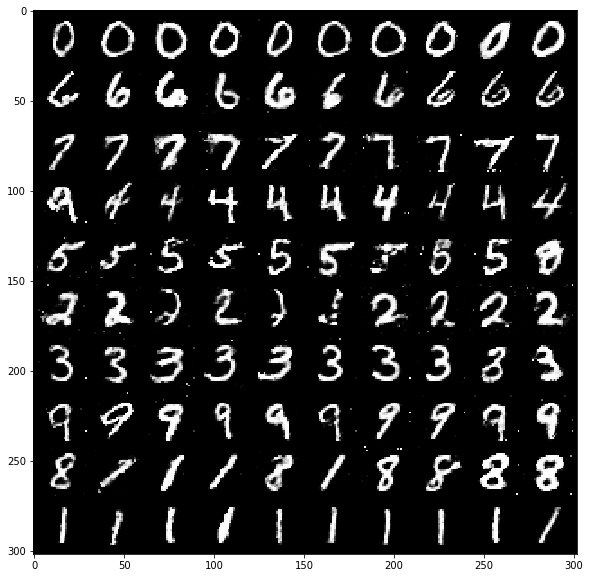

[Epoch 366/500] [Batch 599/600] [D loss: 5.834896] [G loss: 10.637141] [C loss 1: 0.035282] [C loss 2: 0.000454] 	 Time Interv: 25.519621


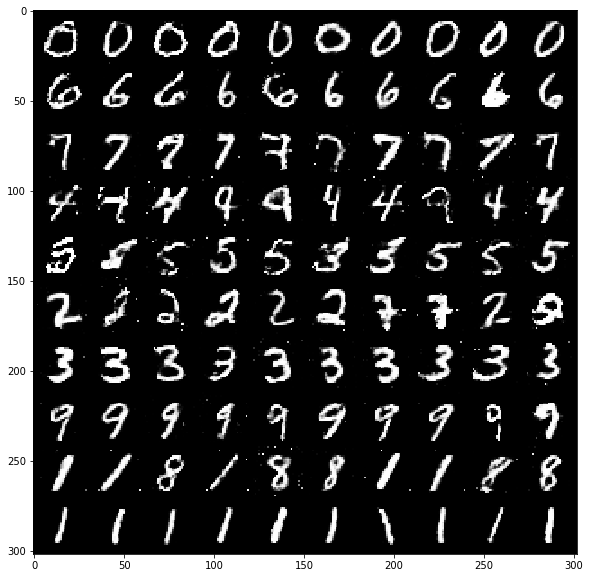

[Epoch 368/500] [Batch 599/600] [D loss: 5.848930] [G loss: 10.645999] [C loss 1: 0.028753] [C loss 2: 0.000239] 	 Time Interv: 24.474094


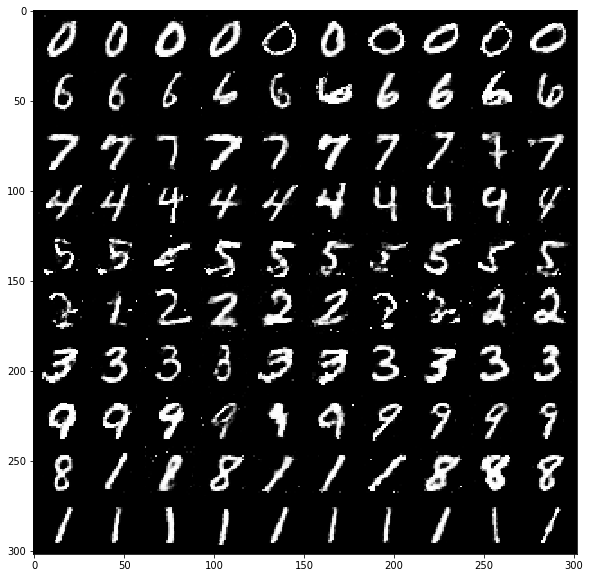

[Epoch 370/500] [Batch 599/600] [D loss: 5.839843] [G loss: 10.654463] [C loss 1: 0.034287] [C loss 2: 0.000334] 	 Time Interv: 24.662349


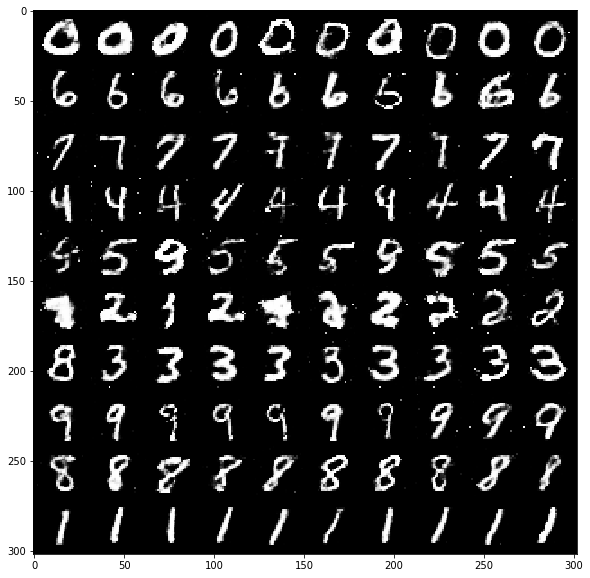

[Epoch 372/500] [Batch 599/600] [D loss: 5.866566] [G loss: 10.649714] [C loss 1: 0.028021] [C loss 2: 0.000260] 	 Time Interv: 24.499505


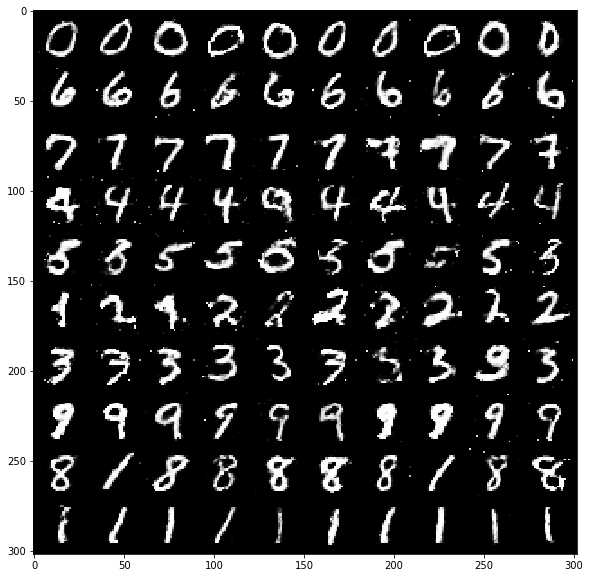

[Epoch 374/500] [Batch 599/600] [D loss: 5.758543] [G loss: 10.785733] [C loss 1: 0.033361] [C loss 2: 0.000289] 	 Time Interv: 24.576984


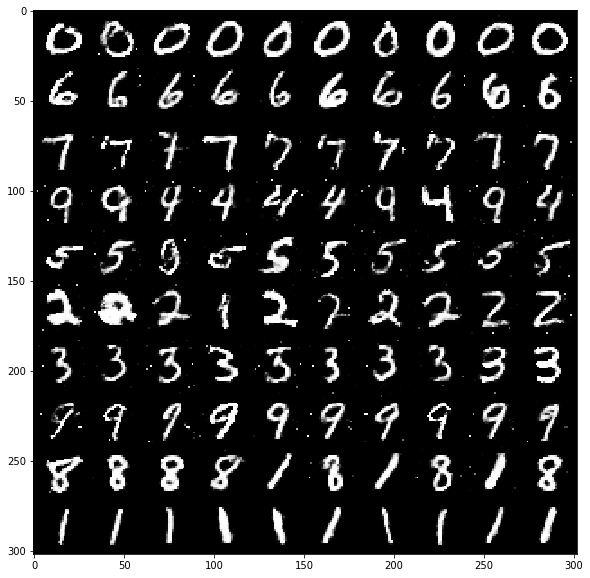

[Epoch 376/500] [Batch 599/600] [D loss: 5.783127] [G loss: 10.819895] [C loss 1: 0.036201] [C loss 2: 0.000337] 	 Time Interv: 24.673015


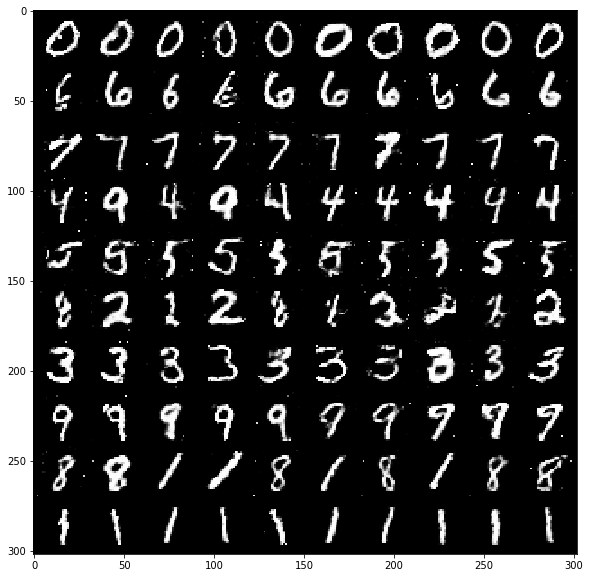

[Epoch 378/500] [Batch 599/600] [D loss: 5.736429] [G loss: 10.828779] [C loss 1: 0.035857] [C loss 2: 0.000251] 	 Time Interv: 25.528879


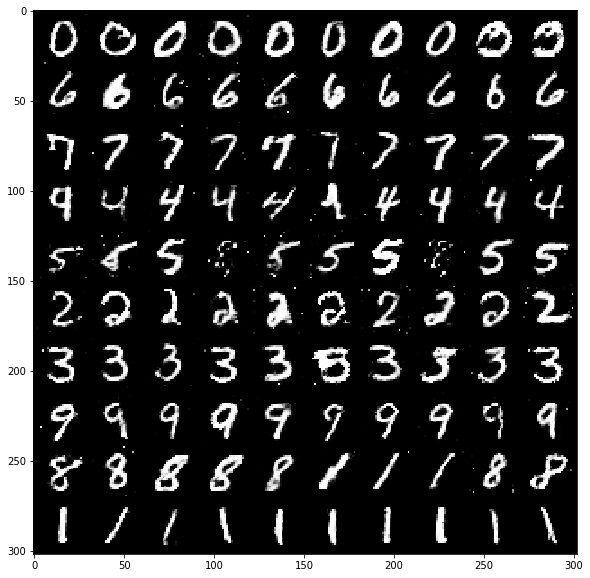

[Epoch 380/500] [Batch 599/600] [D loss: 5.776510] [G loss: 10.810978] [C loss 1: 0.030178] [C loss 2: 0.000375] 	 Time Interv: 24.980985


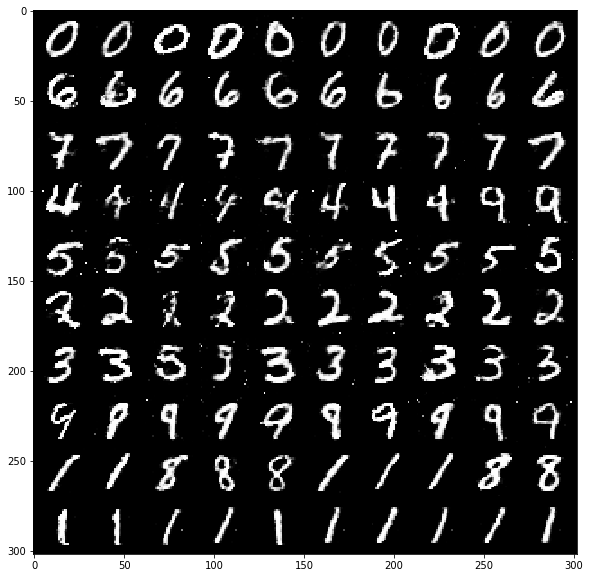

[Epoch 382/500] [Batch 599/600] [D loss: 5.808253] [G loss: 10.728087] [C loss 1: 0.031850] [C loss 2: 0.000283] 	 Time Interv: 24.755814


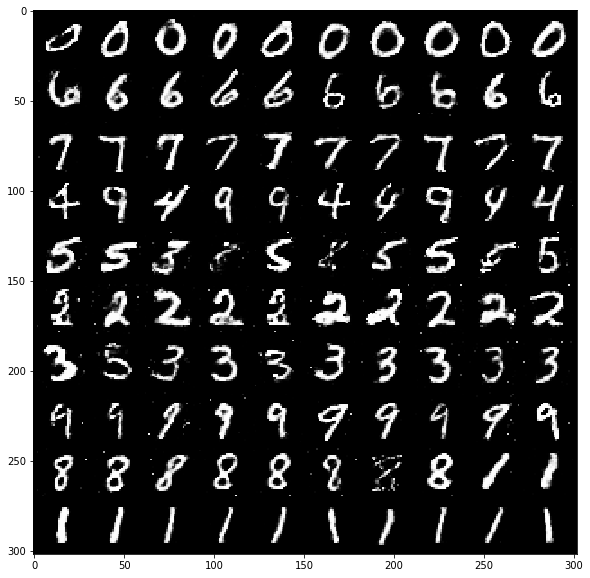

[Epoch 384/500] [Batch 599/600] [D loss: 5.756139] [G loss: 10.787840] [C loss 1: 0.034038] [C loss 2: 0.000251] 	 Time Interv: 25.004839


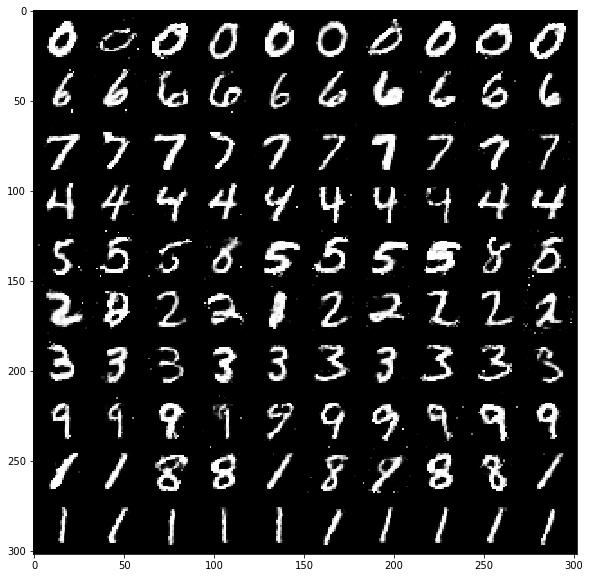

[Epoch 386/500] [Batch 599/600] [D loss: 5.830218] [G loss: 10.892675] [C loss 1: 0.035768] [C loss 2: 0.000371] 	 Time Interv: 24.651034


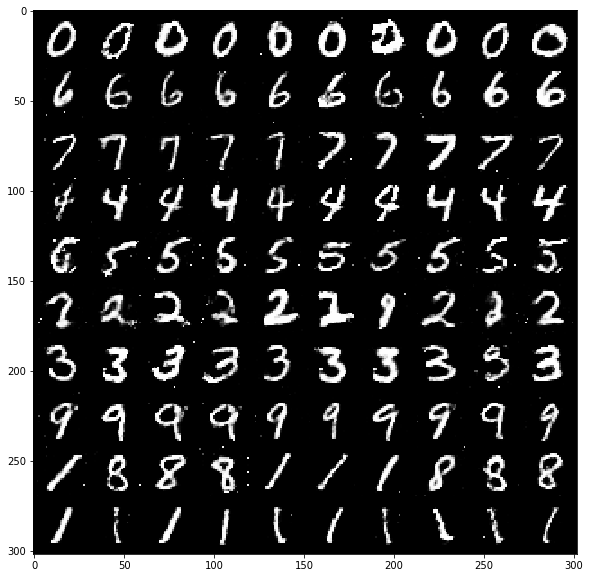

[Epoch 388/500] [Batch 599/600] [D loss: 5.746871] [G loss: 10.939030] [C loss 1: 0.033337] [C loss 2: 0.000380] 	 Time Interv: 25.885589


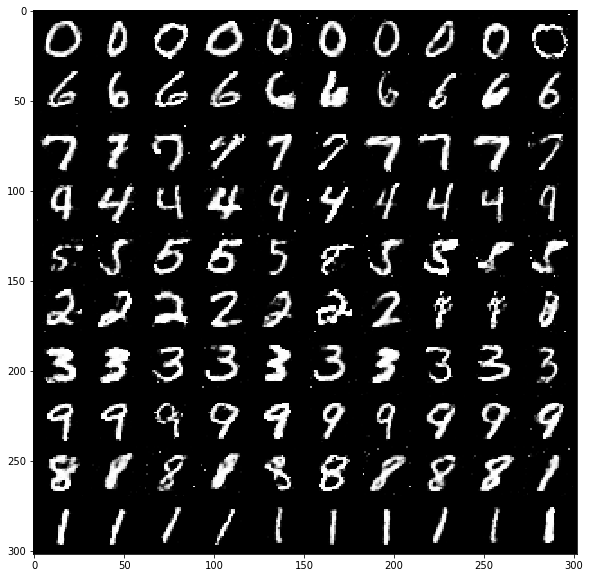

[Epoch 390/500] [Batch 599/600] [D loss: 5.707375] [G loss: 10.982985] [C loss 1: 0.033634] [C loss 2: 0.000258] 	 Time Interv: 20.540991


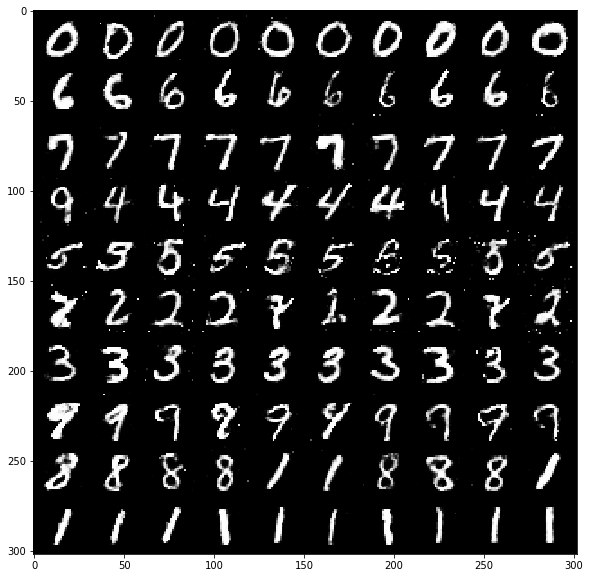

[Epoch 392/500] [Batch 599/600] [D loss: 5.711064] [G loss: 10.952371] [C loss 1: 0.040764] [C loss 2: 0.000360] 	 Time Interv: 20.378835


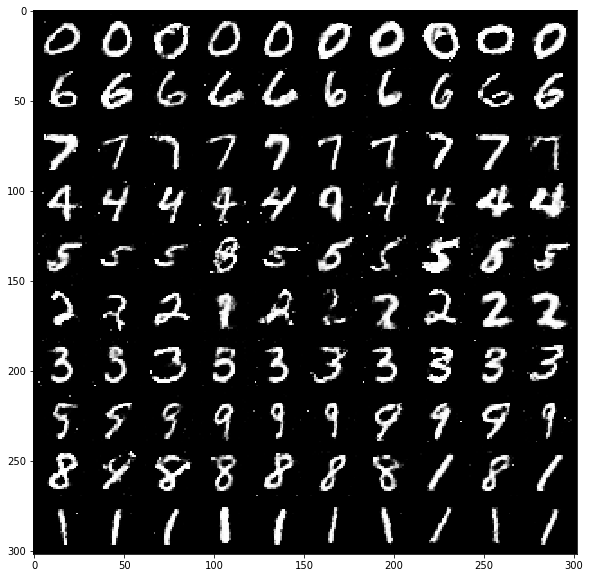

[Epoch 394/500] [Batch 599/600] [D loss: 5.734285] [G loss: 10.953014] [C loss 1: 0.038577] [C loss 2: 0.000392] 	 Time Interv: 20.377979


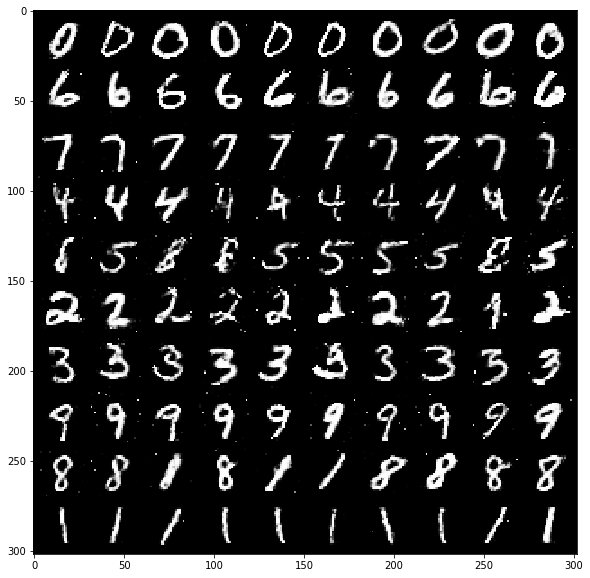

[Epoch 396/500] [Batch 599/600] [D loss: 5.703809] [G loss: 11.009101] [C loss 1: 0.035479] [C loss 2: 0.000532] 	 Time Interv: 20.565295


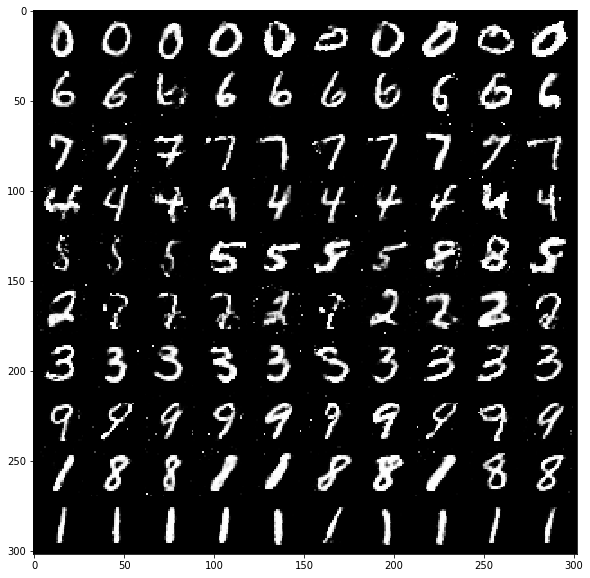

[Epoch 398/500] [Batch 599/600] [D loss: 5.730988] [G loss: 10.911915] [C loss 1: 0.032858] [C loss 2: 0.000408] 	 Time Interv: 20.522082


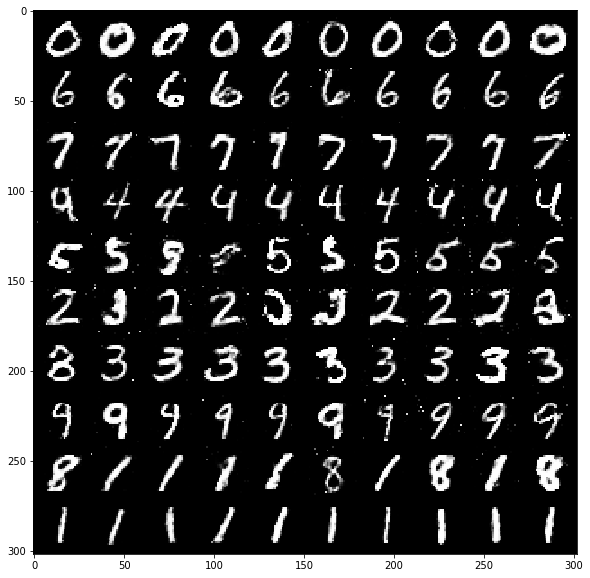

[Epoch 400/500] [Batch 599/600] [D loss: 5.699730] [G loss: 11.026292] [C loss 1: 0.035594] [C loss 2: 0.000341] 	 Time Interv: 20.187695


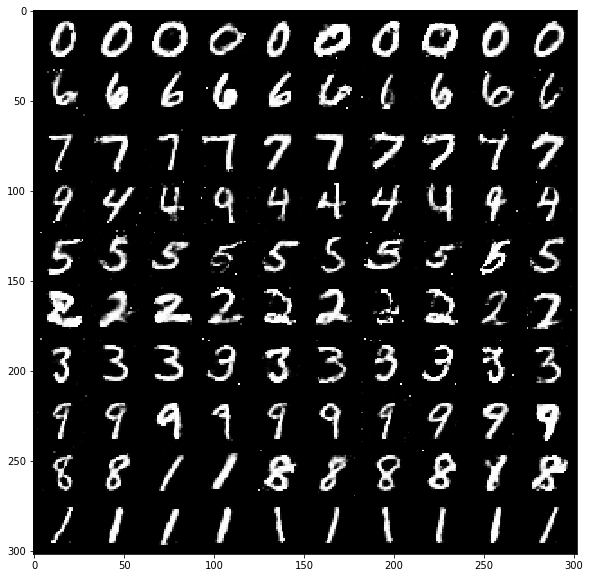

[Epoch 402/500] [Batch 599/600] [D loss: 5.709409] [G loss: 11.060946] [C loss 1: 0.038282] [C loss 2: 0.000349] 	 Time Interv: 20.256032


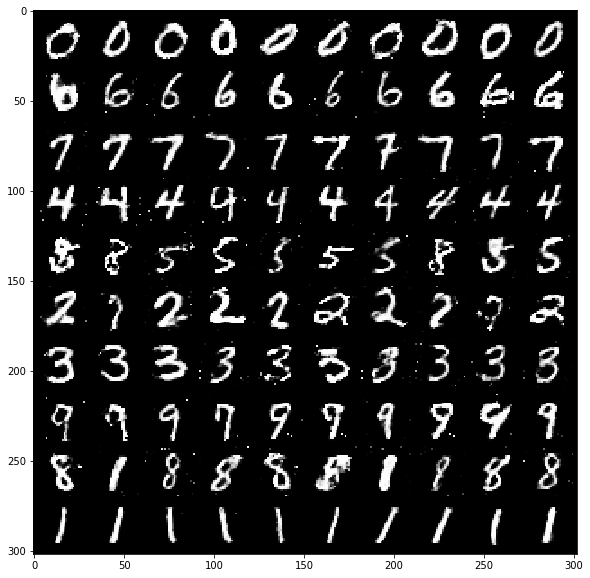

[Epoch 404/500] [Batch 599/600] [D loss: 5.777032] [G loss: 10.877018] [C loss 1: 0.032577] [C loss 2: 0.000319] 	 Time Interv: 20.327878


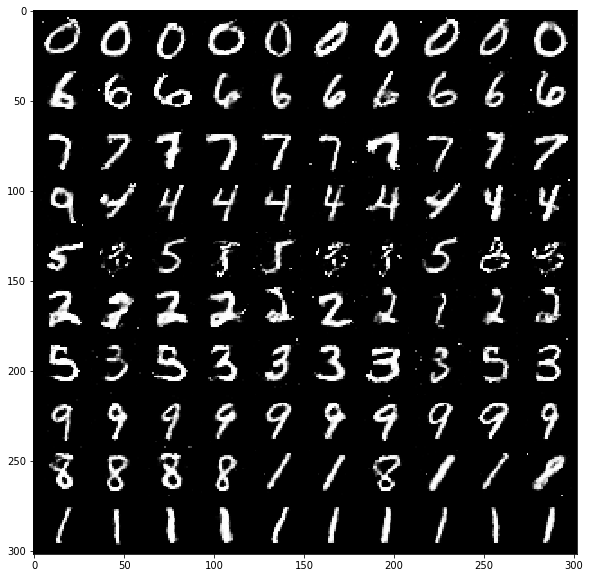

[Epoch 406/500] [Batch 599/600] [D loss: 5.739247] [G loss: 10.959142] [C loss 1: 0.032398] [C loss 2: 0.000279] 	 Time Interv: 19.900572


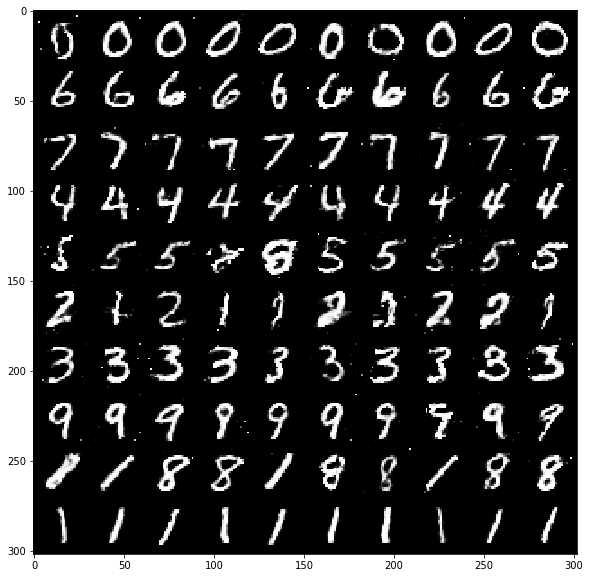

[Epoch 408/500] [Batch 599/600] [D loss: 5.718420] [G loss: 11.051873] [C loss 1: 0.037240] [C loss 2: 0.000612] 	 Time Interv: 19.963497


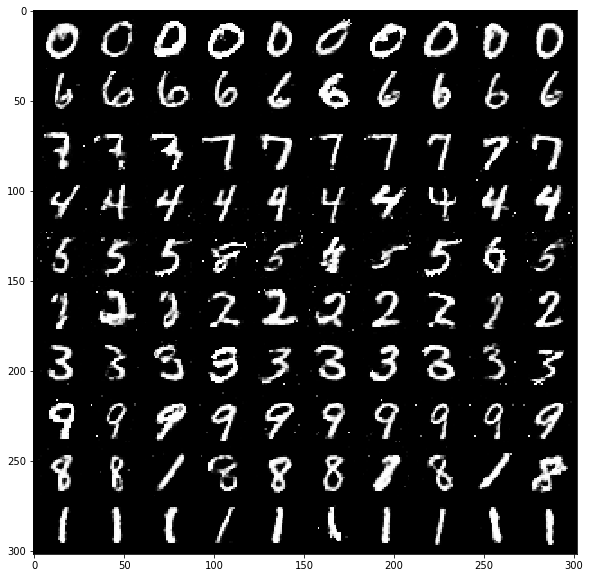

[Epoch 410/500] [Batch 599/600] [D loss: 5.710367] [G loss: 11.018034] [C loss 1: 0.039279] [C loss 2: 0.000423] 	 Time Interv: 19.960177


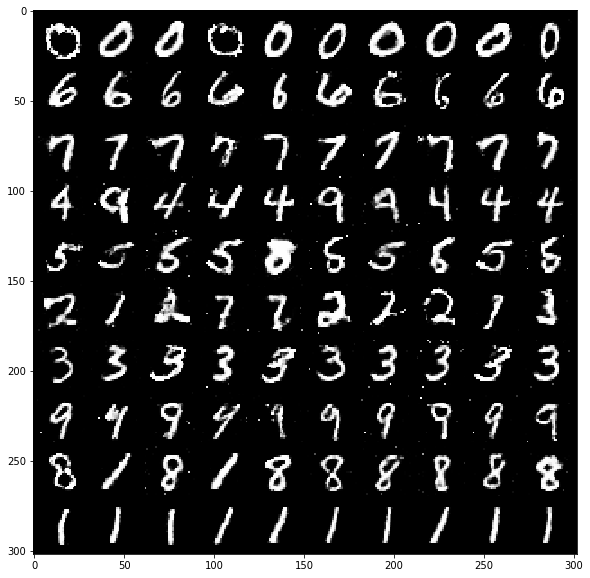

[Epoch 412/500] [Batch 599/600] [D loss: 5.728644] [G loss: 10.999491] [C loss 1: 0.035115] [C loss 2: 0.000241] 	 Time Interv: 19.920748


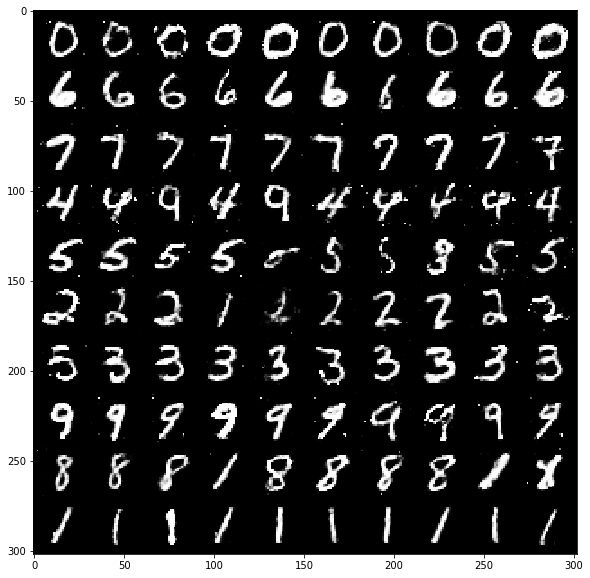

[Epoch 414/500] [Batch 599/600] [D loss: 5.702433] [G loss: 11.062296] [C loss 1: 0.040363] [C loss 2: 0.000323] 	 Time Interv: 19.981436


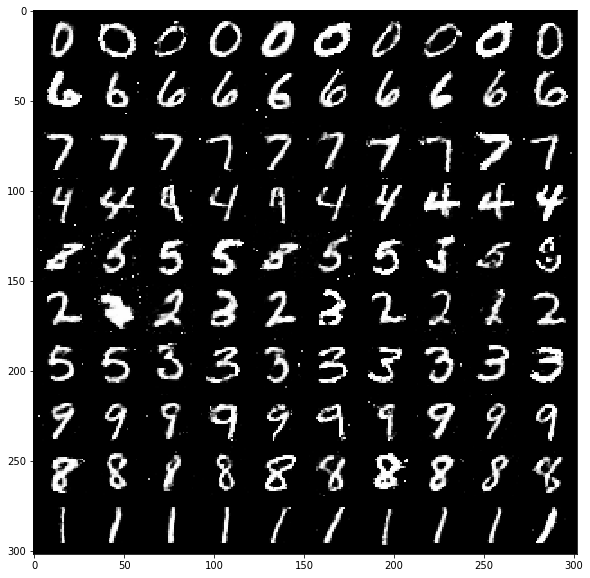

[Epoch 416/500] [Batch 599/600] [D loss: 5.773568] [G loss: 10.972708] [C loss 1: 0.033206] [C loss 2: 0.000226] 	 Time Interv: 19.969369


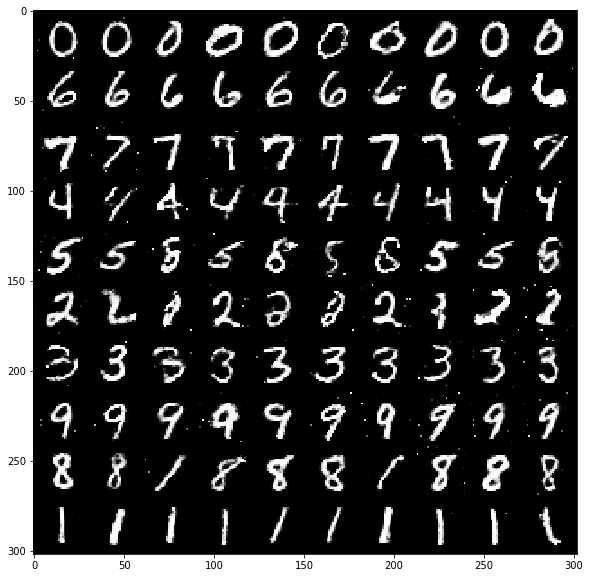

[Epoch 418/500] [Batch 599/600] [D loss: 5.732955] [G loss: 11.048705] [C loss 1: 0.039945] [C loss 2: 0.000461] 	 Time Interv: 19.949553


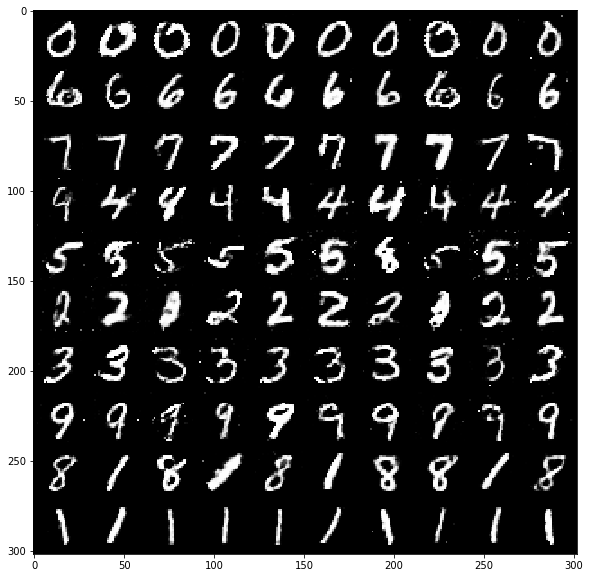

[Epoch 420/500] [Batch 599/600] [D loss: 5.794202] [G loss: 10.986544] [C loss 1: 0.033118] [C loss 2: 0.000379] 	 Time Interv: 20.001438


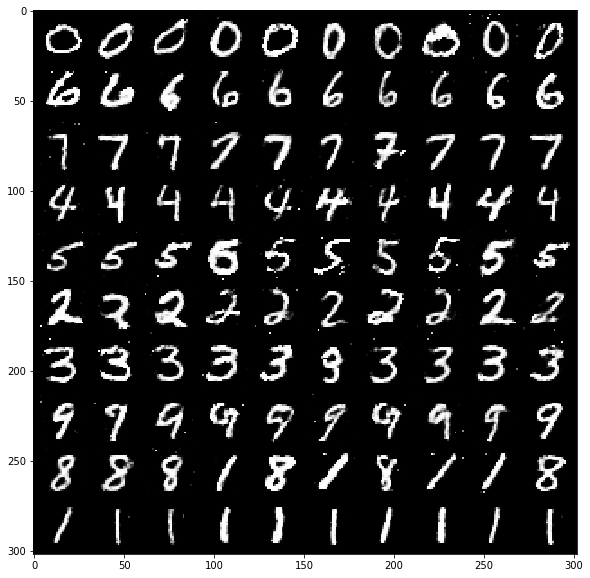

[Epoch 422/500] [Batch 599/600] [D loss: 5.770433] [G loss: 10.971938] [C loss 1: 0.036663] [C loss 2: 0.000244] 	 Time Interv: 20.173634


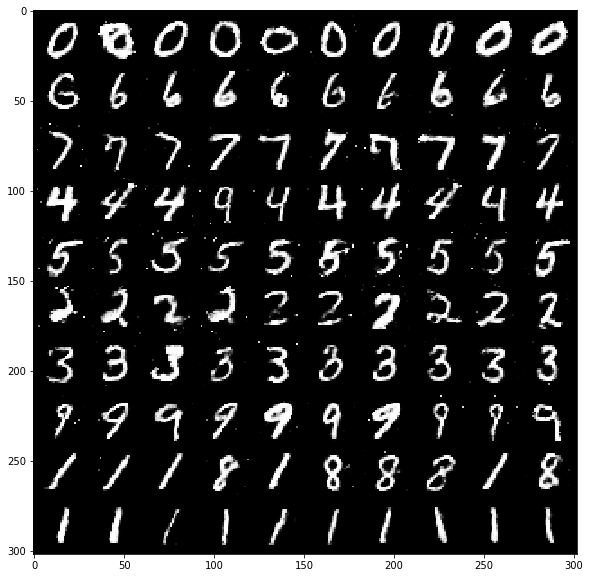

[Epoch 424/500] [Batch 599/600] [D loss: 5.737236] [G loss: 11.011676] [C loss 1: 0.036904] [C loss 2: 0.000236] 	 Time Interv: 20.215768


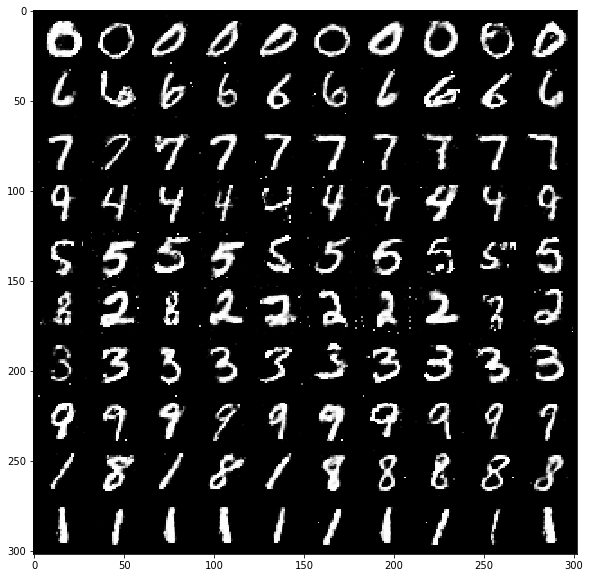

[Epoch 426/500] [Batch 599/600] [D loss: 5.724753] [G loss: 10.994040] [C loss 1: 0.041074] [C loss 2: 0.000316] 	 Time Interv: 20.349480


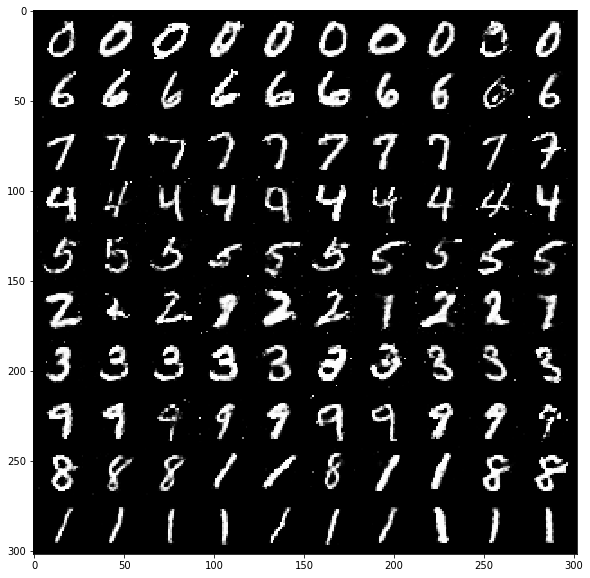

[Epoch 428/500] [Batch 599/600] [D loss: 5.698746] [G loss: 11.144318] [C loss 1: 0.033896] [C loss 2: 0.000330] 	 Time Interv: 20.425981


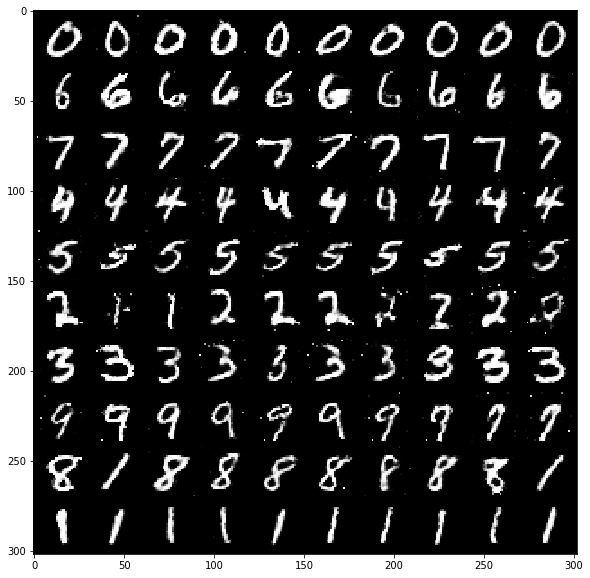

[Epoch 430/500] [Batch 599/600] [D loss: 5.654613] [G loss: 11.167065] [C loss 1: 0.043689] [C loss 2: 0.000586] 	 Time Interv: 20.008689


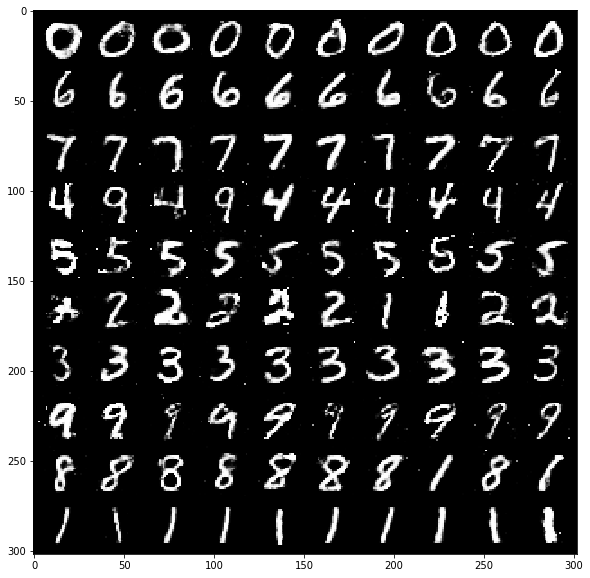

[Epoch 432/500] [Batch 599/600] [D loss: 5.649247] [G loss: 11.179628] [C loss 1: 0.038558] [C loss 2: 0.000343] 	 Time Interv: 19.966462


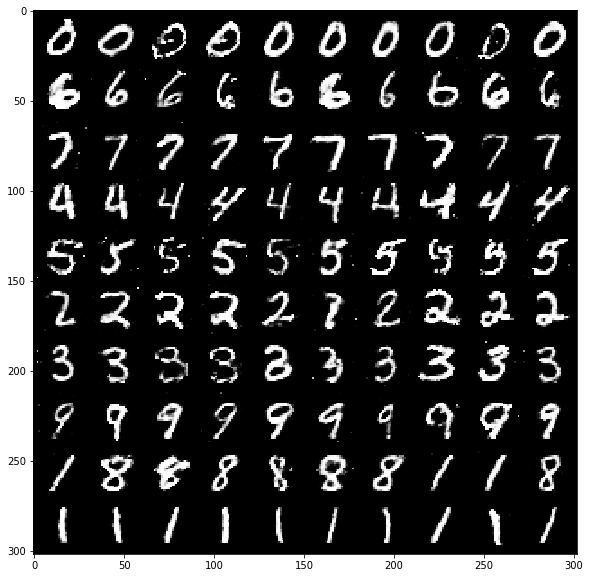

[Epoch 434/500] [Batch 599/600] [D loss: 5.671565] [G loss: 11.158376] [C loss 1: 0.037480] [C loss 2: 0.000398] 	 Time Interv: 20.289712


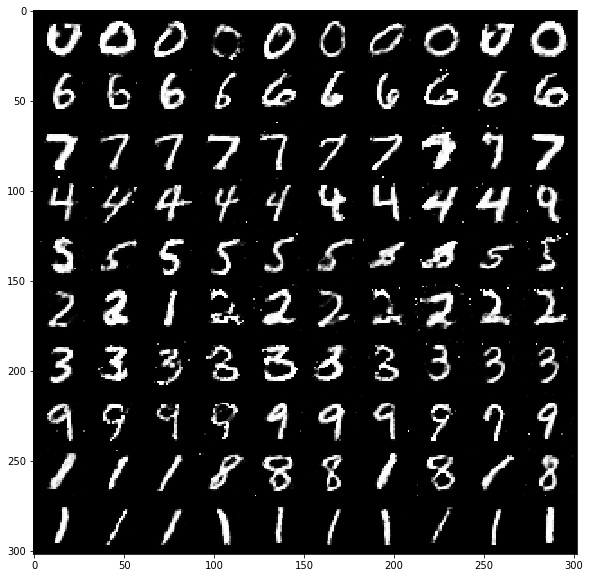

[Epoch 436/500] [Batch 599/600] [D loss: 5.678673] [G loss: 11.136231] [C loss 1: 0.038110] [C loss 2: 0.000505] 	 Time Interv: 20.393116


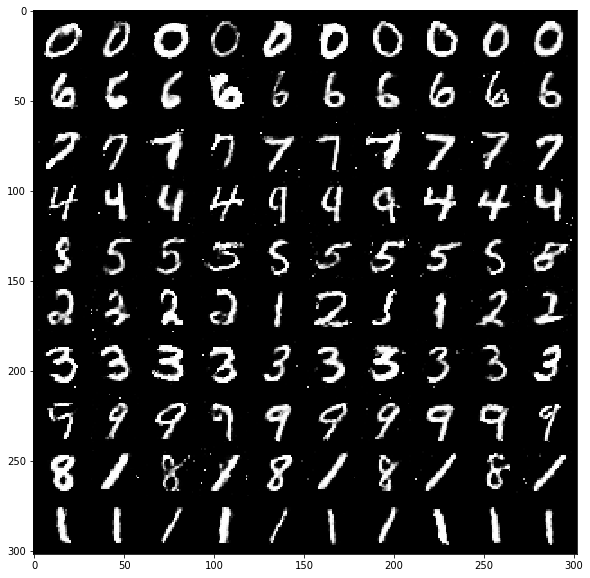

[Epoch 438/500] [Batch 599/600] [D loss: 5.701750] [G loss: 11.101823] [C loss 1: 0.039206] [C loss 2: 0.000462] 	 Time Interv: 20.350498


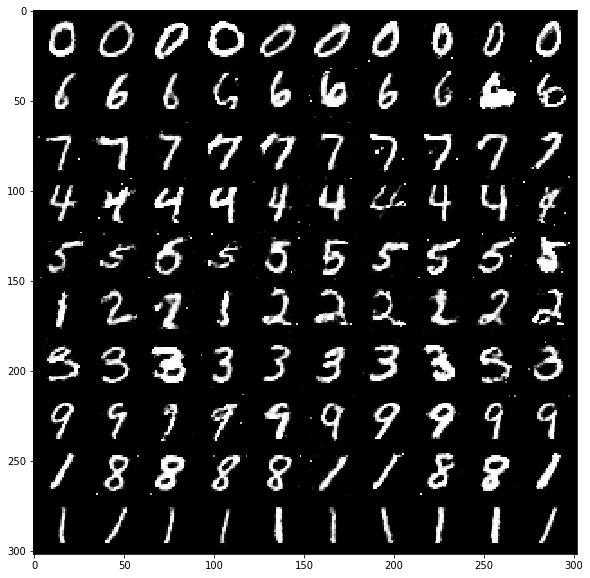

[Epoch 440/500] [Batch 599/600] [D loss: 5.722630] [G loss: 11.111224] [C loss 1: 0.036964] [C loss 2: 0.000309] 	 Time Interv: 20.099566


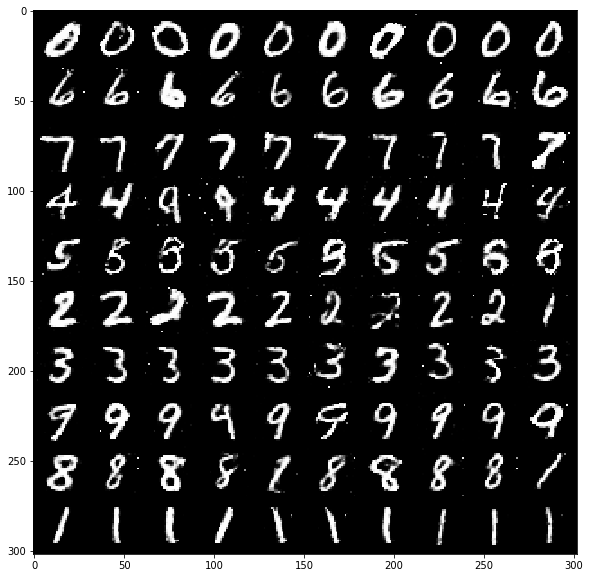

[Epoch 442/500] [Batch 599/600] [D loss: 5.730106] [G loss: 11.028773] [C loss 1: 0.035432] [C loss 2: 0.000318] 	 Time Interv: 20.474552


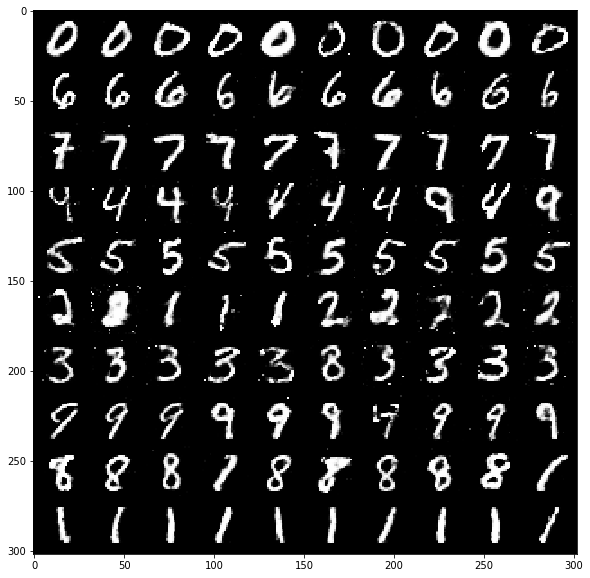

[Epoch 444/500] [Batch 599/600] [D loss: 5.775077] [G loss: 10.920353] [C loss 1: 0.033576] [C loss 2: 0.000437] 	 Time Interv: 20.135776


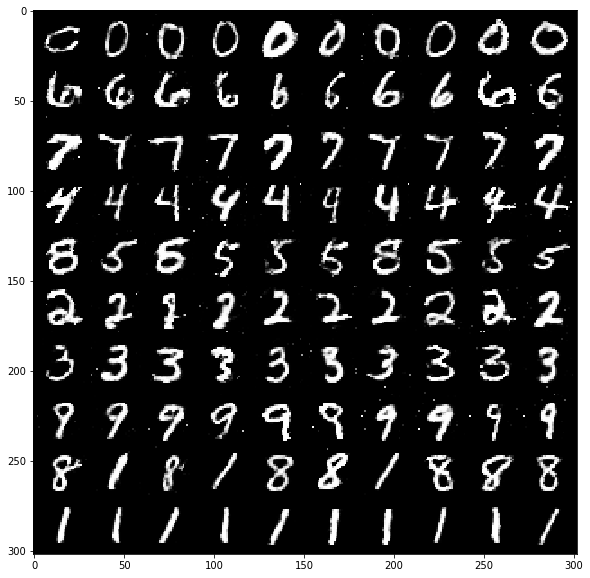

[Epoch 446/500] [Batch 599/600] [D loss: 5.739226] [G loss: 11.084082] [C loss 1: 0.032634] [C loss 2: 0.000269] 	 Time Interv: 20.053584


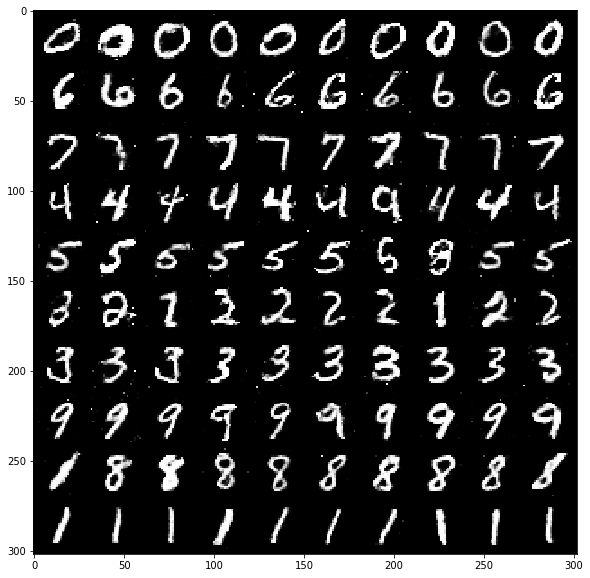

[Epoch 448/500] [Batch 599/600] [D loss: 5.704197] [G loss: 11.105085] [C loss 1: 0.037696] [C loss 2: 0.000266] 	 Time Interv: 20.010453


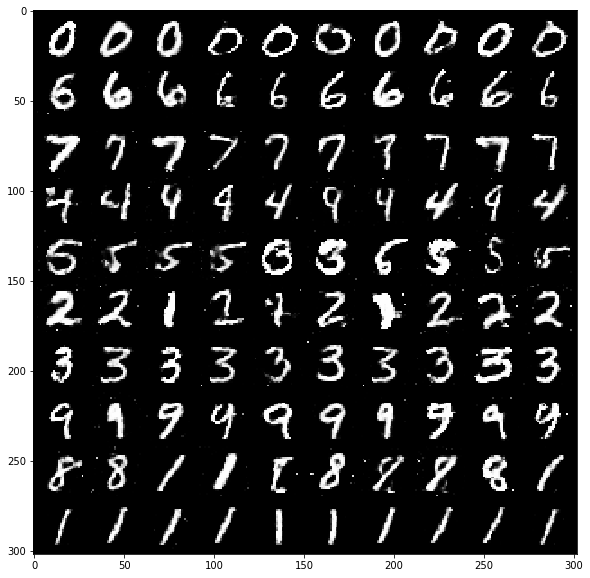

[Epoch 450/500] [Batch 599/600] [D loss: 5.716268] [G loss: 11.140322] [C loss 1: 0.039979] [C loss 2: 0.000309] 	 Time Interv: 19.997208


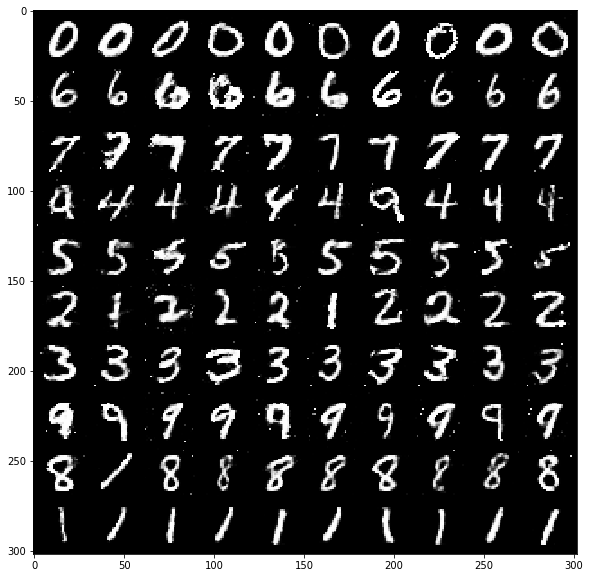

[Epoch 452/500] [Batch 599/600] [D loss: 5.609106] [G loss: 11.380487] [C loss 1: 0.039038] [C loss 2: 0.000230] 	 Time Interv: 19.934374


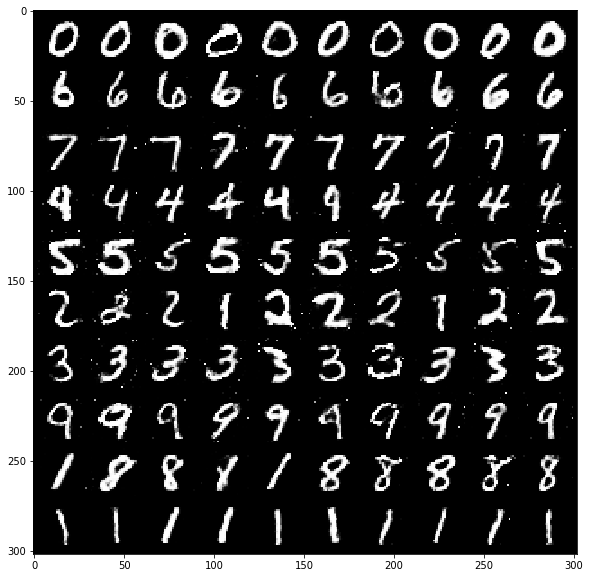

[Epoch 454/500] [Batch 599/600] [D loss: 5.697753] [G loss: 11.171157] [C loss 1: 0.029526] [C loss 2: 0.000226] 	 Time Interv: 20.014686


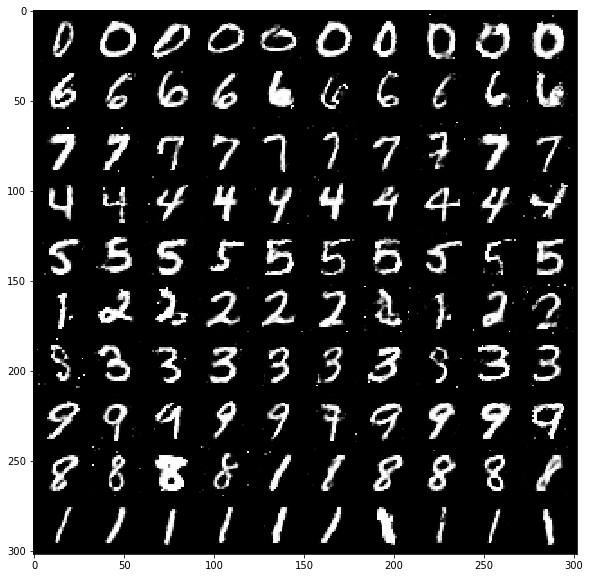

[Epoch 456/500] [Batch 599/600] [D loss: 5.668223] [G loss: 11.192892] [C loss 1: 0.040316] [C loss 2: 0.000384] 	 Time Interv: 19.949597


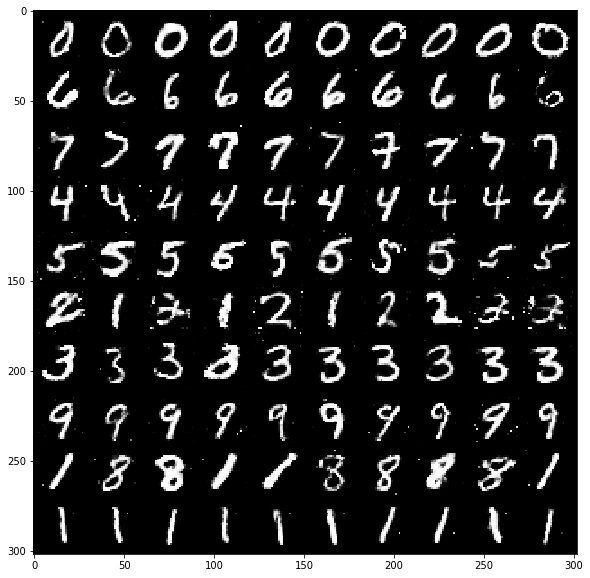

[Epoch 458/500] [Batch 599/600] [D loss: 5.631261] [G loss: 11.243984] [C loss 1: 0.042896] [C loss 2: 0.000687] 	 Time Interv: 19.942857


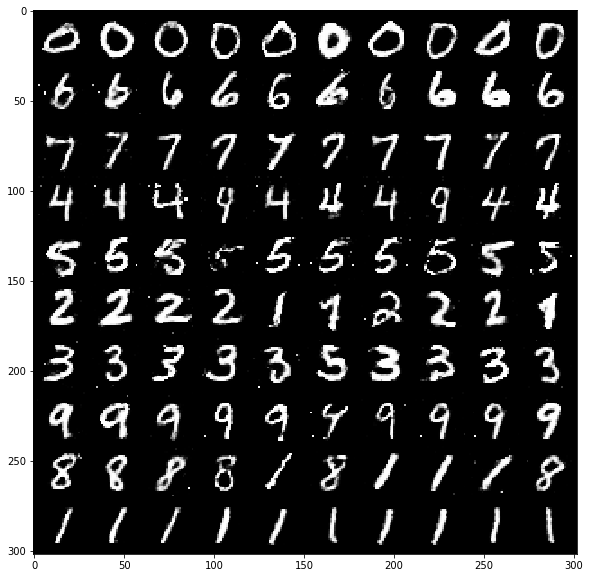

[Epoch 460/500] [Batch 599/600] [D loss: 5.670703] [G loss: 11.201333] [C loss 1: 0.041487] [C loss 2: 0.000353] 	 Time Interv: 19.986751


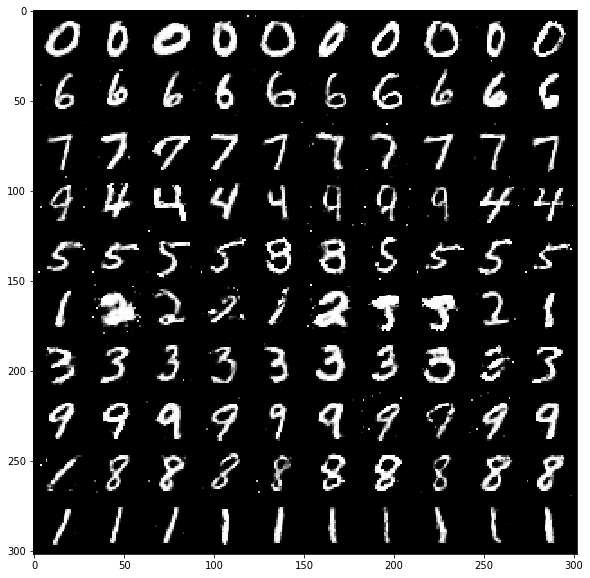

[Epoch 462/500] [Batch 599/600] [D loss: 5.646679] [G loss: 11.220668] [C loss 1: 0.038581] [C loss 2: 0.000223] 	 Time Interv: 19.959156


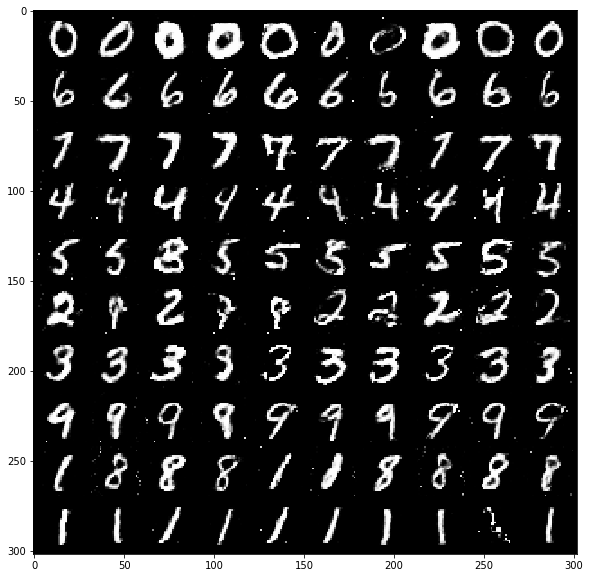

[Epoch 464/500] [Batch 599/600] [D loss: 5.683227] [G loss: 11.301045] [C loss 1: 0.040883] [C loss 2: 0.000256] 	 Time Interv: 20.114446


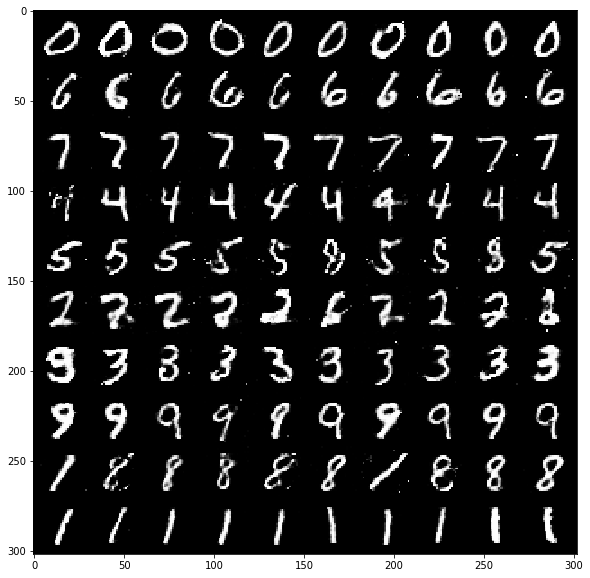

[Epoch 466/500] [Batch 599/600] [D loss: 5.649015] [G loss: 11.290102] [C loss 1: 0.037293] [C loss 2: 0.000671] 	 Time Interv: 20.170988


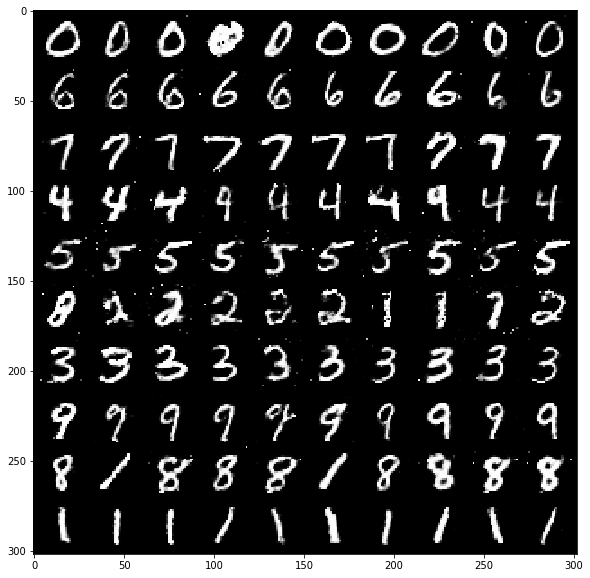

[Epoch 468/500] [Batch 599/600] [D loss: 5.666138] [G loss: 11.238258] [C loss 1: 0.042062] [C loss 2: 0.000401] 	 Time Interv: 20.298684


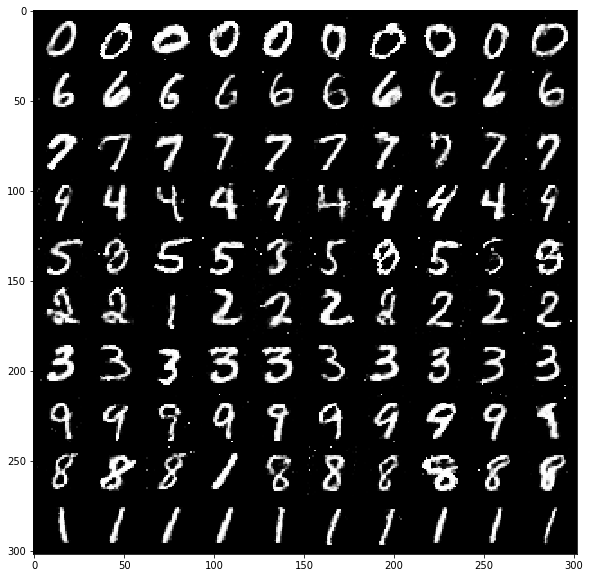

[Epoch 470/500] [Batch 599/600] [D loss: 5.601285] [G loss: 11.360443] [C loss 1: 0.040679] [C loss 2: 0.000279] 	 Time Interv: 20.290170


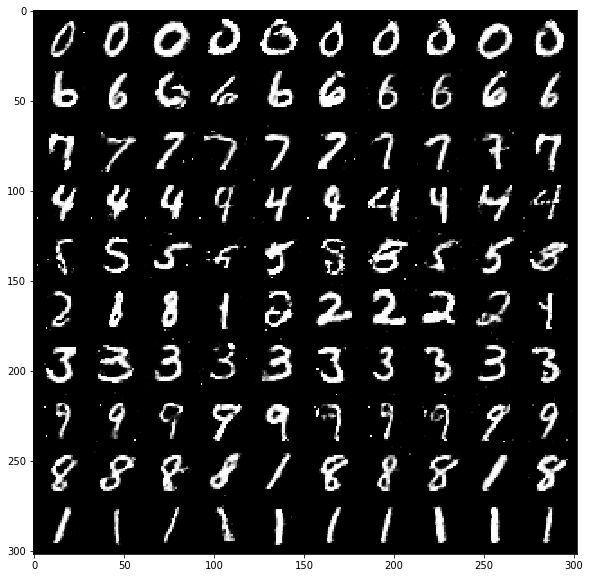

[Epoch 472/500] [Batch 599/600] [D loss: 5.655981] [G loss: 11.320796] [C loss 1: 0.041748] [C loss 2: 0.000344] 	 Time Interv: 19.953167


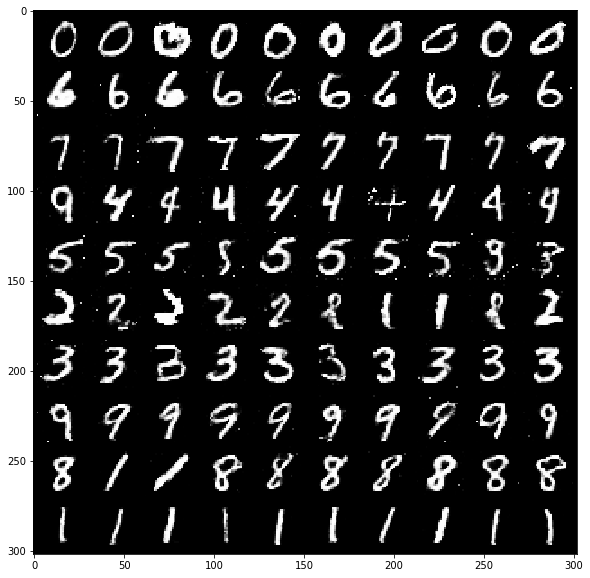

[Epoch 474/500] [Batch 599/600] [D loss: 5.657299] [G loss: 11.281765] [C loss 1: 0.039531] [C loss 2: 0.000515] 	 Time Interv: 19.997001


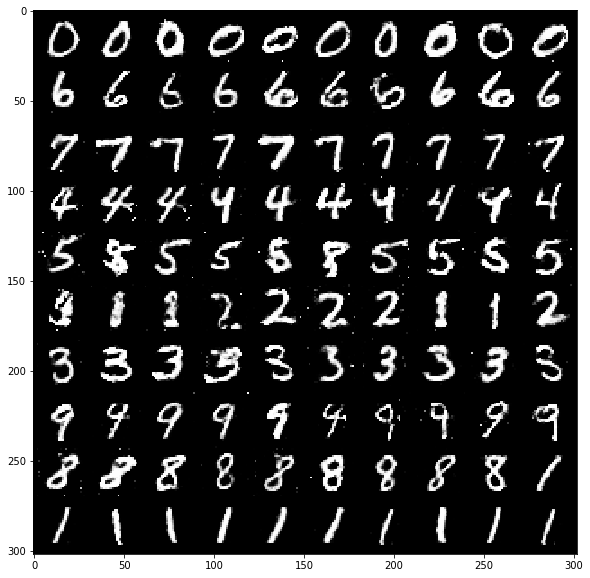

[Epoch 476/500] [Batch 599/600] [D loss: 5.609851] [G loss: 11.325263] [C loss 1: 0.038981] [C loss 2: 0.000343] 	 Time Interv: 19.935552


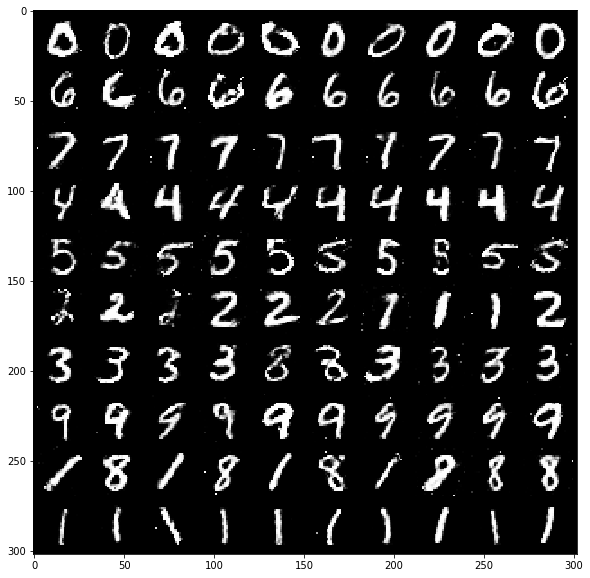

[Epoch 478/500] [Batch 599/600] [D loss: 5.667879] [G loss: 11.247506] [C loss 1: 0.038601] [C loss 2: 0.000519] 	 Time Interv: 19.932936


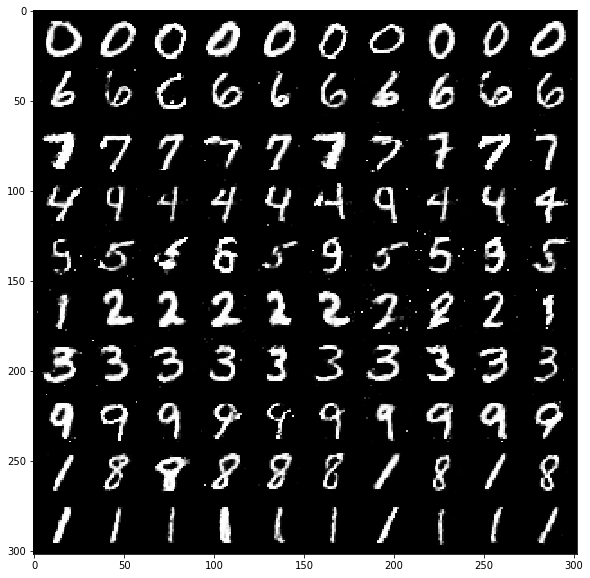

[Epoch 480/500] [Batch 599/600] [D loss: 5.564799] [G loss: 11.441770] [C loss 1: 0.045086] [C loss 2: 0.000371] 	 Time Interv: 20.030286


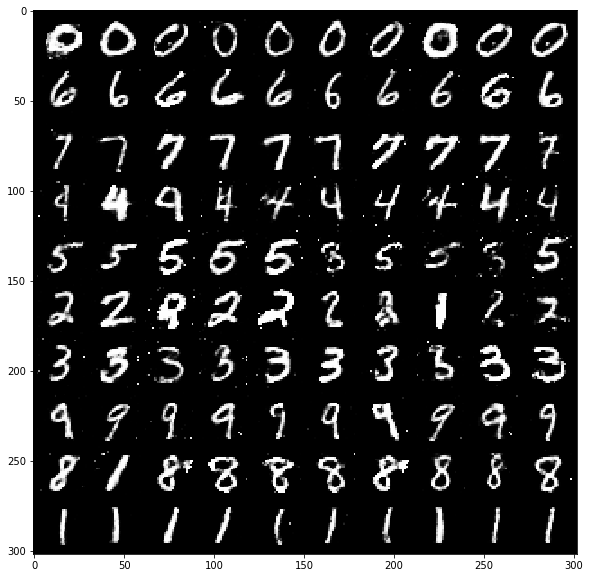

[Epoch 482/500] [Batch 599/600] [D loss: 5.605699] [G loss: 11.431995] [C loss 1: 0.040032] [C loss 2: 0.000429] 	 Time Interv: 20.038903


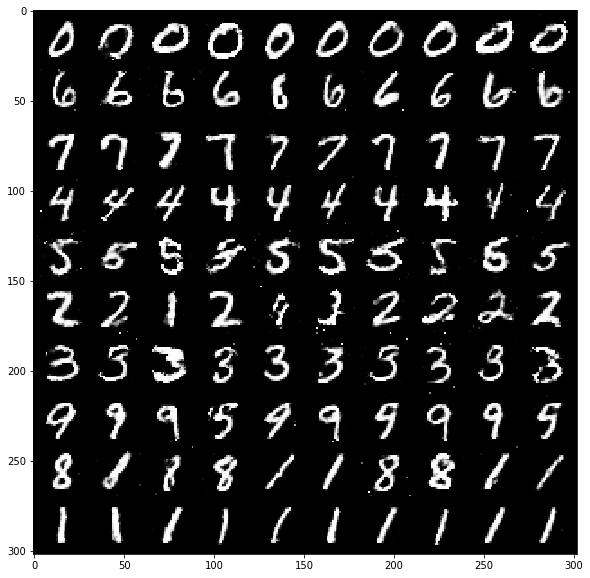

[Epoch 484/500] [Batch 599/600] [D loss: 5.615995] [G loss: 11.324029] [C loss 1: 0.043492] [C loss 2: 0.000627] 	 Time Interv: 19.960157


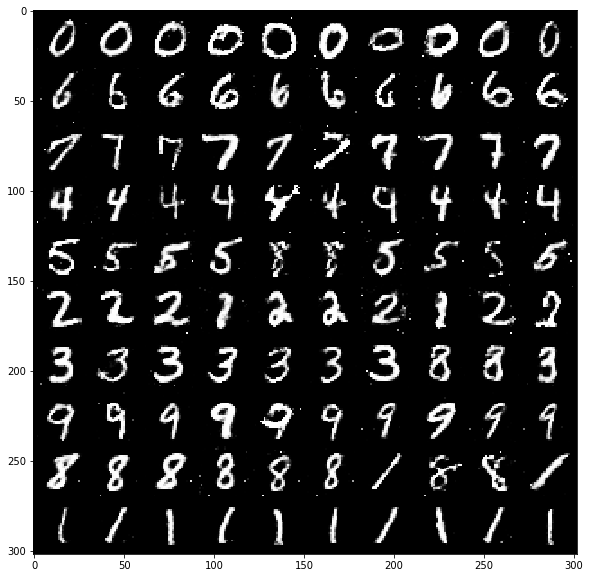

[Epoch 486/500] [Batch 599/600] [D loss: 5.616617] [G loss: 11.336997] [C loss 1: 0.041731] [C loss 2: 0.000249] 	 Time Interv: 20.171606


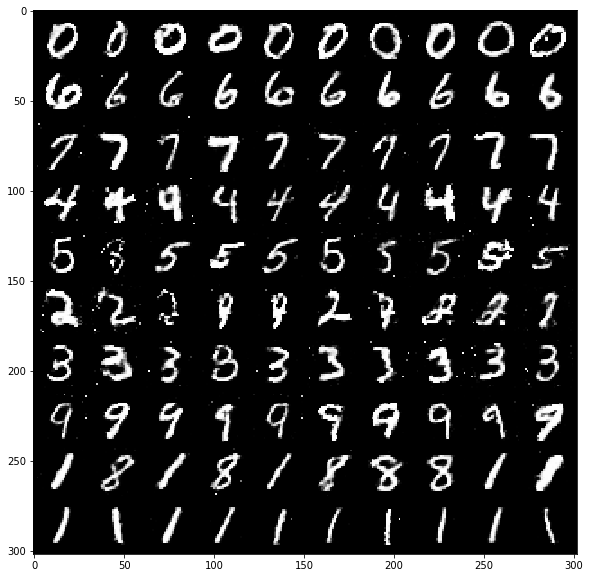

[Epoch 488/500] [Batch 599/600] [D loss: 5.611559] [G loss: 11.363040] [C loss 1: 0.041134] [C loss 2: 0.000418] 	 Time Interv: 20.153553


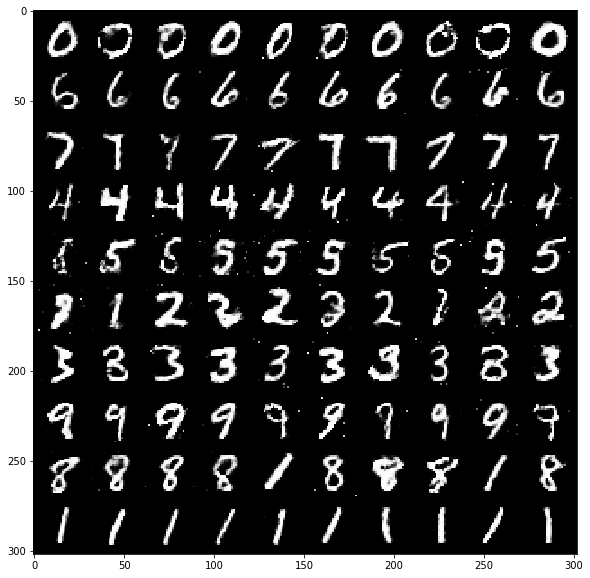

[Epoch 490/500] [Batch 599/600] [D loss: 5.615706] [G loss: 11.389470] [C loss 1: 0.044053] [C loss 2: 0.000437] 	 Time Interv: 20.183799


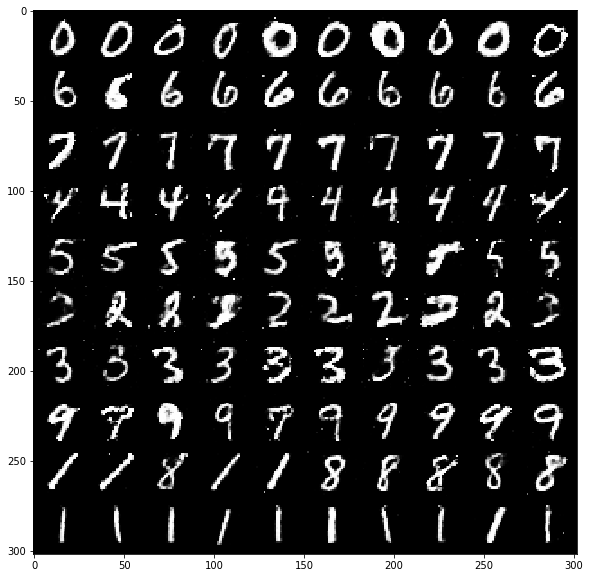

[Epoch 492/500] [Batch 599/600] [D loss: 5.591437] [G loss: 11.462113] [C loss 1: 0.039719] [C loss 2: 0.000381] 	 Time Interv: 20.406409


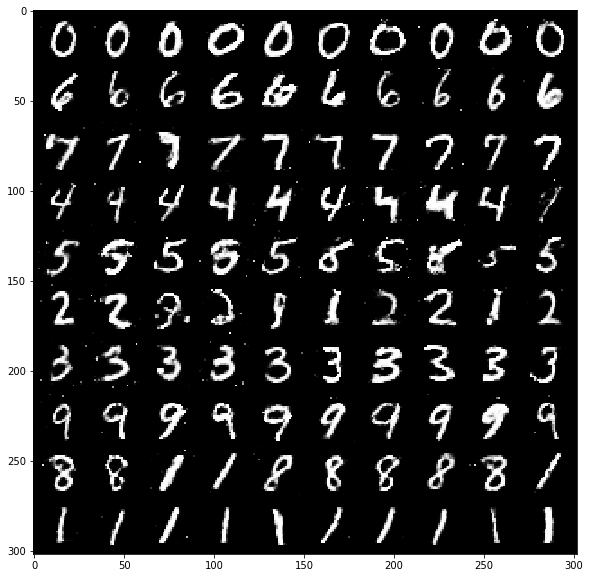

[Epoch 494/500] [Batch 599/600] [D loss: 5.629231] [G loss: 11.362880] [C loss 1: 0.040931] [C loss 2: 0.000263] 	 Time Interv: 19.924414


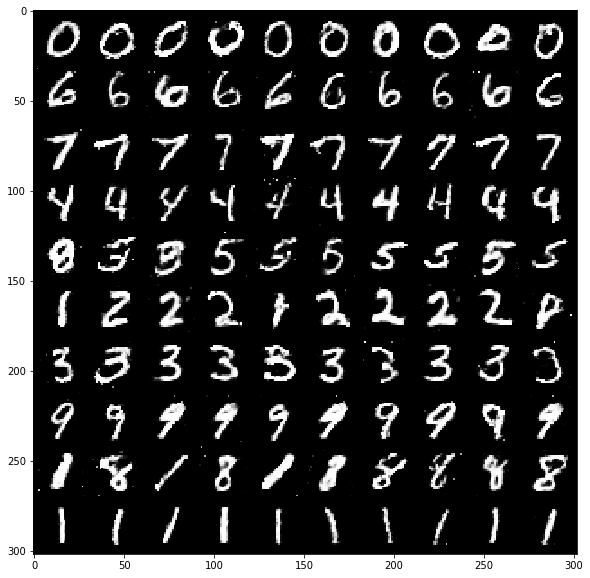

[Epoch 496/500] [Batch 599/600] [D loss: 5.586686] [G loss: 11.558266] [C loss 1: 0.040140] [C loss 2: 0.000481] 	 Time Interv: 19.960792


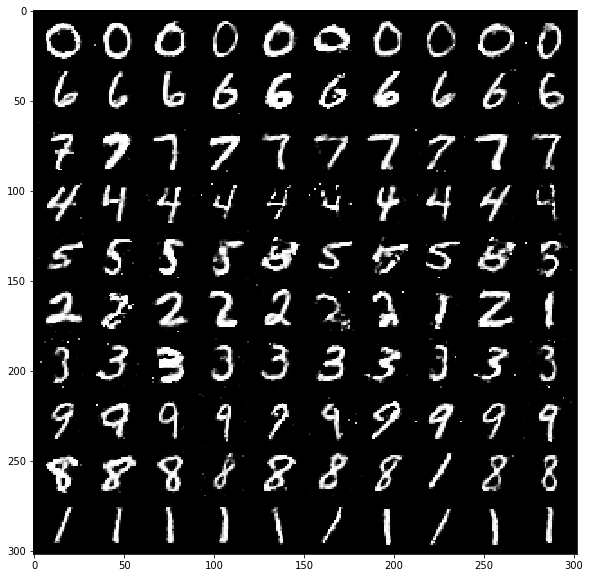

[Epoch 498/500] [Batch 599/600] [D loss: 5.576338] [G loss: 11.464032] [C loss 1: 0.044077] [C loss 2: 0.000473] 	 Time Interv: 19.991396


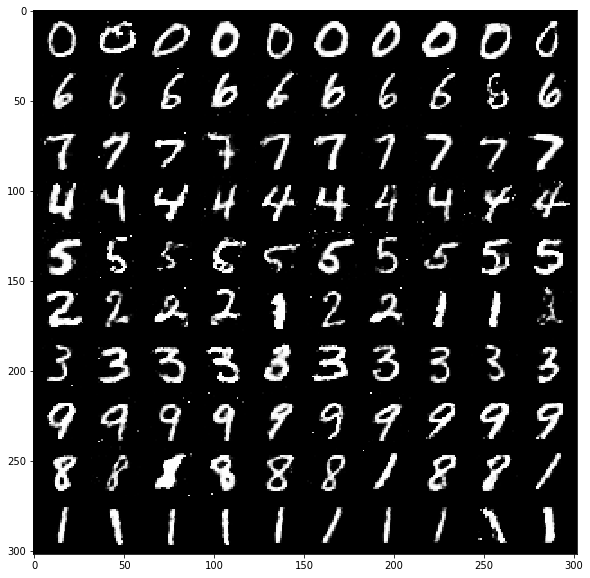

In [11]:
# ----------
#  Training
# ----------

#para cada época...
for epoch in range(range(opt.n_epochs)):

    start = time.time()
    epoch_start = 0
    
    #variáveis p/ acumular as perdas de todos os minibatches da época (para visualizacao)
    g_loss_epoch = 0
    d_loss_epoch = 0
    c_loss_1_epoch = 0
    c_loss_2_epoch = 0
    
    #numero de batches 
    num_batches = len(dataloader)
    
    for i, (imgs, _) in enumerate(dataloader):
        
        # Adversarial ground truths
        valid = Variable(Tensor(imgs.size(0), 1).fill_(1.0), requires_grad=False)
        fake = Variable(Tensor(imgs.size(0), 1).fill_(0.0), requires_grad=False)

        # Configure input
        real_imgs = Variable(imgs.type(Tensor))

        # -----------------------------------------------------
        #  Train Generator (CHAMAMOS ESSA ETAPA DE ETAPA 1)
        # -----------------------------------------------------
        
        optimizer_G.zero_grad()

        # amostra variavel latente Z compartilhada para os geradores
        z = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], opt.latent_dim))))
        
        g_loss = 0 #perda adversarial de discrimincao a ser aplica no gerador
        c_loss_1 = 0 #perda de classificacao a ser aplicada no gerador
        
        #aqui iteramos sobre cada um dos geradores
        for k in range(opt.n_paths_G):

            # gera batch de imagens com o gerador k
            gen_imgs = generator.paths[k](z)

            # lembrando: validity e classifier são as respostas do discriminador e do classificador
            validity, classifier = discriminator(gen_imgs)
            
            #acumula a perda adversarial (binary cross entropy) 
            g_loss += adversarial_loss(validity, valid)

            #target recebe o índice do gerador que gerou as imagens  
            target = Variable(Tensor(imgs.size(0)).fill_(k), requires_grad=False)
            target = target.type(torch.cuda.LongTensor)
            
            #acumula a perda de classificação calculada com nll_loss (basicamente, entropia cruzada), 
            #usando a saída do classificador e a resposta correta com o índice do gerador 
            #lembrando: opt.classifier_para é só uma constante multiplicativa da perda
            c_loss_1 += F.nll_loss(classifier, target)*opt.classifier_para
        
        #acumula as perdas p/ medir depois a perda total numa época inteira
        g_loss_epoch += g_loss
        c_loss_1_epoch += c_loss_1       
        
        #soma ambas as perdas na variável g_loss
        g_loss = g_loss + c_loss_1
        
        #calcula os gradientes
        g_loss.backward()
        
        #aplica os gradientes APENAS no gerador
        optimizer_G.step()
        
        # ------------------------------------------------------------------------
        #  Train Discriminator and Classifier (CHAMAMOS ESSA ETAPA DE ETAPA 2)
        # ------------------------------------------------------------------------

        optimizer_D.zero_grad()

        d_loss = 0 #perda adversarial de discrimincao a ser aplica no discriminador
        c_loss_2 = 0 #perda de classificacao a ser aplicada no classificador
        
        #perda do discriminador com imagens reais
        validity, classifier = discriminator(real_imgs)
        real_loss = adversarial_loss(validity, valid)
        
        temp = [] #variavel para guardar imagens pra plot
        
        #novamente iteramos sobre cada um dos geradores
        for k in range(opt.n_paths_G):

            # gera batch de imagens com o gerador k
            gen_imgs = generator.paths[k](z).view(imgs.shape[0], *img_shape)
            temp.append(gen_imgs[0:10, :])

            #novamente medimos as saídas do discriminador e do classificador 
            validity, classifier = discriminator(gen_imgs.detach())
            
            #perda do discriminador com imagens fake
            fake_loss = adversarial_loss(validity, fake)
            
            #soma as perdas fake e true
            d_loss += (real_loss + fake_loss) / 2

            #novamente calculamos a perda do classificador. observe que é calculada da exata mesma forma ...
            #... que anteriormente, só que somente depois do gerador já ter seus pesos atualizados na ETAPA 1
            #lembrando: opt.classifier_para é só uma constante multiplicativa da perda
            target = Variable(Tensor(imgs.size(0)).fill_(k), requires_grad=False)
            target = target.type(torch.cuda.LongTensor)
            c_loss_2 += F.nll_loss(classifier, target)*opt.classifier_para
        
        #imagens pra plot
        plot_imgs = torch.cat(temp, dim=0)
        
        #novamente, acumulamos as perdas pra visualizar o total da epoca
        d_loss_epoch += d_loss
        c_loss_2_epoch += c_loss_2
        
        #somamos ambas as perdas na mesma variável 
        d_loss = d_loss + c_loss_2
        #aplicamos conjuntamente os gradientes nas camadas do discriminador e do classificador
        d_loss.backward()
        optimizer_D.step()

    
    #print de informacoes do treinamento 
    interval = time.time() - start
    if epoch % 2 == 0:
        
        print ("[Epoch %d/%d] [Batch %d/%d] [D loss: %f] [G loss: %f] [C loss 1: %f] [C loss 2: %f] \t Time Interv: %f"
               % (epoch, opt.n_epochs, i, num_batches, d_loss_epoch.item()/num_batches, g_loss_epoch.item()/num_batches, 
                  c_loss_1_epoch.item()/num_batches, c_loss_2_epoch.item()/num_batches, interval))

        show(make_grid(plot_imgs[:opt.n_paths_G*10].cpu(), nrow=10, normalize=True))
        plt.show()
